In [1]:
# importing libraries
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import itertools as it
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import cross_val_score,train_test_split,cross_val_predict,cross_validate
from sklearn.model_selection import KFold,StratifiedKFold
from sklearn.tree import DecisionTreeRegressor,DecisionTreeClassifier
from sklearn.model_selection import GridSearchCV, ParameterGrid
from sklearn.ensemble import BaggingRegressor,BaggingClassifier,RandomForestRegressor,RandomForestClassifier
from sklearn.linear_model import LinearRegression,LogisticRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import roc_curve, precision_recall_curve, auc, make_scorer, recall_score, \
accuracy_score, precision_score, confusion_matrix, mean_squared_error, r2_score, mean_absolute_error
from sklearn import impute
import time as tm
from sklearn.linear_model import Ridge, RidgeCV, Lasso, LassoCV

import xgboost as xgb
from sklearn.model_selection import GridSearchCV, ParameterGrid, RandomizedSearchCV
from sklearn.preprocessing import StandardScaler 
import pandas as pd
import numpy as np
import statsmodels.formula.api as sm
import seaborn as sns
import matplotlib.pyplot as plt
import itertools

import warnings
warnings.filterwarnings("ignore")

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


## 1. Reading in Data 
(After Imputing Missing Values using KNN)

In [2]:
# reading in train data (10000 observations)
train = pd.read_csv('train_clean.csv')
train = train.drop(['Unnamed: 0'],axis=1)
train.head(3)

,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,D_43,D_44,...,D_131,D_133,R_28,D_139,D_140,D_141,D_143,D_144,D_145,target
0,0.938469,0.001733,0.008724,1.006838,0.009228,0.124035,0.008771,0.004709,0.039852,0.000630,...,0.005972,0.004345,0.001535,0.002427,0.003706,0.003818,0.000569,0.000610,0.002674,0.0
1,0.936665,0.005775,0.004923,1.000653,0.006151,0.126750,0.000798,0.002714,0.039852,0.002526,...,0.004838,0.007495,0.004931,0.003954,0.003167,0.005032,0.009576,0.005492,0.009217,0.0
2,0.954180,0.091505,0.021655,1.009672,0.006815,0.123977,0.007598,0.009423,0.039852,0.007605,...,0.005497,0.009227,0.009123,0.003269,0.007329,0.000427,0.003429,0.006986,0.002603,0.0


In [3]:
train.shape

(10000, 164)

In [4]:
y_train = train['target']
X_train = train.drop('target',axis =1)

In [5]:
test = pd.read_csv('test_clean.csv')
test = test.drop(['Unnamed: 0'],axis=1)
test.head(3)

,P_2,D_39,B_1,B_2,R_1,S_3,D_41,B_3,D_43,D_44,...,D_131,D_133,R_28,D_139,D_140,D_141,D_143,D_144,D_145,target
0,0.910519,0.003323,0.002007,0.813010,0.000483,0.164135,0.008578,0.005668,0.015702,0.002834,...,0.001487,0.008845,0.003424,0.005055,0.003387,0.006381,0.009071,0.000452,0.009093,0.0
1,0.916596,0.002949,0.007152,0.810892,0.007676,0.164135,0.004424,0.007180,0.015702,0.002115,...,0.000661,0.001575,0.004340,0.009045,0.005062,0.008398,0.009962,0.009318,0.003389,0.0
2,0.913374,0.000478,0.002182,0.815958,0.000189,0.164135,0.003844,0.006892,0.015702,0.005679,...,0.007952,0.001629,0.006936,0.002448,0.006637,0.002498,0.002704,0.009881,0.006629,0.0


In [6]:
test.shape

(10000, 164)

In [7]:
y_test = test['target']
X_test = test.drop('target',axis =1)

#### Proportion of 0 and 1s

In [8]:
#Proportion of 0s and 1s in train data
y_train.value_counts()/y_train.shape

0.0    0.7447
1.0    0.2553
Name: target, dtype: float64

In [9]:
#Proportion of 0s and 1s in test data
y_test.value_counts()/y_test.shape

0.0    0.7158
1.0    0.2842
Name: target, dtype: float64

#### Veryfing No Missing Values

In [10]:
missing_values = test.isnull().sum().sum()
missing_values

0

In [11]:
missing_values2 = train.isnull().sum().sum()
missing_values2

0

## 2. XG Boost 

#### TRY No. 1

In [12]:
start_time = tm.time()

param_dist = {'max_depth': [5, 7, 9], 
            'n_estimators': [200, 300, 400], #hudreds
            'learning_rate': [0.01, 0.1, 1], 
            'reg_lambda': [0, 1, 5, 10],
            'gamma': [0, 2, 5],
             'subsample':[0.5, 0.75, 1]}

cv = KFold(n_splits = 2, shuffle = True, random_state = 1)

xgb_model = xgb.XGBClassifier(random_state = 1, n_jobs=-1)

model = RandomizedSearchCV(xgb_model, param_distributions=param_dist, verbose=1,
                                n_iter=10, scoring = ['accuracy','recall'], refit = 'recall',
                                 n_jobs=-1, cv=cv, random_state=1).fit(X_train, y_train)

print('Train accuracy : %.3f'%model.best_estimator_.score(X_train, y_train))
print('Test accuracy : %.3f'%model.best_estimator_.score(X_test, y_test))
print('Best accuracy Through Grid Search : %.3f'%model.best_score_)
print('Best params for recall')
print(model.best_params_)

print("Time taken =", round((tm.time() - start_time)), "seconds")

Fitting 2 folds for each of 10 candidates, totalling 20 fits


/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from p

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

[19:50:12] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Train accuracy : 1.000
Test accuracy : 0.866
Best accuracy Through Grid Search : 0.925
Best params for recall
{'subsample': 0.75, 'reg_lambda': 0, 'n_estimators': 400, 'max_depth': 9, 'learning_rate': 0.1, 'gamma': 0}
Time taken = 463 seconds


[19:53:12] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[19:54:06] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[19:54:44] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[19:43:22] WARNING: /Users/runner/miniforge3/cond

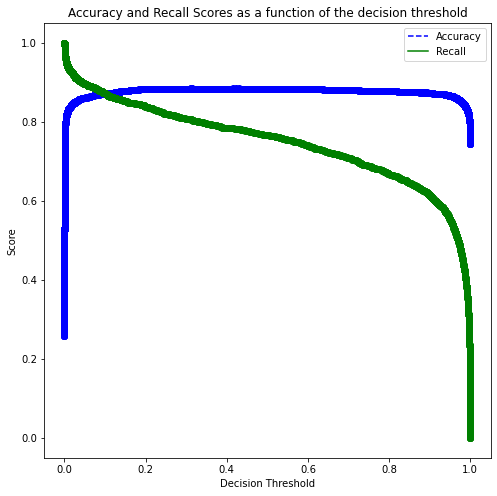

In [13]:
## Plotting 
mode_best = xgb.XGBClassifier(objective = 'binary:logistic', gamma= 0, learning_rate = 0.1, max_depth = 9, n_estimators = 400, reg_lambda = 0, subsample = 0.75).fit(X_train, y_train)

cross_val_ypred = cross_val_predict(mode_best, X_train, y_train, cv = 5, method = 'predict_proba')

p, r, thresholds = precision_recall_curve(y_train, cross_val_ypred[:,1])

accuracy_scores = []

for thresh in thresholds:
    y_pred = cross_val_ypred[:,1] > thresh
    y_pred = y_pred.astype(int)
    
    accuracy = accuracy_score(y_pred, y_train)
    accuracy_scores.append(accuracy)

def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    plt.figure(figsize=(8, 8))
    plt.title("Accuracy and Recall Scores as a function of the decision threshold")
    plt.plot(thresholds, accuracy_scores, "b--", label="Accuracy")
    plt.plot(thresholds, recalls[:-1], "g-", label="Recall")
    plt.plot(thresholds, accuracy_scores, "o", color = 'blue')
    plt.plot(thresholds, recalls[:-1], "o", color = 'green')
    plt.ylabel("Score")
    plt.xlabel("Decision Threshold")
    plt.legend(loc='best')
    plt.legend()
plot_precision_recall_vs_threshold(p, r, thresholds)

In [21]:
mode_best = xgb.XGBClassifier(objective = 'binary:logistic', gamma= 0, learning_rate = 0.1, max_depth = 9, n_estimators = 400, reg_lambda = 0, subsample = 0.75).fit(X_train, y_train)

#### CHANGE THIS THRESHOLD
desired_threshold = 0.15

# Metrics on Test Data
y_pred_prob = mode_best.predict_proba(X_test)[:,1] 
y_pred = y_pred_prob > desired_threshold
y_pred = y_pred.astype(int)
print("Accuracy on Test Data: ",accuracy_score(y_test, y_pred)*100, '%')  
print("Recall on Test Data: ", recall_score(y_test, y_pred)*100 , '%')


# Metrics on Train Data
y_pred_prob = mode_best.predict_proba(X_train)[:,1] 
y_pred_t = y_pred_prob > desired_threshold
y_pred_t = y_pred_t.astype(int)
print("Accuracy on Train Data: ",accuracy_score(y_train, y_pred_t)*100, '%')  
print("Recall on Train Data: ", recall_score(y_train, y_pred_t)*100 , '%')

[21:41:37] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy on Test Data:  86.31 %
Recall on Test Data:  81.35116115411682 %
Accuracy on Train Data:  100.0 %
Recall on Train Data:  100.0 %


#### TRY No. 2

In [15]:
start_time = tm.time()

param_dist = {'max_depth': [5, 7, 9, 10], 
            'n_estimators': [400, 600, 800, 1000], #hudreds
            'learning_rate': [0.01, 0.1, 1], 
            'reg_lambda': [0, 1, 5, 10],
            'gamma': [0, 2, 5],
             'subsample':[0.5, 0.75, 1]}

cv = KFold(n_splits = 2, shuffle = True, random_state = 1)

xgb_model = xgb.XGBClassifier(random_state = 1, n_jobs=-1)

model = RandomizedSearchCV(xgb_model, param_distributions=param_dist, verbose=1,
                                n_iter=20, scoring = ['accuracy','recall'], refit = 'recall',
                                 n_jobs=-1, cv=cv, random_state=1).fit(X_train, y_train)

print('Train accuracy : %.3f'%model.best_estimator_.score(X_train, y_train))
print('Test accuracy : %.3f'%model.best_estimator_.score(X_test, y_test))
print('Best accuracy Through Grid Search : %.3f'%model.best_score_)
print('Best params for recall')
print(model.best_params_)

print("Time taken =", round((tm.time() - start_time)), "seconds")

Fitting 2 folds for each of 20 candidates, totalling 40 fits


/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from p

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

[20:30:21] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Train accuracy : 1.000
Test accuracy : 0.864
Best accuracy Through Grid Search : 0.932
Best params for recall
{'subsample': 1, 'reg_lambda': 10, 'n_estimators': 800, 'max_depth': 7, 'learning_rate': 0.1, 'gamma': 0}
Time taken = 1917 seconds
[20:00:29] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:02:31] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGB

[20:00:29] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:04:11] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:05:37] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:06:48] WARNING: /Users/runner/miniforge3/cond

[21:25:52] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:27:53] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:29:25] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:31:02] WARNING: /Users/runner/miniforge3/cond

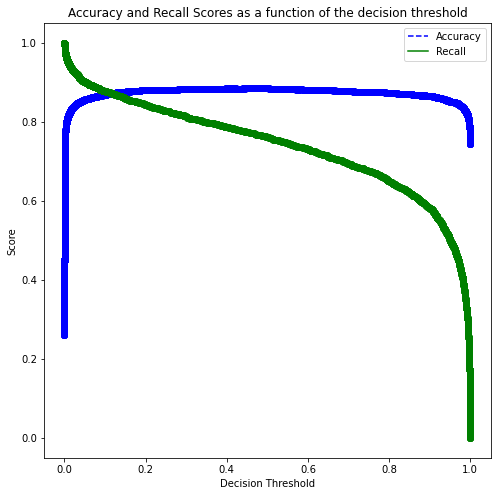

In [16]:
## Plotting 
mode_best = xgb.XGBClassifier(objective = 'binary:logistic', gamma= 0, learning_rate = 0.1, max_depth = 7, n_estimators = 800, reg_lambda = 10, subsample = 1).fit(X_train, y_train)

cross_val_ypred = cross_val_predict(mode_best, X_train, y_train, cv = 5, method = 'predict_proba')

p, r, thresholds = precision_recall_curve(y_train, cross_val_ypred[:,1])

accuracy_scores = []

for thresh in thresholds:
    y_pred = cross_val_ypred[:,1] > thresh
    y_pred = y_pred.astype(int)
    
    accuracy = accuracy_score(y_pred, y_train)
    accuracy_scores.append(accuracy)

def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    plt.figure(figsize=(8, 8))
    plt.title("Accuracy and Recall Scores as a function of the decision threshold")
    plt.plot(thresholds, accuracy_scores, "b--", label="Accuracy")
    plt.plot(thresholds, recalls[:-1], "g-", label="Recall")
    plt.plot(thresholds, accuracy_scores, "o", color = 'blue')
    plt.plot(thresholds, recalls[:-1], "o", color = 'green')
    plt.ylabel("Score")
    plt.xlabel("Decision Threshold")
    plt.legend(loc='best')
    plt.legend()
plot_precision_recall_vs_threshold(p, r, thresholds)

In [20]:
#### CHANGE THIS THRESHOLD
desired_threshold = 0.09

# Metrics on Test Data
y_pred_prob = mode_best.predict_proba(X_test)[:,1] 
y_pred = y_pred_prob > desired_threshold
y_pred = y_pred.astype(int)
print("Accuracy on Test Data: ",accuracy_score(y_test, y_pred)*100, '%')  
print("Recall on Test Data: ", recall_score(y_test, y_pred)*100 , '%')


# Metrics on Train Data
y_pred_prob = mode_best.predict_proba(X_train)[:,1] 
y_pred_t = y_pred_prob > desired_threshold
y_pred_t = y_pred_t.astype(int)
print("Accuracy on Train Data: ",accuracy_score(y_train, y_pred_t)*100, '%')  
print("Recall on Train Data: ", recall_score(y_train, y_pred_t)*100 , '%')

Accuracy on Test Data:  85.13 %
Recall on Test Data:  83.49753694581281 %
Accuracy on Train Data:  100.0 %
Recall on Train Data:  100.0 %


#### Try no.3

In [24]:
start_time = tm.time()

param_dist = {'max_depth': [6, 7, 8], 
            'n_estimators': [700, 800, 900], #hudreds
            'learning_rate': [0.01, 0.1, 1], 
            'reg_lambda': [0, 10],
            'gamma': [0],
             'subsample':[0.5, 0.75, 1]}

cv = KFold(n_splits = 2, shuffle = True, random_state = 1)

xgb_model = xgb.XGBClassifier(random_state = 1, n_jobs=-1)

model = GridSearchCV(xgb_model, param_grid=param_dist, verbose=1,
                                 scoring = ['accuracy','recall'], refit = 'recall',
                                 n_jobs=-1, cv=cv).fit(X_train, y_train)

print('Train accuracy : %.3f'%model.best_estimator_.score(X_train, y_train))
print('Test accuracy : %.3f'%model.best_estimator_.score(X_test, y_test))
print('Best accuracy Through Grid Search : %.3f'%model.best_score_)
print('Best params for recall')
print(model.best_params_)

print("Time taken =", round((tm.time() - start_time)), "seconds")

Fitting 2 folds for each of 162 candidates, totalling 324 fits


/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from p

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

[21:44:51] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:47:55] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:50:51] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:54:21] WARNING: /Users/runner/miniforge3/cond

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

[21:44:51] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:47:34] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:51:06] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:54:47] WARNING: /Users/runner/miniforge3/cond

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

[21:44:51] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:47:56] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:50:52] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:54:22] WARNING: /Users/runner/miniforge3/cond

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):


[21:44:51] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:47:34] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:51:04] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[21:54:46] WARNING: /Users/runner/miniforge3/cond

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

[01:22:26] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Train accuracy : 1.000
Test accuracy : 0.868
Best accuracy Through Grid Search : 0.939
Best params for recall
{'gamma': 0, 'learning_rate': 0.1, 'max_depth': 8, 'n_estimators': 700, 'reg_lambda': 0, 'subsample': 1}
Time taken = 13136 seconds
[00:45:47] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:49:10] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGB

[00:43:28] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:46:29] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:48:26] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:50:33] WARNING: /Users/runner/miniforge3/cond

[00:43:01] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:45:46] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:49:10] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:51:16] WARNING: /Users/runner/miniforge3/cond

[00:46:29] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:48:26] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:50:33] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[00:53:27] WARNING: /Users/runner/miniforge3/cond

[08:51:27] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:52:45] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:53:36] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[08:54:28] WARNING: /Users/runner/miniforge3/cond

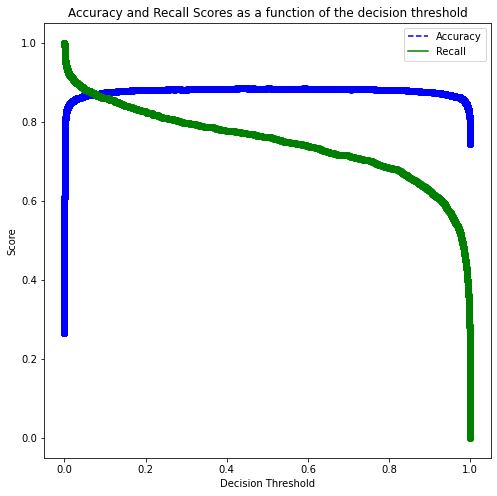

In [25]:
## Plotting 
mode_best = xgb.XGBClassifier(objective = 'binary:logistic', gamma= 0, learning_rate = 0.1, max_depth = 8, n_estimators = 700, reg_lambda = 0, subsample = 1).fit(X_train, y_train)

cross_val_ypred = cross_val_predict(mode_best, X_train, y_train, cv = 5, method = 'predict_proba')

p, r, thresholds = precision_recall_curve(y_train, cross_val_ypred[:,1])

accuracy_scores = []

for thresh in thresholds:
    y_pred = cross_val_ypred[:,1] > thresh
    y_pred = y_pred.astype(int)
    
    accuracy = accuracy_score(y_pred, y_train)
    accuracy_scores.append(accuracy)

def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    plt.figure(figsize=(8, 8))
    plt.title("Accuracy and Recall Scores as a function of the decision threshold")
    plt.plot(thresholds, accuracy_scores, "b--", label="Accuracy")
    plt.plot(thresholds, recalls[:-1], "g-", label="Recall")
    plt.plot(thresholds, accuracy_scores, "o", color = 'blue')
    plt.plot(thresholds, recalls[:-1], "o", color = 'green')
    plt.ylabel("Score")
    plt.xlabel("Decision Threshold")
    plt.legend(loc='best')
    plt.legend()
plot_precision_recall_vs_threshold(p, r, thresholds)

In [32]:
# Thresholds with precision and recall
accuracies = np.array(accuracy_scores) 
concat_array = np.concatenate([thresholds.reshape(-1,1), accuracies.reshape(-1,1), r[:-1].reshape(-1,1)], axis = 1)
thresh_scores = pd.DataFrame(data = concat_array, columns = ['thresh', 'accuracy', 'recall'] )

# Filter recall values over 60%
#thresh_scores = thresh_scores[thresh_scores['recall']> ]
thresh_scores = thresh_scores[thresh_scores['accuracy']> 0.8]
thresh_scores.head(3)

,thresh,accuracy,recall
5537,0.001635,0.8001,0.961222
5538,0.001638,0.8002,0.961222
5539,0.001642,0.8003,0.961222


In [37]:
#### CHANGE THIS THRESHOLD
desired_threshold = 0.009

# Metrics on Test Data
y_pred_prob = mode_best.predict_proba(X_test)[:,1] 
y_pred = y_pred_prob > desired_threshold
y_pred = y_pred.astype(int)
print("Accuracy on Test Data: ",accuracy_score(y_test, y_pred)*100, '%')  
print("Recall on Test Data: ", recall_score(y_test, y_pred)*100 , '%')


# Metrics on Train Data
y_pred_prob = mode_best.predict_proba(X_train)[:,1] 
y_pred_t = y_pred_prob > desired_threshold
y_pred_t = y_pred_t.astype(int)
print("Accuracy on Train Data: ",accuracy_score(y_train, y_pred_t)*100, '%')  
print("Recall on Train Data: ", recall_score(y_train, y_pred_t)*100 , '%')

Accuracy on Test Data:  83.47 %
Recall on Test Data:  89.33849401829697 %
Accuracy on Train Data:  100.0 %
Recall on Train Data:  100.0 %


#### Finer Grid Search Try no. 1

In [38]:
start_time = tm.time()

param_dist = {'max_depth': [7, 8, 9], 
            'n_estimators': [600, 700, 750], #hudreds
            'learning_rate': [0.01, 0.1, 1], 
            'reg_lambda': [0],
            'gamma': [0],
             'subsample':[1]}

cv = KFold(n_splits = 2, shuffle = True, random_state = 1)

xgb_model = xgb.XGBClassifier(random_state = 1, n_jobs=-1)

model = GridSearchCV(xgb_model, param_grid=param_dist, verbose=1,
                                 scoring = ['accuracy','recall'], refit = 'recall',
                                 n_jobs=-1, cv=cv).fit(X_train, y_train)

print('Train accuracy : %.3f'%model.best_estimator_.score(X_train, y_train))
print('Test accuracy : %.3f'%model.best_estimator_.score(X_test, y_test))
print('Best accuracy Through Grid Search : %.3f'%model.best_score_)
print('Best params for recall')
print(model.best_params_)

print("Time taken =", round((tm.time() - start_time)), "seconds")

Fitting 2 folds for each of 27 candidates, totalling 54 fits


/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from p

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

[09:46:31] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Train accuracy : 1.000
Test accuracy : 0.868
Best accuracy Through Grid Search : 0.940
Best params for recall
{'gamma': 0, 'learning_rate': 0.1, 'max_depth': 8, 'n_estimators': 600, 'reg_lambda': 0, 'subsample': 1}
Time taken = 2573 seconds


[09:50:04] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[09:05:07] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[09:09:29] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[09:15:16] WARNING: /Users/runner/miniforge3/cond

[09:05:07] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[09:10:06] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[09:15:46] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[09:22:03] WARNING: /Users/runner/miniforge3/cond

[09:52:15] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[09:53:13] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[09:54:07] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[09:54:56] WARNING: /Users/runner/miniforge3/cond

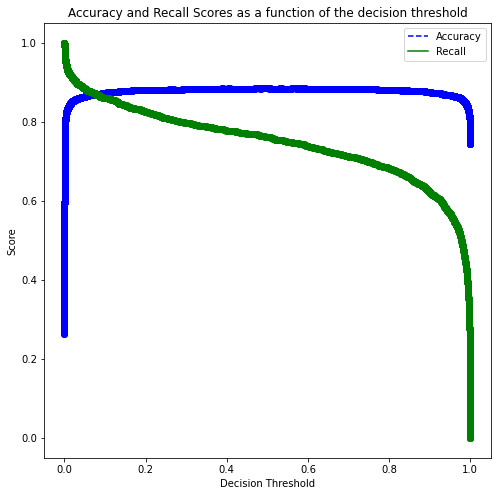

In [39]:
## Plotting 
mode_best = xgb.XGBClassifier(objective = 'binary:logistic', gamma= 0, learning_rate = 0.1, max_depth = 8, n_estimators = 600, reg_lambda = 0, subsample = 1).fit(X_train, y_train)

cross_val_ypred = cross_val_predict(mode_best, X_train, y_train, cv = 5, method = 'predict_proba')

p, r, thresholds = precision_recall_curve(y_train, cross_val_ypred[:,1])

accuracy_scores = []

for thresh in thresholds:
    y_pred = cross_val_ypred[:,1] > thresh
    y_pred = y_pred.astype(int)
    
    accuracy = accuracy_score(y_pred, y_train)
    accuracy_scores.append(accuracy)

def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    plt.figure(figsize=(8, 8))
    plt.title("Accuracy and Recall Scores as a function of the decision threshold")
    plt.plot(thresholds, accuracy_scores, "b--", label="Accuracy")
    plt.plot(thresholds, recalls[:-1], "g-", label="Recall")
    plt.plot(thresholds, accuracy_scores, "o", color = 'blue')
    plt.plot(thresholds, recalls[:-1], "o", color = 'green')
    plt.ylabel("Score")
    plt.xlabel("Decision Threshold")
    plt.legend(loc='best')
    plt.legend()
plot_precision_recall_vs_threshold(p, r, thresholds)


In [44]:
#### CHANGE THIS THRESHOLD
desired_threshold = 0.1

# Metrics on Test Data
y_pred_prob = mode_best.predict_proba(X_test)[:,1] 
y_pred = y_pred_prob > desired_threshold
y_pred = y_pred.astype(int)
print("Accuracy on Test Data: ",accuracy_score(y_test, y_pred)*100, '%')  
print("Recall on Test Data: ", recall_score(y_test, y_pred)*100 , '%')


# Metrics on Train Data
y_pred_prob = mode_best.predict_proba(X_train)[:,1] 
y_pred_t = y_pred_prob > desired_threshold
y_pred_t = y_pred_t.astype(int)
print("Accuracy on Train Data: ",accuracy_score(y_train, y_pred_t)*100, '%')  
print("Recall on Train Data: ", recall_score(y_train, y_pred_t)*100 , '%')

Accuracy on Test Data:  85.83 %
Recall on Test Data:  82.23082336382829 %
Accuracy on Train Data:  100.0 %
Recall on Train Data:  100.0 %


#### Finer Grid Search Try no. 2

In [46]:
start_time = tm.time()

param_dist = {'max_depth': [7, 8, 9], 
            'n_estimators': [550, 600, 650], #hudreds
            'learning_rate': [0.01, 0.1, 1], 
            'reg_lambda': [0],
            'gamma': [0],
             'subsample':[0.75, 1]}

cv = KFold(n_splits = 5, shuffle = True, random_state = 1)

xgb_model = xgb.XGBClassifier(random_state = 1, n_jobs=-1)

model = GridSearchCV(xgb_model, param_grid=param_dist, verbose=1,
                                 scoring = ['accuracy','recall'], refit = 'recall',
                                 n_jobs=-1, cv=cv).fit(X_train, y_train)

print('Train accuracy : %.3f'%model.best_estimator_.score(X_train, y_train))
print('Test accuracy : %.3f'%model.best_estimator_.score(X_test, y_test))
print('Best accuracy Through Grid Search : %.3f'%model.best_score_)
print('Best params for recall')
print(model.best_params_)

print("Time taken =", round((tm.time() - start_time)), "seconds")

Fitting 5 folds for each of 54 candidates, totalling 270 fits


/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from p

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do the following: 1) Pass option use_label_encoder=False when constructing XGBClassifier object; and 2) Encode your labels (y) as integers starting with 0, i.e. 0, 1, 2, ..., [num_class - 1].
  warnings.warn(label_encoder_deprecation_msg, UserWarning)
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/data.py:262: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  elif isinstance(data.columns, (pd.Int64Index, pd.RangeIndex)):
/Users/elenallaguno/opt/anaconda3/lib/python3.9/site-packages/xgboost/sklearn.py:1224: UserWarning: The use of label encoder in XGBClassifier is deprecated and will be removed in a future release. To remove this warning, do th

[14:33:58] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Train accuracy : 1.000
Test accuracy : 0.867
Best accuracy Through Grid Search : 0.978
Best params for recall
{'gamma': 0, 'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 650, 'reg_lambda': 0, 'subsample': 1}
Time taken = 16355 seconds
[10:03:05] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:08:17] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGB

[10:03:05] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:08:12] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:13:12] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:19:03] WARNING: /Users/runner/miniforge3/cond

[10:03:05] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:08:14] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:14:08] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:19:35] WARNING: /Users/runner/miniforge3/cond

[10:03:05] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:08:13] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:14:02] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:19:48] WARNING: /Users/runner/miniforge3/cond

[14:39:56] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:41:19] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:42:10] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[14:43:06] WARNING: /Users/runner/miniforge3/cond

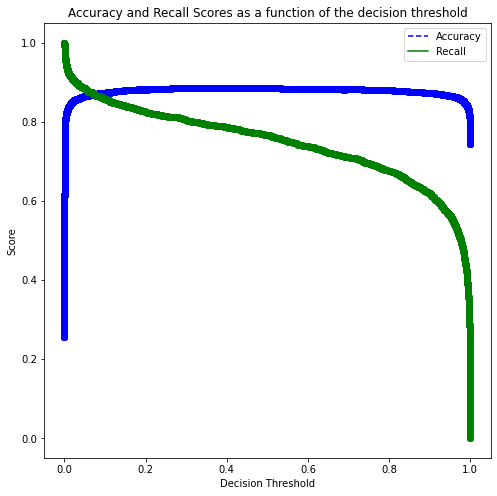

In [48]:
## Plotting 
mode_best = xgb.XGBClassifier(gamma= 0, learning_rate = 0.1, max_depth = 7, n_estimators = 650, reg_lambda = 0, subsample = 1).fit(X_train, y_train)

cross_val_ypred = cross_val_predict(mode_best, X_train, y_train, cv = 5, method = 'predict_proba')

p, r, thresholds = precision_recall_curve(y_train, cross_val_ypred[:,1])

accuracy_scores = []

for thresh in thresholds:
    y_pred = cross_val_ypred[:,1] > thresh
    y_pred = y_pred.astype(int)
    
    accuracy = accuracy_score(y_pred, y_train)
    accuracy_scores.append(accuracy)

def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    plt.figure(figsize=(8, 8))
    plt.title("Accuracy and Recall Scores as a function of the decision threshold")
    plt.plot(thresholds, accuracy_scores, "b--", label="Accuracy")
    plt.plot(thresholds, recalls[:-1], "g-", label="Recall")
    plt.plot(thresholds, accuracy_scores, "o", color = 'blue')
    plt.plot(thresholds, recalls[:-1], "o", color = 'green')
    plt.ylabel("Score")
    plt.xlabel("Decision Threshold")
    plt.legend(loc='best')
    plt.legend()
plot_precision_recall_vs_threshold(p, r, thresholds)


In [74]:
#mode_best = xgb.XGBClassifier(gamma= 0, learning_rate = 0.1, max_depth = 7, n_estimators = 650, reg_lambda = 0, subsample = 1).fit(X_train, y_train)

#### CHANGE THIS THRESHOLD
desired_threshold = 0.04

# Metrics on Test Data
y_pred_prob = mode_best.predict_proba(X_test)[:,1] 
y_pred = y_pred_prob > desired_threshold
y_pred = y_pred.astype(int)
print("Accuracy on Test Data: ",accuracy_score(y_test, y_pred)*100, '%')  
print("Recall on Test Data: ", recall_score(y_test, y_pred)*100 , '%')


# Metrics on Train Data
y_pred_prob = mode_best.predict_proba(X_train)[:,1] 
y_pred_t = y_pred_prob > desired_threshold
y_pred_t = y_pred_t.astype(int)
print("Accuracy on Train Data: ",accuracy_score(y_train, y_pred_t)*100, '%')  
print("Recall on Train Data: ", recall_score(y_train, y_pred_t)*100 , '%')

Accuracy on Test Data:  85.11 %
Recall on Test Data:  85.32723434201267 %
Accuracy on Train Data:  100.0 %
Recall on Train Data:  100.0 %


#### Manually Tuning Final XG Model

Best Parametes from GridSerch:
gamma= 0, learning_rate = 0.1, max_depth = 7, n_estimators = 650, reg_lambda = 0, subsample = 1

In [78]:
model_best = xgb.XGBClassifier(gamma= 0, learning_rate = 0.11, max_depth = 7, n_estimators = 650, reg_lambda = 0, subsample = 1).fit(X_train, y_train)

#### CHANGE THIS THRESHOLD
desired_threshold = 0.04

# Metrics on Test Data
y_pred_prob = model_best.predict_proba(X_test)[:,1] 
y_pred = y_pred_prob > desired_threshold
y_pred = y_pred.astype(int)
print("Accuracy on Test Data: ",accuracy_score(y_test, y_pred)*100, '%')  
print("Recall on Test Data: ", recall_score(y_test, y_pred)*100 , '%')


# Metrics on Train Data
y_pred_prob = mode_best.predict_proba(X_train)[:,1] 
y_pred_t = y_pred_prob > desired_threshold
y_pred_t = y_pred_t.astype(int)
print("Accuracy on Train Data: ",accuracy_score(y_train, y_pred_t)*100, '%')  
print("Recall on Train Data: ", recall_score(y_train, y_pred_t)*100 , '%')

[15:40:52] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Accuracy on Test Data:  85.06 %
Recall on Test Data:  84.97536945812809 %
Accuracy on Train Data:  100.0 %
Recall on Train Data:  100.0 %


In [89]:
model_best = xgb.XGBClassifier(gamma= 0, learning_rate = 0.1, max_depth = 7, n_estimators = 675, reg_lambda = 0, subsample = 1).fit(X_train, y_train)

#### CHANGE THIS THRESHOLD
desired_threshold = 0.03

# Metrics on Test Data
y_pred_prob = model_best.predict_proba(X_test)[:,1] 
y_pred = y_pred_prob > desired_threshold
y_pred = y_pred.astype(int)
print("Accuracy on Test Data: ",accuracy_score(y_test, y_pred)*100, '%')  
print("Recall on Test Data: ", recall_score(y_test, y_pred)*100 , '%')


# Metrics on Train Data
y_pred_prob = mode_best.predict_proba(X_train)[:,1] 
y_pred_t = y_pred_prob > desired_threshold
y_pred_t = y_pred_t.astype(int)
print("Accuracy on Train Data: ",accuracy_score(y_train, y_pred_t)*100, '%')  
print("Recall on Train Data: ", recall_score(y_train, y_pred_t)*100 , '%')

Accuracy on Test Data:  84.88 %
Recall on Test Data:  86.03096410978185 %
Accuracy on Train Data:  100.0 %
Recall on Train Data:  100.0 %


Manual tuning does not improve my result

## 3. Ridge Regression 

In [81]:
from sklearn.linear_model import Ridge, RidgeCV, Lasso, LassoCV
from sklearn.preprocessing import StandardScaler 

#### Scaling Train Data

In [146]:
#Filtering all predictors
X = X_train

#Defining a scaler object
scaler = StandardScaler()

#The scaler object will contain the mean and variance of each column (predictor) of X. 
#These values will be useful to scale test data based on the same mean and variance as obtained on train data
scaler.fit(X)

#Using the scaler object (or the values of mean and variance stored in it) to standardize X (or train data)
Xstd = scaler.transform(X)

#### Tuning parameter lamda

In [147]:
#The tuning parameter lambda is referred as alpha in sklearn

#Creating a range of values of the tuning parameter to visualize the ridge regression coefficients
#for different values of the tuning parameter
alphas = 10**np.linspace(10,-2,200)*0.5

In [148]:
#Finding the ridge regression coefficients for increasing values of the tuning parameter
coefs = []
for a in alphas:        
    ridge = Ridge(alpha = a)
    ridge.fit(Xstd, y_train)
    coefs.append(ridge.coef_)

Text(0, 0.5, 'Standardized coefficient')

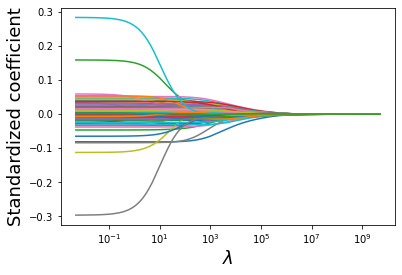

In [149]:
#Visualizing the shrinkage in ridge regression coefficients with increasing values of the tuning parameter lambda
plt.xlabel('xlabel', fontsize=18)
plt.ylabel('ylabel', fontsize=18)
plt.plot(alphas, coefs)
plt.xscale('log')
plt.xlabel('$\lambda$')
plt.ylabel('Standardized coefficient')
#plt.legend(train.columns);

In [150]:
#Let us use cross validation to find the optimal value of the tuning parameter - lambda
#For the optimal lambda, the cross validation error will be the least

#Note that we are reducing the range of alpha so as to better visualize the minimum

### CHANGE SHOULD REDUCE THE VALUE OF LAMDA!!!!! AFTER LOOKING AT GRAPH 
alphas = 10**np.linspace(1.5,-4,200)*0.5
ridgecv = RidgeCV(alphas = alphas,store_cv_values=True)
ridgecv.fit(Xstd, y_train)

#Optimal value of the tuning parameter - lambda
ridgecv.alpha_

7.367356964499727

Text(0, 0.5, 'Cross-validation error')

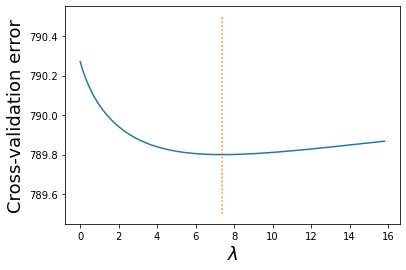

In [151]:
#Visualizing the LOOCV (leave one out cross validatation error vs lambda)
plt.xlabel('xlabel', fontsize=18)
plt.ylabel('ylabel', fontsize=18)
plt.plot(ridgecv.alphas,ridgecv.cv_values_.sum(axis=0))
plt.plot([ridgecv.alpha_,ridgecv.alpha_],[789.5,790.5],':')
plt.xlabel('$\lambda$')
plt.ylabel('Cross-validation error')

#### Scaling Test Data

In [152]:
#Filtering all predictors
X2 = X_test

#Defining a scaler object
scaler = StandardScaler()

#The scaler object will contain the mean and variance of each column (predictor) of X. 
#These values will be useful to scale test data based on the same mean and variance as obtained on train data
scaler.fit(X2)

#Using the scaler object (or the values of mean and variance stored in it) to standardize X (or train data)
Xtest_std = scaler.transform(X2)

#### Predicting on Test Data

In [159]:
#Using the developed ridge regression model to predict on test data
ridge = Ridge(alpha = ridgecv.alpha_)
ridge = ridge.fit(Xstd, y_test)
pred=ridge.predict(Xtest_std)
ridge_coeff = pd.DataFrame(ridge.coef_, columns = ['coefficients'])
ridge_coeff['predictors'] = X.columns
ridge_coeff

,coefficients,predictors
0,-0.025391,P_2
1,-0.005989,D_39
2,0.121780,B_1
3,-0.006624,B_2
4,0.012172,R_1
...,...,...
158,0.005149,D_140
159,-0.109927,D_141
160,0.090687,D_143
161,0.008862,D_144


#### Test/Train results

In [91]:
#Function to compute confusion matrix and prediction accuracy on test/train data
def confusion_matrix_data(data,actual_values,model,cutoff=0.5):
#Predict the values using the Logit model
    pred_values = model.predict(data)
# Specify the bins
    bins=np.array([0,cutoff,1])
#Confusion matrix
    cm = np.histogram2d(actual_values, pred_values, bins=bins)[0]
    cm_df = pd.DataFrame(cm)
    cm_df.columns = ['Predicted 0','Predicted 1']
    cm_df = cm_df.rename(index={0: 'Actual 0',1:'Actual 1'})
# Calculate the accuracy
    accuracy = (cm[0,0]+cm[1,1])/cm.sum()
    fnr = (cm[1,0])/(cm[1,0]+cm[1,1])
    precision = (cm[1,1])/(cm[0,1]+cm[1,1])
    fpr = (cm[0,1])/(cm[0,0]+cm[0,1])
    tpr = (cm[1,1])/(cm[1,0]+cm[1,1])
    fpr_roc, tpr_roc, auc_thresholds = roc_curve(actual_values, pred_values)
    auc_value = (auc(fpr_roc, tpr_roc))# AUC of ROC
    sns.heatmap(cm_df, annot=True, cmap='Blues', fmt='g')
    plt.ylabel("Actual Values")
    plt.xlabel("Predicted Values")
    print("Classification accuracy = {:.1%}".format(accuracy))
    print("Precision = {:.1%}".format(precision))
    print("TPR or Recall = {:.1%}".format(tpr))
    print("FNR = {:.1%}".format(fnr))
    print("FPR = {:.1%}".format(fpr))
    print("ROC-AUC = {:.1%}".format(auc_value))

Classification accuracy = 66.2%
Precision = 33.6%
TPR or Recall = 34.2%
FNR = 65.8%
FPR = 22.9%
ROC-AUC = 52.5%


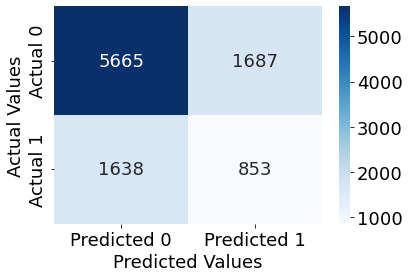

In [242]:
confusion_matrix_data(Xstd, y_train, ridge, cutoff = 0.35)

Classification accuracy = 63.7%
Precision = 35.4%
TPR or Recall = 33.7%
FNR = 66.3%
FPR = 24.4%
ROC-AUC = 53.4%


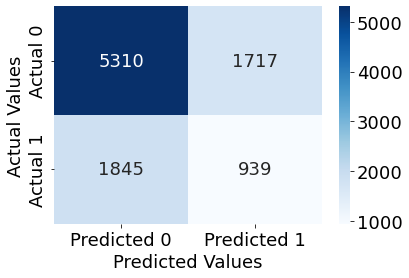

[10:17:36] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:23:18] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:31:50] WARNING: /Users/runner/miniforge3/conda-bld/xgboost-split_1645117948562/work/src/learner.cc:1115: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[10:38:14] WARNING: /Users/runner/miniforge3/cond

In [243]:
confusion_matrix_data(Xtest_std, y_test, ridge, cutoff = 0.35)

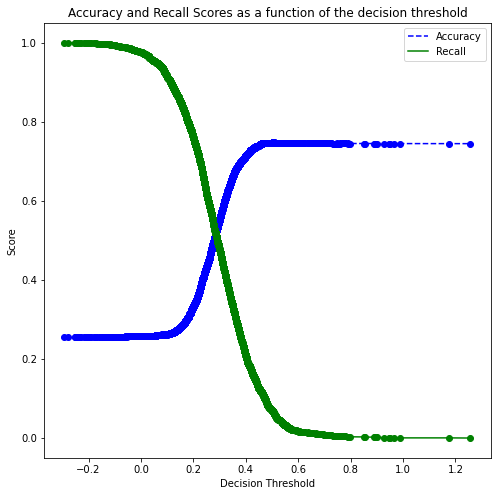

In [163]:
p, r, thresholds = precision_recall_curve(y_train, ridge.predict(Xstd))

accuracy_scores = []

for thresh in thresholds:
    y_pred = ridge.predict(Xstd) > thresh
    y_pred = y_pred.astype(int)
    
    accuracy = accuracy_score(y_pred, y_train)
    accuracy_scores.append(accuracy)

def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    plt.figure(figsize=(8, 8))
    plt.title("Accuracy and Recall Scores as a function of the decision threshold")
    plt.plot(thresholds, accuracy_scores, "b--", label="Accuracy")
    plt.plot(thresholds, recalls[:-1], "g-", label="Recall")
    plt.plot(thresholds, accuracy_scores, "o", color = 'blue')
    plt.plot(thresholds, recalls[:-1], "o", color = 'green')
    plt.ylabel("Score")
    plt.xlabel("Decision Threshold")
    plt.legend(loc='best')
    plt.legend()
plot_precision_recall_vs_threshold(p, r, thresholds)

**Optimal Threshold**: 0.35

## 4. Lasso Regression 

#### Tuning parameter

In [168]:
#Creating a range of values of the tuning parameter to visualize the lasso coefficients
#for different values of the tuning parameter
alphas = 10**np.linspace(10,-2,100)*0.1

In [169]:
#Finding the lasso coefficients for increasing values of the tuning parameter
lasso = Lasso(max_iter = 10000)
coefs = []

for a in alphas:
    lasso.set_params(alpha=a)
    lasso.fit(Xstd, y_train)
    coefs.append(lasso.coef_)

Text(0, 0.5, 'Standardized coefficient')

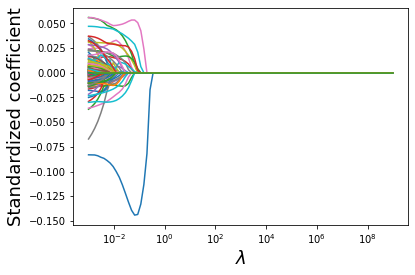

In [170]:
#Visualizing the shrinkage in lasso coefficients with increasing values of the tuning parameter lambda
plt.xlabel('xlabel', fontsize=18)
plt.ylabel('ylabel', fontsize=18)
plt.plot(alphas, coefs)
plt.xscale('log')
plt.xlabel('$\lambda$')
plt.ylabel('Standardized coefficient')
#plt.legend(train.columns[1:6]);

In [173]:
#Let us use cross validation to find the optimal value of the tuning parameter - lambda
#For the optimal lambda, the cross validation error will be the least

#Note that we are reducing the range of alpha so as to better visualize the minimum
alphas = 10**np.linspace(-1,-5,200)*0.5
lassocv = LassoCV(alphas = alphas, cv = 10, max_iter = 100000)
lassocv.fit(Xstd, y_train)

#Optimal value of the tuning parameter - lamda
lassocv.alpha_

0.013063376127816646

Text(0, 0.5, 'Cross-validation error')

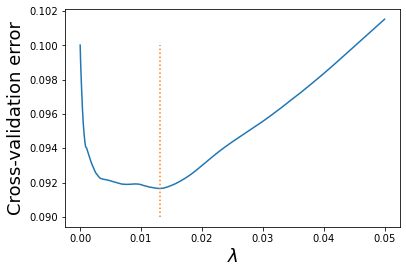

In [174]:
#Visualizing the LOOCV (leave one out cross validatation error vs lambda)
plt.xlabel('xlabel', fontsize=18)
plt.ylabel('ylabel', fontsize=18)
plt.plot(lassocv.alphas_,lassocv.mse_path_.mean(axis=1))
plt.plot([lassocv.alpha_,lassocv.alpha_],[0.09,0.10],':')
plt.xlabel('$\lambda$')
plt.ylabel('Cross-validation error')

#### Predicting on Test Data

In [175]:
#Using the developed lasso model to predict on test data
lasso = Lasso(alpha = lassocv.alpha_)
lasso = lasso.fit(Xstd, y_test)

#### Test/Train results

Classification accuracy = 70.2%
Precision = 40.2%
TPR or Recall = 33.9%
FNR = 66.1%
FPR = 17.3%
ROC-AUC = 60.5%


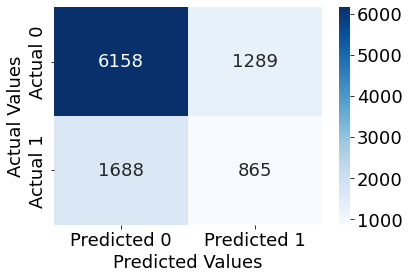

In [247]:
confusion_matrix_data(Xstd, y_train, lasso, cutoff = 0.3)

Classification accuracy = 66.2%
Precision = 39.2%
TPR or Recall = 34.0%
FNR = 66.0%
FPR = 21.0%
ROC-AUC = 60.0%


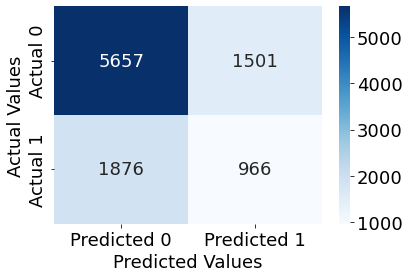

In [248]:
confusion_matrix_data(Xtest_std, y_test, lasso, cutoff = 0.3)

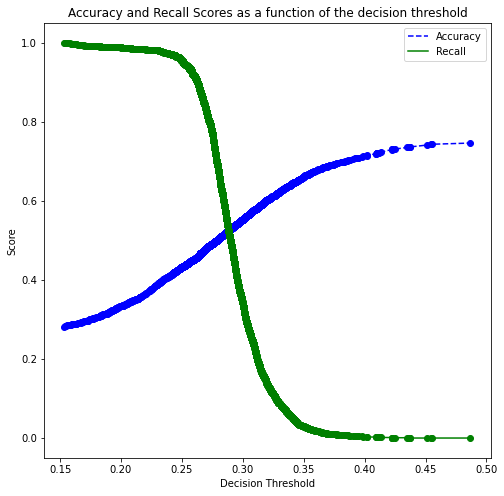

In [176]:
p, r, thresholds = precision_recall_curve(y_train, lasso.predict(Xstd))

accuracy_scores = []

for thresh in thresholds:
    y_pred = ridge.predict(Xstd) > thresh
    y_pred = y_pred.astype(int)
    
    accuracy = accuracy_score(y_pred, y_train)
    accuracy_scores.append(accuracy)

def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    plt.figure(figsize=(8, 8))
    plt.title("Accuracy and Recall Scores as a function of the decision threshold")
    plt.plot(thresholds, accuracy_scores, "b--", label="Accuracy")
    plt.plot(thresholds, recalls[:-1], "g-", label="Recall")
    plt.plot(thresholds, accuracy_scores, "o", color = 'blue')
    plt.plot(thresholds, recalls[:-1], "o", color = 'green')
    plt.ylabel("Score")
    plt.xlabel("Decision Threshold")
    plt.legend(loc='best')
    plt.legend()
plot_precision_recall_vs_threshold(p, r, thresholds)

**Optimal threshold**:  0.3

## 5. Stepwise Variable Selection

In [50]:
def best_sub_plots():
    plt.figure(figsize=(20,10))
    plt.rcParams.update({'font.size': 18, 'lines.markersize': 10})

    # Set up a 2x2 grid so we can look at 4 plots at once
    plt.subplot(2, 2, 1)


    # We'll do the same for AIC and BIC, this time looking for the models with the SMALLEST statistic
    aic = models_best.apply(lambda row: row[1].aic, axis=1)

    plt.subplot(2, 2, 1)
    plt.plot(aic)
    plt.plot(1+aic.argmin(), aic.min(), "or")
    plt.xlabel('# Predictors')
    plt.ylabel('AIC')

    bic = models_best.apply(lambda row: row[1].bic, axis=1)

    plt.subplot(2, 2, 2)
    plt.plot(bic)
    plt.plot(1+bic.argmin(), bic.min(), "or")
    plt.xlabel('# Predictors')
    plt.ylabel('BIC')


In [21]:
#Function to develop a model based on all predictors in predictor_subset
def processSubset(predictor_subset):
    # Fit model on feature_set and calculate R-squared
    print(predictor_subset)
    model = sm.logit('target~' + '+'.join(predictor_subset), data = train).fit()
    BIC = model.bic
    return {"model":model, "BIC":BIC}

### 5. 1 Forward Stepwise Selection

In [12]:
X_list = X_train.columns.tolist()
len(X_list)

163

In [13]:
# REMOVED PREDICTOR D_116 BECAUSE IT GATE SINGULAR MATRIX ERROR

In [14]:
X_list_2 = ['P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 
            'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3',
            'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13',
            'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17',
            'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 
            'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79',
            'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 
            'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 
            'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25',
            'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103', 'D_104', 'D_105', 'D_107', 'B_36',
            'B_37', 'R_27', 'B_38', 'D_109', 'D_112', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 
            'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',  'D_128', 
            'D_129', 'B_41', 'D_130', 'D_131', 'D_133', 'R_28', 'D_139', 'D_140', 'D_141', 'D_143', 'D_144', 'D_145']
len(X_list_2)

162

In [46]:
#Creating a dataframe with all the predictors
X = train[X_list_2]
#Since 'X' will change when we include interactions, we need a backup containing all individual predictors
X_backup = train[X_list_2]

In [47]:
#Function to find the best predictor out of p-k predictors and add it to the model containing the k predictors
def forward(predictors):

    # Pull out predictors we still need to process
    remaining_predictors = [p for p in X.columns if p not in predictors]
    
    tic = tm.time()
    
    results = []
    
    for p in remaining_predictors:
        results.append(processSubset(predictors+[p]))
    
    # Wrap everything up in a nice dataframe
    models = pd.DataFrame(results)
    
    # Choose the model with the highest RSS
    best_model = models.loc[models['BIC'].argmin()]
    
    toc = tm.time()
    print("Processed ", models.shape[0], "models on", len(predictors)+1, "predictors in", (toc-tic), "seconds.")
    
    # Return the best model, along with some other useful information about the model
    return best_model

In [48]:
def forward_selection():
    models_best = pd.DataFrame(columns=["BIC", "model"])

    tic = tm.time()
    predictors = []

    for i in range(1,len(X.columns)+1):    
        models_best.loc[i] = forward(predictors)
        predictors = list(models_best.loc[i]["model"].params.index[1:])

    toc = tm.time()
    print("Total elapsed time:", (toc-tic), "seconds.")
    return models_best

In [49]:
models_best = forward_selection()

['P_2']
Optimization terminated successfully.
         Current function value: 0.330268
         Iterations 7
['D_39']
Optimization terminated successfully.
         Current function value: 0.551522
         Iterations 5
['B_1']
Optimization terminated successfully.
         Current function value: 0.503960
         Iterations 6
['B_2']
Optimization terminated successfully.
         Current function value: 0.465167
         Iterations 6
['R_1']
Optimization terminated successfully.
         Current function value: 0.502821
         Iterations 6
['S_3']
Optimization terminated successfully.
         Current function value: 0.526987
         Iterations 6
['D_41']
Optimization terminated successfully.
         Current function value: 0.518310
         Iterations 6
['B_3']
Optimization terminated successfully.
         Current function value: 0.494567
         Iterations 6
['D_43']
Optimization terminated successfully.
         Current function value: 0.509454
         Iterations 6
['D_44'

Optimization terminated successfully.
         Current function value: 0.568072
         Iterations 5
['D_81']
Optimization terminated successfully.
         Current function value: 0.539641
         Iterations 7
['D_82']
Optimization terminated successfully.
         Current function value: 0.562062
         Iterations 5
['S_17']
Optimization terminated successfully.
         Current function value: 0.567948
         Iterations 5
['R_12']
Optimization terminated successfully.
         Current function value: 0.544905
         Iterations 6
['B_28']
Optimization terminated successfully.
         Current function value: 0.543756
         Iterations 5
['R_13']
Optimization terminated successfully.
         Current function value: 0.561136
         Iterations 6
['D_83']
Optimization terminated successfully.
         Current function value: 0.565621
         Iterations 5
['R_14']
Optimization terminated successfully.
         Current function value: 0.559085
         Iterations 10
['R_15']


Optimization terminated successfully.
         Current function value: 0.562058
         Iterations 5
['D_141']
Optimization terminated successfully.
         Current function value: 0.555414
         Iterations 5
['D_143']
Optimization terminated successfully.
         Current function value: 0.555298
         Iterations 5
['D_144']
Optimization terminated successfully.
         Current function value: 0.568040
         Iterations 5
['D_145']
Optimization terminated successfully.
         Current function value: 0.561542
         Iterations 5
Processed  162 models on 1 predictors in 3.2436959743499756 seconds.
['P_2', 'D_39']
Optimization terminated successfully.
         Current function value: 0.326211
         Iterations 7
['P_2', 'B_1']
Optimization terminated successfully.
         Current function value: 0.311916
         Iterations 7
['P_2', 'B_2']
Optimization terminated successfully.
         Current function value: 0.317983
         Iterations 7
['P_2', 'R_1']
Optimization t

Optimization terminated successfully.
         Current function value: 0.315911
         Iterations 7
['P_2', 'B_24']
Optimization terminated successfully.
         Current function value: 0.328831
         Iterations 7
['P_2', 'R_7']
Optimization terminated successfully.
         Current function value: 0.329896
         Iterations 7
['P_2', 'D_77']
Optimization terminated successfully.
         Current function value: 0.309565
         Iterations 8
['P_2', 'B_25']
Optimization terminated successfully.
         Current function value: 0.324171
         Iterations 7
['P_2', 'B_26']
Optimization terminated successfully.
         Current function value: 0.329704
         Iterations 7
['P_2', 'D_78']
Optimization terminated successfully.
         Current function value: 0.329781
         Iterations 7
['P_2', 'D_79']
Optimization terminated successfully.
         Current function value: 0.325055
         Iterations 7
['P_2', 'R_8']
Optimization terminated successfully.
         Current fun

Optimization terminated successfully.
         Current function value: 0.327351
         Iterations 7
['P_2', 'D_125']
Optimization terminated successfully.
         Current function value: 0.330084
         Iterations 7
['P_2', 'D_126']
Optimization terminated successfully.
         Current function value: 0.330242
         Iterations 7
['P_2', 'D_127']
Optimization terminated successfully.
         Current function value: 0.323384
         Iterations 11
['P_2', 'D_128']
Optimization terminated successfully.
         Current function value: 0.328763
         Iterations 7
['P_2', 'D_129']
Optimization terminated successfully.
         Current function value: 0.329129
         Iterations 7
['P_2', 'B_41']
Optimization terminated successfully.
         Current function value: 0.329860
         Iterations 7
['P_2', 'D_130']
Optimization terminated successfully.
         Current function value: 0.327056
         Iterations 7
['P_2', 'D_131']
Optimization terminated successfully.
         C

Optimization terminated successfully.
         Current function value: 0.296835
         Iterations 8
['P_2', 'D_77', 'B_19']
Optimization terminated successfully.
         Current function value: 0.306053
         Iterations 8
['P_2', 'D_77', 'B_20']
Optimization terminated successfully.
         Current function value: 0.306872
         Iterations 8
['P_2', 'D_77', 'D_68']
Optimization terminated successfully.
         Current function value: 0.309319
         Iterations 8
['P_2', 'D_77', 'S_12']
Optimization terminated successfully.
         Current function value: 0.309557
         Iterations 8
['P_2', 'D_77', 'R_6']
Optimization terminated successfully.
         Current function value: 0.309120
         Iterations 8
['P_2', 'D_77', 'S_13']
Optimization terminated successfully.
         Current function value: 0.309540
         Iterations 8
['P_2', 'D_77', 'B_21']
Optimization terminated successfully.
         Current function value: 0.308209
         Iterations 8
['P_2', 'D_77', '

Optimization terminated successfully.
         Current function value: 0.308268
         Iterations 8
['P_2', 'D_77', 'D_104']
Optimization terminated successfully.
         Current function value: 0.308231
         Iterations 8
['P_2', 'D_77', 'D_105']
Optimization terminated successfully.
         Current function value: 0.308561
         Iterations 8
['P_2', 'D_77', 'D_107']
Optimization terminated successfully.
         Current function value: 0.308236
         Iterations 8
['P_2', 'D_77', 'B_36']
Optimization terminated successfully.
         Current function value: 0.308023
         Iterations 8
['P_2', 'D_77', 'B_37']
Optimization terminated successfully.
         Current function value: 0.295326
         Iterations 8
['P_2', 'D_77', 'R_27']
Optimization terminated successfully.
         Current function value: 0.304505
         Iterations 8
['P_2', 'D_77', 'B_38']
Optimization terminated successfully.
         Current function value: 0.305927
         Iterations 8
['P_2', 'D_77

Optimization terminated successfully.
         Current function value: 0.294054
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_54']
Optimization terminated successfully.
         Current function value: 0.292141
         Iterations 8
['P_2', 'D_77', 'B_11', 'R_4']
Optimization terminated successfully.
         Current function value: 0.294060
         Iterations 8
['P_2', 'D_77', 'B_11', 'S_7']
Optimization terminated successfully.
         Current function value: 0.290358
         Iterations 8
['P_2', 'D_77', 'B_11', 'B_12']
Optimization terminated successfully.
         Current function value: 0.294423
         Iterations 8
['P_2', 'D_77', 'B_11', 'S_8']
Optimization terminated successfully.
         Current function value: 0.293758
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_55']
Optimization terminated successfully.
         Current function value: 0.292130
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_56']
Optimization terminated successfully.
         Current function v

Optimization terminated successfully.
         Current function value: 0.294456
         Iterations 8
['P_2', 'D_77', 'B_11', 'B_31']
Optimization terminated successfully.
         Current function value: 0.293686
         Iterations 8
['P_2', 'D_77', 'B_11', 'S_19']
Optimization terminated successfully.
         Current function value: 0.294543
         Iterations 8
['P_2', 'D_77', 'B_11', 'R_19']
Optimization terminated successfully.
         Current function value: 0.294525
         Iterations 8
['P_2', 'D_77', 'B_11', 'B_32']
Optimization terminated successfully.
         Current function value: 0.294263
         Iterations 8
['P_2', 'D_77', 'B_11', 'S_20']
Optimization terminated successfully.
         Current function value: 0.293767
         Iterations 8
['P_2', 'D_77', 'B_11', 'R_20']
Optimization terminated successfully.
         Current function value: 0.294448
         Iterations 8
['P_2', 'D_77', 'B_11', 'R_21']
Optimization terminated successfully.
         Current functio

Optimization terminated successfully.
         Current function value: 0.294551
         Iterations 8
Processed  159 models on 4 predictors in 4.321206092834473 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_39']
Optimization terminated successfully.
         Current function value: 0.279285
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'B_1']
Optimization terminated successfully.
         Current function value: 0.281915
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'B_2']
Optimization terminated successfully.
         Current function value: 0.280724
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'R_1']
Optimization terminated successfully.
         Current function value: 0.280177
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'S_3']
Optimization terminated successfully.
         Current function value: 0.279972
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41']
Optimization terminated successfully.
         Current function value: 0.274051
    

Optimization terminated successfully.
         Current function value: 0.281170
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'B_22']
Optimization terminated successfully.
         Current function value: 0.281997
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_70']
Optimization terminated successfully.
         Current function value: 0.279665
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_71']
Optimization terminated successfully.
         Current function value: 0.281643
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_72']
Optimization terminated successfully.
         Current function value: 0.281567
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'S_15']
Optimization terminated successfully.
         Current function value: 0.281081
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'B_23']
Optimization terminated successfully.
         Current function value: 0.280838
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'P_4']
Optimiz

Optimization terminated successfully.
         Current function value: 0.281768
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_105']
Optimization terminated successfully.
         Current function value: 0.281476
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_107']
Optimization terminated successfully.
         Current function value: 0.281898
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'B_36']
Optimization terminated successfully.
         Current function value: 0.280855
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'B_37']
Optimization terminated successfully.
         Current function value: 0.281985
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'R_27']
Optimization terminated successfully.
         Current function value: 0.277853
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'B_38']
Optimization terminated successfully.
         Current function value: 0.282011
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_109']
Opt

Optimization terminated successfully.
         Current function value: 0.270636
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_52']
Optimization terminated successfully.
         Current function value: 0.272676
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'P_3']
Optimization terminated successfully.
         Current function value: 0.273995
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'B_10']
Optimization terminated successfully.
         Current function value: 0.271988
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_53']
Optimization terminated successfully.
         Current function value: 0.273922
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'S_5']
Optimization terminated successfully.
         Current function value: 0.273518
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'S_6']
Optimization terminated successfully.
         Current function value: 0.272998
         Iterations 8
[

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_81']
Optimization terminated successfully.
         Current function value: 0.273935
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_82']
Optimization terminated successfully.
         Current function value: 0.270747
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'S_17']
Optimization terminated successfully.
         Current function value: 0.274011
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'R_12']
Optimization terminated successfully.
         Current function value: 0.270842
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'B_28']
Optimization terminated successfully.
         Current function value: 0.273124
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'R_13']
Optimization terminated successfully.
         Current function value: 0.273991
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_83']
Optimization terminated successfully.
         Curre

Optimization terminated successfully.
         Current function value: 0.272219
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_123']
Optimization terminated successfully.
         Current function value: 0.274031
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_124']
Optimization terminated successfully.
         Current function value: 0.271019
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_125']
Optimization terminated successfully.
         Current function value: 0.274006
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_126']
Optimization terminated successfully.
         Current function value: 0.273858
         Iterations 8
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_127']
Optimization terminated successfully.
         Current function value: 0.271085
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_128']
Optimization terminated successfully.
         Current function value: 0.273429
         Iter

Optimization terminated successfully.
         Current function value: 0.264890
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'S_9']
Optimization terminated successfully.
         Current function value: 0.267610
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'B_14']
Optimization terminated successfully.
         Current function value: 0.268190
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'D_59']
Optimization terminated successfully.
         Current function value: 0.267384
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'D_60']
Optimization terminated successfully.
         Current function value: 0.267718
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'D_61']
Optimization terminated successfully.
         Current function value: 0.265882
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'B_15']
Optimization terminated successfully.
         Curren

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'D_86']
Optimization terminated successfully.
         Current function value: 0.268527
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_17']
Optimization terminated successfully.
         Current function value: 0.268459
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_18']
Optimization terminated successfully.
         Current function value: 0.268485
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'B_31']
Optimization terminated successfully.
         Current function value: 0.268082
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'S_19']
Optimization terminated successfully.
         Current function value: 0.268526
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_19']
Optimization terminated successfully.
         Current function value: 0.268415
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'B_3

Optimization terminated successfully.
         Current function value: 0.268484
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'D_130']
Optimization terminated successfully.
         Current function value: 0.267937
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'D_131']
Optimization terminated successfully.
         Current function value: 0.267604
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'D_133']
Optimization terminated successfully.
         Current function value: 0.268164
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_28']
Optimization terminated successfully.
         Current function value: 0.268368
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'D_139']
Optimization terminated successfully.
         Current function value: 0.268178
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'D_140']
Optimization terminated successfully.
         

Optimization terminated successfully.
         Current function value: 0.263332
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_65']
Optimization terminated successfully.
         Current function value: 0.263679
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'B_16']
Optimization terminated successfully.
         Current function value: 0.263602
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'B_17']
Optimization terminated successfully.
         Current function value: 0.263535
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'B_18']
Optimization terminated successfully.
         Current function value: 0.261735
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'B_19']
Optimization terminated successfully.
         Current function value: 0.263195
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'B_20']
Opti

Optimization terminated successfully.
         Current function value: 0.263491
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'S_20']
Optimization terminated successfully.
         Current function value: 0.263071
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'R_20']
Optimization terminated successfully.
         Current function value: 0.263636
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'R_21']
Optimization terminated successfully.
         Current function value: 0.261912
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'B_33']
Optimization terminated successfully.
         Current function value: 0.263360
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_89']
Optimization terminated successfully.
         Current function value: 0.263593
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'R_22']
Opti

Optimization terminated successfully.
         Current function value: 0.263580
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_141']
Optimization terminated successfully.
         Current function value: 0.263611
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_143']
Optimization terminated successfully.
         Current function value: 0.263507
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_144']
Optimization terminated successfully.
         Current function value: 0.263779
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_145']
Optimization terminated successfully.
         Current function value: 0.263751
         Iterations 9
Processed  155 models on 8 predictors in 5.409031867980957 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'D_39']
Optimization terminated successfully.
         Current function value: 0.258732
         I

Optimization terminated successfully.
         Current function value: 0.258586
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'B_17']
Optimization terminated successfully.
         Current function value: 0.259118
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'B_18']
Optimization terminated successfully.
         Current function value: 0.258580
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'B_19']
Optimization terminated successfully.
         Current function value: 0.258174
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'B_20']
Optimization terminated successfully.
         Current function value: 0.258193
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'D_68']
Optimization terminated successfully.
         Current function value: 0.258763
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_4

Optimization terminated successfully.
         Current function value: 0.259048
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_21']
Optimization terminated successfully.
         Current function value: 0.257322
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'B_33']
Optimization terminated successfully.
         Current function value: 0.259011
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'D_89']
Optimization terminated successfully.
         Current function value: 0.258973
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_22']
Optimization terminated successfully.
         Current function value: 0.259050
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_23']
Optimization terminated successfully.
         Current function value: 0.259057
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_4

Optimization terminated successfully.
         Current function value: 0.258868
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'D_139']
Optimization terminated successfully.
         Current function value: 0.258753
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'D_140']
Optimization terminated successfully.
         Current function value: 0.258986
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'D_141']
Optimization terminated successfully.
         Current function value: 0.258867
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'D_143']
Optimization terminated successfully.
         Current function value: 0.258741
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'D_144']
Optimization terminated successfully.
         Current function value: 0.259122
         Iterations 9
['P_2', 'D_77', 'B_11',

Optimization terminated successfully.
         Current function value: 0.255412
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'S_11']
Optimization terminated successfully.
         Current function value: 0.253469
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_62']
Optimization terminated successfully.
         Current function value: 0.255358
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_65']
Optimization terminated successfully.
         Current function value: 0.255362
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'B_16']
Optimization terminated successfully.
         Current function value: 0.254672
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'B_17']
Optimization terminated successfully.
         Current function value: 0.255418
         I

Optimization terminated successfully.
         Current function value: 0.255403
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'S_18']
Optimization terminated successfully.
         Current function value: 0.255010
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_86']
Optimization terminated successfully.
         Current function value: 0.255414
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'R_17']
Optimization terminated successfully.
         Current function value: 0.255363
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'R_18']
Optimization terminated successfully.
         Current function value: 0.255402
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'B_31']
Optimization terminated successfully.
         Current function value: 0.255426
         I

Optimization terminated successfully.
         Current function value: 0.253765
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_123']
Optimization terminated successfully.
         Current function value: 0.255435
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_124']
Optimization terminated successfully.
         Current function value: 0.253042
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_125']
Optimization terminated successfully.
         Current function value: 0.255283
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_126']
Optimization terminated successfully.
         Current function value: 0.254861
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_127']
Optimization terminated successfully.
         Current function value: 0.253933
     

Optimization terminated successfully.
         Current function value: 0.250891
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'R_4']
Optimization terminated successfully.
         Current function value: 0.251333
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'S_7']
Optimization terminated successfully.
         Current function value: 0.250465
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'B_12']
Optimization terminated successfully.
         Current function value: 0.251345
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'S_8']
Optimization terminated successfully.
         Current function value: 0.250985
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_55']
Optimization terminated successfully.
         Curren

Optimization terminated successfully.
         Current function value: 0.251348
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'R_11']
Optimization terminated successfully.
         Current function value: 0.250793
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'B_27']
Optimization terminated successfully.
         Current function value: 0.251291
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_81']
Optimization terminated successfully.
         Current function value: 0.251321
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'S_17']
Optimization terminated successfully.
         Current function value: 0.251357
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'B_28']
Optimization terminated successfully.
         Cur

Optimization terminated successfully.
         Current function value: 0.251376
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'B_36']
Optimization terminated successfully.
         Current function value: 0.249177
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'B_37']
Optimization terminated successfully.
         Current function value: 0.251235
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'B_38']
Optimization terminated successfully.
         Current function value: 0.251218
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_109']
Optimization terminated successfully.
         Current function value: 0.251362
         Iterations 10
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_112']
Optimization terminated successfully.
         

Optimization terminated successfully.
         Current function value: 0.248534
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_46']
Optimization terminated successfully.
         Current function value: 0.247570
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_47']
Optimization terminated successfully.
         Current function value: 0.248457
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'B_6']
Optimization terminated successfully.
         Current function value: 0.247782
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'B_7']
Optimization terminated successfully.
         Current function value: 0.248198
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'B_8']
Optimization 

Optimization terminated successfully.
         Current function value: 0.247368
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_71']
Optimization terminated successfully.
         Current function value: 0.248435
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_72']
Optimization terminated successfully.
         Current function value: 0.248151
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'S_15']
Optimization terminated successfully.
         Current function value: 0.247968
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'B_23']
Optimization terminated successfully.
         Current function value: 0.248239
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'P_4']
Optimizatio

Optimization terminated successfully.
         Current function value: 0.248357
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'R_22']
Optimization terminated successfully.
         Current function value: 0.248392
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'R_23']
Optimization terminated successfully.
         Current function value: 0.248445
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_91']
Optimization terminated successfully.
         Current function value: 0.248465
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_92']
Optimization terminated successfully.
         Current function value: 0.248533
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_93']
Optimizati

Optimization terminated successfully.
         Current function value: 0.248494
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_130']
Optimization terminated successfully.
         Current function value: 0.248476
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_131']
Optimization terminated successfully.
         Current function value: 0.248122
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_133']
Optimization terminated successfully.
         Current function value: 0.248348
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'R_28']
Optimization terminated successfully.
         Current function value: 0.248318
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_139']
Optimi

Optimization terminated successfully.
         Current function value: 0.244267
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'S_9']
Optimization terminated successfully.
         Current function value: 0.245405
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'B_14']
Optimization terminated successfully.
         Current function value: 0.245802
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_59']
Optimization terminated successfully.
         Current function value: 0.244760
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_60']
Optimization terminated successfully.
         Current function value: 0.245610
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12',

Optimization terminated successfully.
         Current function value: 0.245785
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'B_28']
Optimization terminated successfully.
         Current function value: 0.245751
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'R_13']
Optimization terminated successfully.
         Current function value: 0.245780
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_83']
Optimization terminated successfully.
         Current function value: 0.245553
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'R_14']
Optimization terminated successfully.
         Current function value: 0.245764
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12'

Optimization terminated successfully.
         Current function value: 0.243853
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'B_37']
Optimization terminated successfully.
         Current function value: 0.245676
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'B_38']
Optimization terminated successfully.
         Current function value: 0.245655
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_109']
Optimization terminated successfully.
         Current function value: 0.245796
         Iterations 10
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_112']
Optimization terminated successfully.
         Current function value: 0.245665
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_

Optimization terminated successfully.
         Current function value: 0.242852
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'R_2']
Optimization terminated successfully.
         Current function value: 0.243354
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_46']
Optimization terminated successfully.
         Current function value: 0.242586
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_47']
Optimization terminated successfully.
         Current function value: 0.242681
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'B_6']
Optimization terminated successfully.
         Current function value: 0.242464
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 

Optimization terminated successfully.
         Current function value: 0.243289
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'S_13']
Optimization terminated successfully.
         Current function value: 0.243221
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'B_21']
Optimization terminated successfully.
         Current function value: 0.242620
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_69']
Optimization terminated successfully.
         Current function value: 0.241943
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'B_22']
Optimization terminated successfully.
         Current function value: 0.243317
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41'

Optimization terminated successfully.
         Current function value: 0.243419
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'R_19']
Optimization terminated successfully.
         Current function value: 0.243415
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'B_32']
Optimization terminated successfully.
         Current function value: 0.243361
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'S_20']
Optimization terminated successfully.
         Current function value: 0.242947
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'R_20']
Optimization terminated successfully.
         Current function value: 0.243394
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41'

Optimization terminated successfully.
         Current function value: 0.242410
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_121']
Optimization terminated successfully.
         Current function value: 0.241888
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_122']
Optimization terminated successfully.
         Current function value: 0.241991
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_123']
Optimization terminated successfully.
         Current function value: 0.243416
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_125']
Optimization terminated successfully.
         Current function value: 0.243101
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D

Optimization terminated successfully.
         Current function value: 0.239828
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'B_10']
Optimization terminated successfully.
         Current function value: 0.239832
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_53']
Optimization terminated successfully.
         Current function value: 0.239861
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'S_5']
Optimization terminated successfully.
         Current function value: 0.239742
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'S_6']
Optimization terminated successfully.
         Current function value: 0.239084
         Iterations 9
['P_2', 

Optimization terminated successfully.
         Current function value: 0.239875
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'P_4']
Optimization terminated successfully.
         Current function value: 0.239481
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_74']
Optimization terminated successfully.
         Current function value: 0.239991
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'B_24']
Optimization terminated successfully.
         Current function value: 0.239829
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'R_7']
Optimization terminated successfully.
         Current function value: 0.239823
         Iterations 9
['P_2', 

Optimization terminated successfully.
         Current function value: 0.239763
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'R_23']
Optimization terminated successfully.
         Current function value: 0.239922
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_91']
Optimization terminated successfully.
         Current function value: 0.239933
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_92']
Optimization terminated successfully.
         Current function value: 0.239819
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_93']
Optimization terminated successfully.
         Current function value: 0.239641
         Iterations 13
['P_2

Optimization terminated successfully.
         Current function value: 0.238647
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_128']
Optimization terminated successfully.
         Current function value: 0.239116
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_129']
Optimization terminated successfully.
         Current function value: 0.238338
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'B_41']
Optimization terminated successfully.
         Current function value: 0.239921
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_130']
Optimization terminated successfully.
         Current function value: 0.239973
         Iterations 9
['

Optimization terminated successfully.
         Current function value: 0.237442
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'R_4']
Optimization terminated successfully.
         Current function value: 0.237770
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'S_7']
Optimization terminated successfully.
         Current function value: 0.236922
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_12']
Optimization terminated successfully.
         Current function value: 0.237824
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'S_8']
Optimization terminated successfully.
         Current function value: 0.237622

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_25']
Optimization terminated successfully.
         Current function value: 0.237813
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_26']
Optimization terminated successfully.
         Current function value: 0.237784
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'D_78']
Optimization terminated successfully.
         Current function value: 0.237774
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'D_79']
Optimization terminated successfully.
         Current function value: 0.237660
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_8

Optimization terminated successfully.
         Current function value: 0.237771
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'D_92']
Optimization terminated successfully.
         Current function value: 0.237662
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'D_93']
Optimization terminated successfully.
         Current function value: 0.237489
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'D_94']
Optimization terminated successfully.
         Current function value: 0.237814
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'R_24']
Optimization terminated successfully.
         Current function value: 0.23

Optimization terminated successfully.
         Current function value: 0.236171
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_41']
Optimization terminated successfully.
         Current function value: 0.237730
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'D_130']
Optimization terminated successfully.
         Current function value: 0.237806
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'D_131']
Optimization terminated successfully.
         Current function value: 0.237702
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'D_133']
Optimization terminated successfully.
         Current function value: 0.

Optimization terminated successfully.
         Current function value: 0.234525
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'B_12']
Optimization terminated successfully.
         Current function value: 0.235494
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'S_8']
Optimization terminated successfully.
         Current function value: 0.235292
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_55']
Optimization terminated successfully.
         Current function value: 0.235241
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'B_13']
Optimization terminated successfully.
       

Optimization terminated successfully.
         Current function value: 0.235327
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'B_26']
Optimization terminated successfully.
         Current function value: 0.235462
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_78']
Optimization terminated successfully.
         Current function value: 0.235459
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_79']
Optimization terminated successfully.
         Current function value: 0.235269
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'R_8']
Optimization terminated successfully.
       

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_93']
Optimization terminated successfully.
         Current function value: 0.235168
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_94']
Optimization terminated successfully.
         Current function value: 0.235485
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'R_24']
Optimization terminated successfully.
         Current function value: 0.235491
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'R_25']
Optimization terminated successfully.
         Current function value: 0.235491
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_

Optimization terminated successfully.
         Current function value: 0.235417
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_130']
Optimization terminated successfully.
         Current function value: 0.235492
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_131']
Optimization terminated successfully.
         Current function value: 0.235320
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_133']
Optimization terminated successfully.
         Current function value: 0.235452
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'R_28']
Optimization terminated successfully.
   

Optimization terminated successfully.
         Current function value: 0.233535
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_7']
Optimization terminated successfully.
         Current function value: 0.232677
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'B_12']
Optimization terminated successfully.
         Current function value: 0.233598
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_8']
Optimization terminated successfully.
         Current function value: 0.233418
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'D_55']
Optimizati

Optimization terminated successfully.
         Current function value: 0.233439
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'B_25']
Optimization terminated successfully.
         Current function value: 0.233464
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'B_26']
Optimization terminated successfully.
         Current function value: 0.233568
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'D_78']
Optimization terminated successfully.
         Current function value: 0.233549
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'D_79']
Optimiza

Optimization terminated successfully.
         Current function value: 0.233563
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'D_92']
Optimization terminated successfully.
         Current function value: 0.233472
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'D_93']
Optimization terminated successfully.
         Current function value: 0.233273
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'D_94']
Optimization terminated successfully.
         Current function value: 0.233593
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'R_24']
Optimiz

Optimization terminated successfully.
         Current function value: 0.232380
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'D_128']
Optimization terminated successfully.
         Current function value: 0.232700
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'D_129']
Optimization terminated successfully.
         Current function value: 0.231960
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'B_41']
Optimization terminated successfully.
         Current function value: 0.233569
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'D_130']
Opti

Optimization terminated successfully.
         Current function value: 0.231541
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'S_5']
Optimization terminated successfully.
         Current function value: 0.231685
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'S_6']
Optimization terminated successfully.
         Current function value: 0.231035
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_54']
Optimization terminated successfully.
         Current function value: 0.231466
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_

Optimization terminated successfully.
         Current function value: 0.231721
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'P_4']
Optimization terminated successfully.
         Current function value: 0.231700
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_74']
Optimization terminated successfully.
         Current function value: 0.231835
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'B_24']
Optimization terminated successfully.
         Current function value: 0.231699
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D

Optimization terminated successfully.
         Current function value: 0.230661
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'B_33']
Optimization terminated successfully.
         Current function value: 0.231810
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_89']
Optimization terminated successfully.
         Current function value: 0.231744
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'R_22']
Optimization terminated successfully.
         Current function value: 0.231615
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', '

Optimization terminated successfully.
         Current function value: 0.231355
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_123']
Optimization terminated successfully.
         Current function value: 0.231835
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_125']
Optimization terminated successfully.
         Current function value: 0.231635
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_126']
Optimization terminated successfully.
         Current function value: 0.231574
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36'

Optimization terminated successfully.
         Current function value: 0.230047
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'B_9']
Optimization terminated successfully.
         Current function value: 0.230062
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3']
Optimization terminated successfully.
         Current function value: 0.228144
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'D_52']
Optimization terminated successfully.
         Current function value: 0.229977
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 

Optimization terminated successfully.
         Current function value: 0.229805
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'S_13']
Optimization terminated successfully.
         Current function value: 0.230038
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'B_21']
Optimization terminated successfully.
         Current function value: 0.229382
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'D_69']
Optimization terminated successfully.
         Current function value: 0.229422
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45'

Optimization terminated successfully.
         Current function value: 0.230054
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'B_30']
Optimization terminated successfully.
         Current function value: 0.230025
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'S_18']
Optimization terminated successfully.
         Current function value: 0.229703
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'D_86']
Optimization terminated successfully.
         Current function value: 0.229752
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45'

Optimization terminated successfully.
         Current function value: 0.229987
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'D_107']
Optimization terminated successfully.
         Current function value: 0.229973
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'B_37']
Optimization terminated successfully.
         Current function value: 0.230003
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'B_38']
Optimization terminated successfully.
         Current function value: 0.229162
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_39']
Optimization terminated successfully.
         Current function value: 0.227635
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'B_1']
Optimization terminated successfully.
         Current function value: 0.228144
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'B_2']
Optimization terminated successfully.
         Current function value: 0.228138
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'R_1']
Optimization term

Optimization terminated successfully.
         Current function value: 0.228129
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'S_9']
Optimization terminated successfully.
         Current function value: 0.227742
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'B_14']
Optimization terminated successfully.
         Current function value: 0.228106
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_60']
Optimization terminated successfully.
         Current function value: 0.228109
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_

Optimization terminated successfully.
         Current function value: 0.228120
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_79']
Optimization terminated successfully.
         Current function value: 0.227751
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'R_8']
Optimization terminated successfully.
         Current function value: 0.228079
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'S_16']
Optimization terminated successfully.
         Current function value: 0.227729
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_

Optimization terminated successfully.
         Current function value: 0.228082
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_91']
Optimization terminated successfully.
         Current function value: 0.228062
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_92']
Optimization terminated successfully.
         Current function value: 0.227963
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_93']
Optimization terminated successfully.
         Current function value: 0.227860
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', '

Optimization terminated successfully.
         Current function value: 0.228120
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_125']
Optimization terminated successfully.
         Current function value: 0.227714
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_126']
Optimization terminated successfully.
         Current function value: 0.227814
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_127']
Optimization terminated successfully.
         Current function value: 0.227196
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82'

Optimization terminated successfully.
         Current function value: 0.226760
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'D_51']
Optimization terminated successfully.
         Current function value: 0.226900
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'B_9']
Optimization terminated successfully.
         Current function value: 0.226891
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'D_52']
Optimization terminated successfully.
         Current function value: 0.226865
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 

Optimization terminated successfully.
         Current function value: 0.226598
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'S_13']
Optimization terminated successfully.
         Current function value: 0.226893
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'B_21']
Optimization terminated successfully.
         Current function value: 0.226168
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'D_69']
Optimization terminated successfully.
         Current function value: 0.226197
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27',

Optimization terminated successfully.
         Current function value: 0.226570
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'B_30']
Optimization terminated successfully.
         Current function value: 0.226854
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'S_18']
Optimization terminated successfully.
         Current function value: 0.226567
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'D_86']
Optimization terminated successfully.
         Current function value: 0.226563
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27',

Optimization terminated successfully.
         Current function value: 0.226772
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'D_107']
Optimization terminated successfully.
         Current function value: 0.226782
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'B_37']
Optimization terminated successfully.
         Current function value: 0.226844
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'B_38']
Optimization terminated successfully.
         Current function value: 0.225970
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27'

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_39']
Optimization terminated successfully.
         Current function value: 0.225252
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'B_1']
Optimization terminated successfully.
         Current function value: 0.225760
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'B_2']
Optimization terminated successfully.
         Current function value: 0.225763
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117

Optimization terminated successfully.
         Current function value: 0.225699
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'B_13']
Optimization terminated successfully.
         Current function value: 0.225769
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'R_5']
Optimization terminated successfully.
         Current function value: 0.225769
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_58']
Optimization terminated successfully.
         Current function value: 0.225765
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 

Optimization terminated successfully.
         Current function value: 0.225706
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'B_26']
Optimization terminated successfully.
         Current function value: 0.225747
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_78']
Optimization terminated successfully.
         Current function value: 0.225743
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_79']
Optimization terminated successfully.
         Current function value: 0.225454
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43',

Optimization terminated successfully.
         Current function value: 0.225743
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_89']
Optimization terminated successfully.
         Current function value: 0.225711
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'R_22']
Optimization terminated successfully.
         Current function value: 0.225599
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'R_23']
Optimization terminated successfully.
         Current function value: 0.225733
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43',

Optimization terminated successfully.
         Current function value: 0.224879
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_122']
Optimization terminated successfully.
         Current function value: 0.225517
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_123']
Optimization terminated successfully.
         Current function value: 0.225752
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_125']
Optimization terminated successfully.
         Current function value: 0.225432
         Iterations 9
['P_2', 'D_77', 'B_11', 'D_4

Optimization terminated successfully.
         Current function value: 0.224653
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_8']
Optimization terminated successfully.
         Current function value: 0.224635
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'D_51']
Optimization terminated successfully.
         Current function value: 0.224741
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_9']
Optimization terminated successfully.
         Current function value: 0.224773
         Iterations 11
['

Optimization terminated successfully.
         Current function value: 0.224767
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'S_12']
Optimization terminated successfully.
         Current function value: 0.224699
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'R_6']
Optimization terminated successfully.
         Current function value: 0.224469
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'S_13']
Optimization terminated successfully.
         Current function value: 0.224766
         Iterations 11
[

Optimization terminated successfully.
         Current function value: 0.224757
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'R_13']
Optimization terminated successfully.
         Current function value: 0.224760
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'D_83']
Optimization terminated successfully.
         Current function value: 0.224710
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'R_14']
Optimization terminated successfully.
         Current function value: 0.224596
         Iterations 11


Optimization terminated successfully.
         Current function value: 0.224768
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'S_24']
Optimization terminated successfully.
         Current function value: 0.224672
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'S_25']
Optimization terminated successfully.
         Current function value: 0.224773
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'S_26']
Optimization terminated successfully.
         Current function value: 0.224303
         Iterations 11


Optimization terminated successfully.
         Current function value: 0.224460
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'D_139']
Optimization terminated successfully.
         Current function value: 0.224150
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'D_140']
Optimization terminated successfully.
         Current function value: 0.224727
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'D_141']
Optimization terminated successfully.
         Current function value: 0.224239
         Iterations 

Optimization terminated successfully.
         Current function value: 0.223404
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'S_5']
Optimization terminated successfully.
         Current function value: 0.223626
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'S_6']
Optimization terminated successfully.
         Current function value: 0.223437
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_54']
Optimization terminated successfully.
         Current function value: 0.223472
 

Optimization terminated successfully.
         Current function value: 0.222991
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'B_22']
Optimization terminated successfully.
         Current function value: 0.223670
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_70']
Optimization terminated successfully.
         Current function value: 0.223760
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_71']
Optimization terminated successfully.
         Current function value: 0.223796

Optimization terminated successfully.
         Current function value: 0.223796
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'R_16']
Optimization terminated successfully.
         Current function value: 0.223535
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'B_30']
Optimization terminated successfully.
         Current function value: 0.223798
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'S_18']
Optimization terminated successfully.
         Current function value: 0.223333

Optimization terminated successfully.
         Current function value: 0.223773
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'S_26']
Optimization terminated successfully.
         Current function value: 0.223365
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_102']
Optimization terminated successfully.
         Current function value: 0.223711
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_103']
Optimization terminated successfully.
         Current function value: 0.2237

Optimization terminated successfully.
         Current function value: 0.223575
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_139']
Optimization terminated successfully.
         Current function value: 0.223189
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_140']
Optimization terminated successfully.
         Current function value: 0.223778
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_141']
Optimization terminated successfully.
         Current function value: 0.223

Optimization terminated successfully.
         Current function value: 0.222794
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_53']
Optimization terminated successfully.
         Current function value: 0.222634
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'S_5']
Optimization terminated successfully.
         Current function value: 0.222834
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'S_6']
Optimization terminated successfully.
         Current fu

Optimization terminated successfully.
         Current function value: 0.222988
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'B_21']
Optimization terminated successfully.
         Current function value: 0.222982
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'B_22']
Optimization terminated successfully.
         Current function value: 0.222858
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_70']
Optimization terminated successfully.
         Current 

Optimization terminated successfully.
         Current function value: 0.222990
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'R_16']
Optimization terminated successfully.
         Current function value: 0.222714
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'B_30']
Optimization terminated successfully.
         Current function value: 0.222991
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'S_18']
Optimization terminated successfully.
         Current 

Optimization terminated successfully.
         Current function value: 0.222956
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'S_26']
Optimization terminated successfully.
         Current function value: 0.222626
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_102']
Optimization terminated successfully.
         Current function value: 0.222892
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_103']
Optimization terminated successfully.
         Curren

Optimization terminated successfully.
         Current function value: 0.222885
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'R_28']
Optimization terminated successfully.
         Current function value: 0.222770
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_139']
Optimization terminated successfully.
         Current function value: 0.222317
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_140']
Optimization terminated successfully.
         Curren

Optimization terminated successfully.
         Current function value: 0.221927
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_53']
Optimization terminated successfully.
         Current function value: 0.221890
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'S_5']
Optimization terminated successfully.
         Current function value: 0.221949
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'S_6']
Optimization terminated succes

Optimization terminated successfully.
         Current function value: 0.222129
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'B_21']
Optimization terminated successfully.
         Current function value: 0.222135
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'B_22']
Optimization terminated successfully.
         Current function value: 0.221946
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_70']
Optimization terminated succ

Optimization terminated successfully.
         Current function value: 0.222014
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'R_15']
Optimization terminated successfully.
         Current function value: 0.222132
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_84']
Optimization terminated successfully.
         Current function value: 0.222136
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'R_16']
Optimization terminated succ

Optimization terminated successfully.
         Current function value: 0.222112
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'S_24']
Optimization terminated successfully.
         Current function value: 0.222069
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'S_25']
Optimization terminated successfully.
         Current function value: 0.222097
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'S_26']
Optimization terminated succ

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_133']
Optimization terminated successfully.
         Current function value: 0.222036
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'R_28']
Optimization terminated successfully.
         Current function value: 0.221863
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_139']
Optimization terminated successfully.
         Current function value: 0.221564
         Iterations 11
['P_2', 'D_77', 'B_11', 'D

Optimization terminated successfully.
         Current function value: 0.221542
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_10']
Optimization terminated successfully.
         Current function value: 0.221325
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'D_53']
Optimization terminated successfully.
         Current function value: 0.221334
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'S_5']
Op

Optimization terminated successfully.
         Current function value: 0.221255
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'S_13']
Optimization terminated successfully.
         Current function value: 0.221543
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_21']
Optimization terminated successfully.
         Current function value: 0.221544
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_22']
O

Optimization terminated successfully.
         Current function value: 0.221530
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'R_13']
Optimization terminated successfully.
         Current function value: 0.221529
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'D_83']
Optimization terminated successfully.
         Current function value: 0.221492
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'R_14']
O

Optimization terminated successfully.
         Current function value: 0.221535
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'D_96']
Optimization terminated successfully.
         Current function value: 0.221527
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'S_22']
Optimization terminated successfully.
         Current function value: 0.221467
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'S_23']
O

Optimization terminated successfully.
         Current function value: 0.221537
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_41']
Optimization terminated successfully.
         Current function value: 0.221495
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'D_130']
Optimization terminated successfully.
         Current function value: 0.221536
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'D_131']

Optimization terminated successfully.
         Current function value: 0.220724
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'D_52']
Optimization terminated successfully.
         Current function value: 0.220728
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'P_3']
Optimization terminated successfully.
         Current function value: 0.220885
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_14

Optimization terminated successfully.
         Current function value: 0.220688
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'S_12']
Optimization terminated successfully.
         Current function value: 0.220796
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'R_6']
Optimization terminated successfully.
         Current function value: 0.220572
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_14

Optimization terminated successfully.
         Current function value: 0.220892
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'R_13']
Optimization terminated successfully.
         Current function value: 0.220878
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'D_83']
Optimization terminated successfully.
         Current function value: 0.220824
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_1

Optimization terminated successfully.
         Current function value: 0.220890
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'R_24']
Optimization terminated successfully.
         Current function value: 0.220893
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'R_25']
Optimization terminated successfully.
         Current function value: 0.220883
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_1

Optimization terminated successfully.
         Current function value: 0.220489
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'D_123']
Optimization terminated successfully.
         Current function value: 0.220881
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'D_125']
Optimization terminated successfully.
         Current function value: 0.220596
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D

Optimization terminated successfully.
         Current function value: 0.219544
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_47']
Optimization terminated successfully.
         Current function value: 0.220097
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'B_6']
Optimization terminated successfully.
         Current function value: 0.219655
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69'

Optimization terminated successfully.
         Current function value: 0.220046
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_61']
Optimization terminated successfully.
         Current function value: 0.219926
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'B_15']
Optimization terminated successfully.
         Current function value: 0.219982
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69

Optimization terminated successfully.
         Current function value: 0.219729
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'R_8']
Optimization terminated successfully.
         Current function value: 0.220050
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'S_16']
Optimization terminated successfully.
         Current function value: 0.220067
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69'

Optimization terminated successfully.
         Current function value: 0.220063
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'S_20']
Optimization terminated successfully.
         Current function value: 0.219660
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'R_20']
Optimization terminated successfully.
         Current function value: 0.220108
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69

Optimization terminated successfully.
         Current function value: 0.220095
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'B_38']
Optimization terminated successfully.
         Current function value: 0.219935
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_109']
Optimization terminated successfully.
         Current function value: 0.220100
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_6

Optimization terminated successfully.
         Current function value: 0.220064
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_145']
Optimization terminated successfully.
         Current function value: 0.219885
         Iterations 11
Processed  133 models on 30 predictors in 11.666249990463257 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_39']
Optimization terminated successfully.
         Current function value: 0.219090
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', '

Optimization terminated successfully.
         Current function value: 0.219410
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'S_7']
Optimization terminated successfully.
         Current function value: 0.219113
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'B_12']
Optimization terminated successfully.
         Current function value: 0.219514
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127'

Optimization terminated successfully.
         Current function value: 0.219542
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_72']
Optimization terminated successfully.
         Current function value: 0.219434
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'S_15']
Optimization terminated successfully.
         Current function value: 0.219386
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127

Optimization terminated successfully.
         Current function value: 0.219278
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'B_30']
Optimization terminated successfully.
         Current function value: 0.219542
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'S_18']
Optimization terminated successfully.
         Current function value: 0.219193
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127

Optimization terminated successfully.
         Current function value: 0.219516
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'S_26']
Optimization terminated successfully.
         Current function value: 0.219139
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_102']
Optimization terminated successfully.
         Current function value: 0.219387
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_12

Optimization terminated successfully.
         Current function value: 0.219319
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_133']
Optimization terminated successfully.
         Current function value: 0.219478
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'R_28']
Optimization terminated successfully.
         Current function value: 0.219225
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_12

Optimization terminated successfully.
         Current function value: 0.218809
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'P_3']
Optimization terminated successfully.
         Current function value: 0.218935
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'B_10']
Optimization terminated successfully.
         Current function value: 0.218756
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120

Optimization terminated successfully.
         Current function value: 0.218842
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_68']
Optimization terminated successfully.
         Current function value: 0.218985
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'S_12']
Optimization terminated successfully.
         Current function value: 0.218944
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_12

Optimization terminated successfully.
         Current function value: 0.218979
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'R_11']
Optimization terminated successfully.
         Current function value: 0.218926
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'B_27']
Optimization terminated successfully.
         Current function value: 0.218897
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_12

Optimization terminated successfully.
         Current function value: 0.218870
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_89']
Optimization terminated successfully.
         Current function value: 0.218961
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'R_22']
Optimization terminated successfully.
         Current function value: 0.218839
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_12

Optimization terminated successfully.
         Current function value: 0.218970
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'B_40']
Optimization terminated successfully.
         Current function value: 0.218937
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'S_27']
Optimization terminated successfully.
         Current function value: 0.218963
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_12

Optimization terminated successfully.
         Current function value: 0.218172
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_3']
Optimization terminated successfully.
         Current function value: 0.218033
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'D_44']
Optimization terminated successfully.
         Current function value: 0.218161
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_1

Optimization terminated successfully.
         Current function value: 0.218205
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'B_13']
Optimization terminated successfully.
         Current function value: 0.218247
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'R_5']
Optimization terminated successfully.
         Current function value: 0.218274
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_1

Optimization terminated successfully.
         Current function value: 0.218151
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'B_23']
Optimization terminated successfully.
         Current function value: 0.218155
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'P_4']
Optimization terminated successfully.
         Current function value: 0.218264
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_1

Optimization terminated successfully.
         Current function value: 0.217970
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'B_30']
Optimization terminated successfully.
         Current function value: 0.218267
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_18']
Optimization terminated successfully.
         Current function value: 0.217897
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_

Optimization terminated successfully.
         Current function value: 0.218259
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_22']
Optimization terminated successfully.
         Current function value: 0.218200
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_23']
Optimization terminated successfully.
         Current function value: 0.218268
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_

Optimization terminated successfully.
         Current function value: 0.218241
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'B_41']
Optimization terminated successfully.
         Current function value: 0.218246
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'D_130']
Optimization terminated successfully.
         Current function value: 0.218256
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D

Optimization terminated successfully.
         Current function value: 0.217725
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'D_51']
Optimization terminated successfully.
         Current function value: 0.217786
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'B_9']
Optimization terminated successfully.
         Current function value: 0.217672
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_11

Optimization terminated successfully.
         Current function value: 0.217783
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'B_17']
Optimization terminated successfully.
         Current function value: 0.217783
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'B_18']
Optimization terminated successfully.
         Current function value: 0.217463
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_1

Optimization terminated successfully.
         Current function value: 0.217719
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_16']
Optimization terminated successfully.
         Current function value: 0.217756
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'D_80']
Optimization terminated successfully.
         Current function value: 0.217438
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_1

Optimization terminated successfully.
         Current function value: 0.217755
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'R_20']
Optimization terminated successfully.
         Current function value: 0.217792
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'B_33']
Optimization terminated successfully.
         Current function value: 0.217673
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_1

Optimization terminated successfully.
         Current function value: 0.217790
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'B_38']
Optimization terminated successfully.
         Current function value: 0.217668
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'D_109']
Optimization terminated successfully.
         Current function value: 0.217783
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_

Optimization terminated successfully.
         Current function value: 0.217762
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'D_145']
Optimization terminated successfully.
         Current function value: 0.217605
         Iterations 11
Processed  129 models on 34 predictors in 16.540096044540405 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39']
Optimization terminated successfully.
         Current function value: 0.216840
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27'

Optimization terminated successfully.
         Current function value: 0.217181
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'S_6']
Optimization terminated successfully.
         Current function value: 0.217047
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_54']
Optimization terminated successfully.
         Current function value: 0.217059
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59

Optimization terminated successfully.
         Current function value: 0.217310
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'B_21']
Optimization terminated successfully.
         Current function value: 0.217163
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'B_22']
Optimization terminated successfully.
         Current function value: 0.217237
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_5

Optimization terminated successfully.
         Current function value: 0.217328
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'R_13']
Optimization terminated successfully.
         Current function value: 0.217319
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_83']
Optimization terminated successfully.
         Current function value: 0.217248
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_5

Optimization terminated successfully.
         Current function value: 0.217330
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'R_24']
Optimization terminated successfully.
         Current function value: 0.217326
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'R_25']
Optimization terminated successfully.
         Current function value: 0.217313
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_5

Optimization terminated successfully.
         Current function value: 0.217330
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_119']
Optimization terminated successfully.
         Current function value: 0.217330
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_122']
Optimization terminated successfully.
         Current function value: 0.217029
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D

Optimization terminated successfully.
         Current function value: 0.216680
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'R_2']
Optimization terminated successfully.
         Current function value: 0.216702
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'D_47']
Optimization terminated successfully.
         Current function value: 0.216835
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45

Optimization terminated successfully.
         Current function value: 0.216840
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'D_58']
Optimization terminated successfully.
         Current function value: 0.216837
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9']
Optimization terminated successfully.
         Current function value: 0.216382
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45

Optimization terminated successfully.
         Current function value: 0.216674
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'B_23']
Optimization terminated successfully.
         Current function value: 0.216701
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'P_4']
Optimization terminated successfully.
         Current function value: 0.216830
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45

Optimization terminated successfully.
         Current function value: 0.216683
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'R_15']
Optimization terminated successfully.
         Current function value: 0.216826
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'D_84']
Optimization terminated successfully.
         Current function value: 0.216839
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_4

Optimization terminated successfully.
         Current function value: 0.216823
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'D_96']
Optimization terminated successfully.
         Current function value: 0.216746
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_22']
Optimization terminated successfully.
         Current function value: 0.216744
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_4

Optimization terminated successfully.
         Current function value: 0.216551
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'D_123']
Optimization terminated successfully.
         Current function value: 0.216813
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'D_126']
Optimization terminated successfully.
         Current function value: 0.216733
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.216233
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'D_47']
Optimization terminated successfully.
         Current function value: 0.216377
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6']
Optimization terminated successfully.
         Current function value: 0.215931
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 

Optimization terminated successfully.
         Current function value: 0.216379
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_14']
Optimization terminated successfully.
         Current function value: 0.216164
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'D_60']
Optimization terminated successfully.
         Current function value: 0.216327
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56',

Optimization terminated successfully.
         Current function value: 0.216278
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_24']
Optimization terminated successfully.
         Current function value: 0.216377
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'R_7']
Optimization terminated successfully.
         Current function value: 0.216128
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 

Optimization terminated successfully.
         Current function value: 0.216094
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_30']
Optimization terminated successfully.
         Current function value: 0.216368
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'S_18']
Optimization terminated successfully.
         Current function value: 0.216126
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56',

Optimization terminated successfully.
         Current function value: 0.216301
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'S_22']
Optimization terminated successfully.
         Current function value: 0.216282
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'S_23']
Optimization terminated successfully.
         Current function value: 0.216375
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56',

Optimization terminated successfully.
         Current function value: 0.216277
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'D_128']
Optimization terminated successfully.
         Current function value: 0.216349
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_41']
Optimization terminated successfully.
         Current function value: 0.216346
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56'

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'B_7']
Optimization terminated successfully.
         Current function value: 0.215808
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'B_8']
Optimization terminated successfully.
         Current function value: 0.215870
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21',

Optimization terminated successfully.
         Current function value: 0.215733
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'D_61']
Optimization terminated successfully.
         Current function value: 0.215707
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'B_15']
Optimization terminated successfully.
         Current function value: 0.215582
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', '

Optimization terminated successfully.
         Current function value: 0.215927
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'R_7']
Optimization terminated successfully.
         Current function value: 0.215670
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'B_25']
Optimization terminated successfully.
         Current function value: 0.215902
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D

Optimization terminated successfully.
         Current function value: 0.215912
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_18']
Optimization terminated successfully.
         Current function value: 0.215621
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'D_86']
Optimization terminated successfully.
         Current function value: 0.215550
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', '

Optimization terminated successfully.
         Current function value: 0.215842
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_22']
Optimization terminated successfully.
         Current function value: 0.215843
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_23']
Optimization terminated successfully.
         Current function value: 0.215924
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', '

Optimization terminated successfully.
         Current function value: 0.215653
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'D_123']
Optimization terminated successfully.
         Current function value: 0.215903
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'D_126']
Optimization terminated successfully.
         Current function value: 0.215835
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12',

Optimization terminated successfully.
         Current function value: 0.215368
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'R_2']
Optimization terminated successfully.
         Current function value: 0.215408
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'D_47']
Optimization terminated successfully.
         Current function value: 0.215539
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_4

Optimization terminated successfully.
         Current function value: 0.215383
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'D_61']
Optimization terminated successfully.
         Current function value: 0.215295
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'B_15']
Optimization terminated successfully.
         Current function value: 0.215198
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_

Optimization terminated successfully.
         Current function value: 0.215540
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'R_7']
Optimization terminated successfully.
         Current function value: 0.215318
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'B_25']
Optimization terminated successfully.
         Current function value: 0.215523
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_4

Optimization terminated successfully.
         Current function value: 0.215509
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_18']
Optimization terminated successfully.
         Current function value: 0.215208
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'D_86']
Optimization terminated successfully.
         Current function value: 0.215144
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_

Optimization terminated successfully.
         Current function value: 0.215461
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_22']
Optimization terminated successfully.
         Current function value: 0.215434
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_23']
Optimization terminated successfully.
         Current function value: 0.215539
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_

Optimization terminated successfully.
         Current function value: 0.215332
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'D_123']
Optimization terminated successfully.
         Current function value: 0.215516
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'D_126']
Optimization terminated successfully.
         Current function value: 0.215418
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', '

Optimization terminated successfully.
         Current function value: 0.214890
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'R_2']
Optimization terminated successfully.
         Current function value: 0.214901
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_47']
Optimization terminated successfully.
         Current function value: 0.215017
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50'

Optimization terminated successfully.
         Current function value: 0.214769
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_60']
Optimization terminated successfully.
         Current function value: 0.214774
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_61']
Optimization terminated successfully.
         Current function value: 0.214802
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50

Optimization terminated successfully.
         Current function value: 0.215017
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_74']
Optimization terminated successfully.
         Current function value: 0.214900
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'B_24']
Optimization terminated successfully.
         Current function value: 0.215015
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50

Optimization terminated successfully.
         Current function value: 0.214995
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_84']
Optimization terminated successfully.
         Current function value: 0.215017
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'R_16']
Optimization terminated successfully.
         Current function value: 0.214729
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50

Optimization terminated successfully.
         Current function value: 0.215016
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'R_25']
Optimization terminated successfully.
         Current function value: 0.215002
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_96']
Optimization terminated successfully.
         Current function value: 0.214933
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50

Optimization terminated successfully.
         Current function value: 0.215010
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_122']
Optimization terminated successfully.
         Current function value: 0.214823
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_123']
Optimization terminated successfully.
         Current function value: 0.215000
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_

Optimization terminated successfully.
         Current function value: 0.214386
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'B_4']
Optimization terminated successfully.
         Current function value: 0.214369
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'B_5']
Optimization terminated successfully.
         Current function value: 0.214323
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43',

Optimization terminated successfully.
         Current function value: 0.214499
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_58']
Optimization terminated successfully.
         Current function value: 0.214498
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'B_14']
Optimization terminated successfully.
         Current function value: 0.214252
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43

Optimization terminated successfully.
         Current function value: 0.214498
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'B_23']
Optimization terminated successfully.
         Current function value: 0.214402
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'P_4']
Optimization terminated successfully.
         Current function value: 0.214486
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43'

Optimization terminated successfully.
         Current function value: 0.214471
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'R_14']
Optimization terminated successfully.
         Current function value: 0.214347
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'R_15']
Optimization terminated successfully.
         Current function value: 0.214475
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43

Optimization terminated successfully.
         Current function value: 0.214491
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_93']
Optimization terminated successfully.
         Current function value: 0.214265
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_94']
Optimization terminated successfully.
         Current function value: 0.214497
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43

Optimization terminated successfully.
         Current function value: 0.214450
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_114']
Optimization terminated successfully.
         Current function value: 0.214450
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_115']
Optimization terminated successfully.
         Current function value: 0.214499
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_

Optimization terminated successfully.
         Current function value: 0.214081
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'B_2']
Optimization terminated successfully.
         Current function value: 0.213783
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'R_1']
Optimization terminated successfully.
         Current function value: 0.214030
         Iterations 11
['P_2', 'D_77',

Optimization terminated successfully.
         Current function value: 0.213910
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'S_8']
Optimization terminated successfully.
         Current function value: 0.214084
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_55']
Optimization terminated successfully.
         Current function value: 0.214079
         Iterations 11
['P_2', 'D_77'

Optimization terminated successfully.
         Current function value: 0.214083
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_70']
Optimization terminated successfully.
         Current function value: 0.214112
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_71']
Optimization terminated successfully.
         Current function value: 0.214111
         Iterations 11
['P_2', 'D_77

Optimization terminated successfully.
         Current function value: 0.214105
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'S_17']
Optimization terminated successfully.
         Current function value: 0.214043
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'B_28']
Optimization terminated successfully.
         Current function value: 0.214114
         Iterations 11
['P_2', 'D_77

Optimization terminated successfully.
         Current function value: 0.214084
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'R_22']
Optimization terminated successfully.
         Current function value: 0.213910
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'R_23']
Optimization terminated successfully.
         Current function value: 0.214109
         Iterations 11
['P_2', 'D_77

Optimization terminated successfully.
         Current function value: 0.214104
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_112']
Optimization terminated successfully.
         Current function value: 0.214107
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'B_40']
Optimization terminated successfully.
         Current function value: 0.214109
         Iterations 11
['P_2', 'D_7

Optimization terminated successfully.
         Current function value: 0.214067
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_145']
Optimization terminated successfully.
         Current function value: 0.213947
         Iterations 11
Processed  121 models on 42 predictors in 14.76855206489563 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'B_1']
Optimization terminated successfully.
 

Optimization terminated successfully.
         Current function value: 0.213749
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'B_12']
Optimization terminated successfully.
         Current function value: 0.213576
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'S_8']
Optimization terminated successfully.
         Current function value: 0.213737
         Iterations 1

Optimization terminated successfully.
         Current function value: 0.213761
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'B_21']
Optimization terminated successfully.
         Current function value: 0.213642
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'B_22']
Optimization terminated successfully.
         Current function value: 0.213726
         Iterations 

Optimization terminated successfully.
         Current function value: 0.213688
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'B_27']
Optimization terminated successfully.
         Current function value: 0.213696
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_81']
Optimization terminated successfully.
         Current function value: 0.213710
         Iterations 

Optimization terminated successfully.
         Current function value: 0.213617
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_89']
Optimization terminated successfully.
         Current function value: 0.213593
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'R_22']
Optimization terminated successfully.
         Current function value: 0.213566
         Iterations 

Optimization terminated successfully.
         Current function value: 0.213654
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_109']
Optimization terminated successfully.
         Current function value: 0.213756
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_112']
Optimization terminated successfully.
         Current function value: 0.213760
         Iteration

Optimization terminated successfully.
         Current function value: 0.213428
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_141']
Optimization terminated successfully.
         Current function value: 0.213491
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_144']
Optimization terminated successfully.
         Current function value: 0.213714
         Iteration

Optimization terminated successfully.
         Current function value: 0.213077
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'S_5']
Optimization terminated successfully.
         Current function value: 0.212986
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'D_54']
Optimization terminated successfully.
         Current function value: 0.212948
     

Optimization terminated successfully.
         Current function value: 0.212850
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'D_68']
Optimization terminated successfully.
         Current function value: 0.213123
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'S_12']
Optimization terminated successfully.
         Current function value: 0.213077
    

Optimization terminated successfully.
         Current function value: 0.213129
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'S_16']
Optimization terminated successfully.
         Current function value: 0.213105
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'D_80']
Optimization terminated successfully.
         Current function value: 0.212767
    

Optimization terminated successfully.
         Current function value: 0.213067
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_31']
Optimization terminated successfully.
         Current function value: 0.213107
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'S_19']
Optimization terminated successfully.
         Current function value: 0.213088
    

Optimization terminated successfully.
         Current function value: 0.213088
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'D_102']
Optimization terminated successfully.
         Current function value: 0.212986
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'D_103']
Optimization terminated successfully.
         Current function value: 0.213129
  

Optimization terminated successfully.
         Current function value: 0.213050
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'D_128']
Optimization terminated successfully.
         Current function value: 0.213052
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_41']
Optimization terminated successfully.
         Current function value: 0.213080
   

Optimization terminated successfully.
         Current function value: 0.212723
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'D_47']
Optimization terminated successfully.
         Current function value: 0.212731
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_7']
Optimization terminated successfully.
         Current function value: 

Optimization terminated successfully.
         Current function value: 0.212623
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'D_61']
Optimization terminated successfully.
         Current function value: 0.212463
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_15']
Optimization terminated successfully.
         Current function value:

Optimization terminated successfully.
         Current function value: 0.212731
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_24']
Optimization terminated successfully.
         Current function value: 0.212735
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'R_7']
Optimization terminated successfully.
         Current function value: 

Optimization terminated successfully.
         Current function value: 0.212682
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'D_84']
Optimization terminated successfully.
         Current function value: 0.212667
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'R_16']
Optimization terminated successfully.
         Current function value:

Optimization terminated successfully.
         Current function value: 0.212728
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'R_25']
Optimization terminated successfully.
         Current function value: 0.212708
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'D_96']
Optimization terminated successfully.
         Current function value:

Optimization terminated successfully.
         Current function value: 0.212705
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'D_115']
Optimization terminated successfully.
         Current function value: 0.212734
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'D_118']
Optimization terminated successfully.
         Current function valu

Optimization terminated successfully.
         Current function value: 0.212277
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'R_1']
Optimization terminated successfully.
         Current function value: 0.212278
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'S_3']
Optimization terminated successfully.
         Current f

Optimization terminated successfully.
         Current function value: 0.212223
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_55']
Optimization terminated successfully.
         Current function value: 0.212228
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'B_13']
Optimization terminated successfully.
         Current

Optimization terminated successfully.
         Current function value: 0.212279
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_71']
Optimization terminated successfully.
         Current function value: 0.212279
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'S_15']
Optimization terminated successfully.
         Current

Optimization terminated successfully.
         Current function value: 0.212233
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'B_28']
Optimization terminated successfully.
         Current function value: 0.212269
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'R_13']
Optimization terminated successfully.
         Current

Optimization terminated successfully.
         Current function value: 0.211993
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'R_22']
Optimization terminated successfully.
         Current function value: 0.212084
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'R_23']
Optimization terminated successfully.
         Current

Optimization terminated successfully.
         Current function value: 0.212125
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_109']
Optimization terminated successfully.
         Current function value: 0.212270
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_112']
Optimization terminated successfully.
         Curre

Optimization terminated successfully.
         Current function value: 0.212264
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_140']
Optimization terminated successfully.
         Current function value: 0.211984
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_141']
Optimization terminated successfully.
         Curre

Optimization terminated successfully.
         Current function value: 0.211832
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'B_10']
Optimization terminated successfully.
         Current function value: 0.211866
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'S_5']
Optimization terminated successfully.
 

Optimization terminated successfully.
         Current function value: 0.211877
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_68']
Optimization terminated successfully.
         Current function value: 0.211866
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'S_12']
Optimization terminated successfully.


Optimization terminated successfully.
         Current function value: 0.211674
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'R_8']
Optimization terminated successfully.
         Current function value: 0.211896
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'S_16']
Optimization terminated successfully.
 

Optimization terminated successfully.
         Current function value: 0.211843
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'B_31']
Optimization terminated successfully.
         Current function value: 0.211868
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'S_19']
Optimization terminated successfully.


Optimization terminated successfully.
         Current function value: 0.211862
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'S_25']
Optimization terminated successfully.
         Current function value: 0.211846
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_102']
Optimization terminated successfully.

Optimization terminated successfully.
         Current function value: 0.211880
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_126']
Optimization terminated successfully.
         Current function value: 0.211845
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_128']
Optimization terminated successfully

Optimization terminated successfully.
         Current function value: 0.211436
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_5']
Optimization terminated successfully.
         Current function value: 0.211379
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'R_2']
Optimization terminate

Optimization terminated successfully.
         Current function value: 0.211397
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'D_58']
Optimization terminated successfully.
         Current function value: 0.211529
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_14']
Optimization termina

Optimization terminated successfully.
         Current function value: 0.211527
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_23']
Optimization terminated successfully.
         Current function value: 0.211451
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'P_4']
Optimization terminat

Optimization terminated successfully.
         Current function value: 0.211411
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'D_83']
Optimization terminated successfully.
         Current function value: 0.211515
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'R_14']
Optimization termina

Optimization terminated successfully.
         Current function value: 0.211347
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'R_23']
Optimization terminated successfully.
         Current function value: 0.211524
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'D_91']
Optimization termina

Optimization terminated successfully.
         Current function value: 0.211520
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'D_112']
Optimization terminated successfully.
         Current function value: 0.211529
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_40']
Optimization termin

Optimization terminated successfully.
         Current function value: 0.211209
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'D_141']
Optimization terminated successfully.
         Current function value: 0.211274
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'D_144']
Optimization termi

Optimization terminated successfully.
         Current function value: 0.211152
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'S_5']
Optimization terminated successfully.
         Current function value: 0.211171
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'D_54']
Optim

Optimization terminated successfully.
         Current function value: 0.211131
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'S_12']
Optimization terminated successfully.
         Current function value: 0.211130
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'R_6']
Optim

Optimization terminated successfully.
         Current function value: 0.211182
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'S_16']
Optimization terminated successfully.
         Current function value: 0.211170
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'R_10']
Opti

Optimization terminated successfully.
         Current function value: 0.211150
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'S_19']
Optimization terminated successfully.
         Current function value: 0.211128
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'R_19']
Opti

Optimization terminated successfully.
         Current function value: 0.211141
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'D_102']
Optimization terminated successfully.
         Current function value: 0.211149
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'D_103']
Op

Optimization terminated successfully.
         Current function value: 0.211156
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'D_128']
Optimization terminated successfully.
         Current function value: 0.211140
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_41']
Opt

Optimization terminated successfully.
         Current function value: 0.210554
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_47']
Optimization terminated successfully.
         Current function value: 0.210566
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5'

Optimization terminated successfully.
         Current function value: 0.210567
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'B_14']
Optimization terminated successfully.
         Current function value: 0.210566
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5'

Optimization terminated successfully.
         Current function value: 0.210482
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'P_4']
Optimization terminated successfully.
         Current function value: 0.210547
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5',

Optimization terminated successfully.
         Current function value: 0.210450
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_83']
Optimization terminated successfully.
         Current function value: 0.210559
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5'

Optimization terminated successfully.
         Current function value: 0.210376
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'R_23']
Optimization terminated successfully.
         Current function value: 0.210560
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5'

Optimization terminated successfully.
         Current function value: 0.210558
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_112']
Optimization terminated successfully.
         Current function value: 0.210563
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5

Optimization terminated successfully.
         Current function value: 0.210256
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_141']
Optimization terminated successfully.
         Current function value: 0.210296
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5

Optimization terminated successfully.
         Current function value: 0.210206
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'S_5']
Optimization terminated successfully.
         Current function value: 0.210192
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15

Optimization terminated successfully.
         Current function value: 0.210236
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_68']
Optimization terminated successfully.
         Current function value: 0.210225
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_1

Optimization terminated successfully.
         Current function value: 0.210179
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_78']
Optimization terminated successfully.
         Current function value: 0.210056
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_1

Optimization terminated successfully.
         Current function value: 0.210156
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'S_18']
Optimization terminated successfully.
         Current function value: 0.210078
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_1

Optimization terminated successfully.
         Current function value: 0.210236
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'R_25']
Optimization terminated successfully.
         Current function value: 0.210222
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_1

Optimization terminated successfully.
         Current function value: 0.210234
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_115']
Optimization terminated successfully.
         Current function value: 0.210241
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'B_1']
Optimization terminated successfully.
         Current function value: 0.209873
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_1']
Optimization terminated successfully.
         Current func

Optimization terminated successfully.
         Current function value: 0.209689
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_4']
Optimization terminated successfully.
         Current function value: 0.209907
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_10

Optimization terminated successfully.
         Current function value: 0.209794
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'S_13']
Optimization terminated successfully.
         Current function value: 0.209863
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_1

Optimization terminated successfully.
         Current function value: 0.209907
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'S_16']
Optimization terminated successfully.
         Current function value: 0.209896
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_1

Optimization terminated successfully.
         Current function value: 0.209741
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_18']
Optimization terminated successfully.
         Current function value: 0.209847
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_1

Optimization terminated successfully.
         Current function value: 0.209892
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'S_22']
Optimization terminated successfully.
         Current function value: 0.209861
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_1

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'D_118']
Optimization terminated successfully.
         Current function value: 0.209896
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'D_119']
Optimization terminated successfully.
         Current 

Optimization terminated successfully.
         Current function value: 0.209514
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_44']
Optimization terminated successfully.
         Current function value: 0.209451
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_8

Optimization terminated successfully.
         Current function value: 0.209515
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_55']
Optimization terminated successfully.
         Current function value: 0.209594
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_8

Optimization terminated successfully.
         Current function value: 0.209486
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'B_22']
Optimization terminated successfully.
         Current function value: 0.209597
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_8

Optimization terminated successfully.
         Current function value: 0.209596
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'R_11']
Optimization terminated successfully.
         Current function value: 0.209533
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_8

Optimization terminated successfully.
         Current function value: 0.209527
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'R_19']
Optimization terminated successfully.
         Current function value: 0.209590
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_8

Optimization terminated successfully.
         Current function value: 0.209567
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'S_25']
Optimization terminated successfully.
         Current function value: 0.209564
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_8

Optimization terminated successfully.
         Current function value: 0.209566
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_126']
Optimization terminated successfully.
         Current function value: 0.209580
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_

Optimization terminated successfully.
         Current function value: 0.209250
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'R_2']
Optimization terminated successfully.
         Current function value: 0.209264
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20

Optimization terminated successfully.
         Current function value: 0.209296
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'R_5']
Optimization terminated successfully.
         Current function value: 0.209305
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20

Optimization terminated successfully.
         Current function value: 0.209324
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_71']
Optimization terminated successfully.
         Current function value: 0.209326
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_2

Optimization terminated successfully.
         Current function value: 0.209236
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_81']
Optimization terminated successfully.
         Current function value: 0.209324
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_2

Optimization terminated successfully.
         Current function value: 0.209317
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'B_33']
Optimization terminated successfully.
         Current function value: 0.209326
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_2

Optimization terminated successfully.
         Current function value: 0.209308
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'B_37']
Optimization terminated successfully.
         Current function value: 0.209327
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_2

Optimization terminated successfully.
         Current function value: 0.209259
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'R_28']
Optimization terminated successfully.
         Current function value: 0.209119
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_2

Optimization terminated successfully.
         Current function value: 0.209003
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'B_9']
Optimization terminated successfully.
         Current function value: 0.208895
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2

Optimization terminated successfully.
         Current function value: 0.209031
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_65']
Optimization terminated successfully.
         Current function value: 0.209030
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_

Optimization terminated successfully.
         Current function value: 0.209032
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'R_7']
Optimization terminated successfully.
         Current function value: 0.208937
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2

Optimization terminated successfully.
         Current function value: 0.208914
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'R_15']
Optimization terminated successfully.
         Current function value: 0.208993
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_

Optimization terminated successfully.
         Current function value: 0.208787
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_94']
Optimization terminated successfully.
         Current function value: 0.209019
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_

Optimization terminated successfully.
         Current function value: 0.209032
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'B_40']
Optimization terminated successfully.
         Current function value: 0.208986
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_

Optimization terminated successfully.
         Current function value: 0.209032
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_141']
Optimization terminated successfully.
         Current function value: 0.208939
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B

Optimization terminated successfully.
         Current function value: 0.208707
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'B_10']
Optimization terminated successfully.
         Current function value: 0.208698
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_

Optimization terminated successfully.
         Current function value: 0.208724
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'B_18']
Optimization terminated successfully.
         Current function value: 0.208732
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_

Optimization terminated successfully.
         Current function value: 0.208661
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'B_25']
Optimization terminated successfully.
         Current function value: 0.208752
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_

Optimization terminated successfully.
         Current function value: 0.208751
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'B_30']
Optimization terminated successfully.
         Current function value: 0.208673
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_

Optimization terminated successfully.
         Current function value: 0.208750
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'R_25']
Optimization terminated successfully.
         Current function value: 0.208741
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_

Optimization terminated successfully.
         Current function value: 0.208685
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_114']
Optimization terminated successfully.
         Current function value: 0.208749
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D

Optimization terminated successfully.
         Current function value: 0.208574
         Iterations 11
Processed  107 models on 56 predictors in 20.14817786216736 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'B_1']
Optimization terminated successfully.
         Current function value: 0.208437
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S

Optimization terminated successfully.
         Current function value: 0.208231
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'R_4']
Optimization terminated successfully.
         Current function value: 0.208480
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_

Optimization terminated successfully.
         Current function value: 0.208453
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'R_6']
Optimization terminated successfully.
         Current function value: 0.208343
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_

Optimization terminated successfully.
         Current function value: 0.208489
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'S_16']
Optimization terminated successfully.
         Current function value: 0.208475
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D

Optimization terminated successfully.
         Current function value: 0.208446
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'B_31']
Optimization terminated successfully.
         Current function value: 0.208478
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D

Optimization terminated successfully.
         Current function value: 0.208447
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'S_23']
Optimization terminated successfully.
         Current function value: 0.208489
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D

Optimization terminated successfully.
         Current function value: 0.208470
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_119']
Optimization terminated successfully.
         Current function value: 0.208457
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', '

Optimization terminated successfully.
         Current function value: 0.208160
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_44']
Optimization terminated successfully.
         Current function value: 0.208041
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D

Optimization terminated successfully.
         Current function value: 0.208166
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_55']
Optimization terminated successfully.
         Current function value: 0.208169
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D

Optimization terminated successfully.
         Current function value: 0.208100
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'B_22']
Optimization terminated successfully.
         Current function value: 0.208220
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D

Optimization terminated successfully.
         Current function value: 0.208224
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'R_11']
Optimization terminated successfully.
         Current function value: 0.208175
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D

Optimization terminated successfully.
         Current function value: 0.208166
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'R_19']
Optimization terminated successfully.
         Current function value: 0.208224
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D

Optimization terminated successfully.
         Current function value: 0.208184
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'S_25']
Optimization terminated successfully.
         Current function value: 0.208209
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D

Optimization terminated successfully.
         Current function value: 0.208186
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_123']
Optimization terminated successfully.
         Current function value: 0.208191
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', '

Optimization terminated successfully.
         Current function value: 0.207759
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'B_4']
Optimization terminated successfully.
         Current function value: 0.207762
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_

Optimization terminated successfully.
         Current function value: 0.207931
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'R_5']
Optimization terminated successfully.
         Current function value: 0.207926
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_

Optimization terminated successfully.
         Current function value: 0.207955
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'B_23']
Optimization terminated successfully.
         Current function value: 0.207717
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D

Optimization terminated successfully.
         Current function value: 0.207927
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'R_13']
Optimization terminated successfully.
         Current function value: 0.207926
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D

Optimization terminated successfully.
         Current function value: 0.207946
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'R_22']
Optimization terminated successfully.
         Current function value: 0.207719
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D

Optimization terminated successfully.
         Current function value: 0.207954
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_107']
Optimization terminated successfully.
         Current function value: 0.207922
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', '

Optimization terminated successfully.
         Current function value: 0.207905
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_131']
Optimization terminated successfully.
         Current function value: 0.207942
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', '

Optimization terminated successfully.
         Current function value: 0.207443
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_8']
Optimization terminated successfully.
         Current function value: 0.207637
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S

Optimization terminated successfully.
         Current function value: 0.207679
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'D_62']
Optimization terminated successfully.
         Current function value: 0.207683
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', '

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'P_4']
Optimization terminated successfully.
         Current function value: 0.207647
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', '

Optimization terminated successfully.
         Current function value: 0.207663
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'D_83']
Optimization terminated successfully.
         Current function value: 0.207683
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', '

Optimization terminated successfully.
         Current function value: 0.207464
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'R_23']
Optimization terminated successfully.
         Current function value: 0.207684
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', '

Optimization terminated successfully.
         Current function value: 0.207657
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_37']
Optimization terminated successfully.
         Current function value: 0.207693
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', '

Optimization terminated successfully.
         Current function value: 0.207682
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'D_133']
Optimization terminated successfully.
         Current function value: 0.207694
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 

Optimization terminated successfully.
         Current function value: 0.207440
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'B_8']
Optimization terminated successfully.
         Current function value: 0.207394
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', '

Optimization terminated successfully.
         Current function value: 0.207419
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'D_62']
Optimization terminated successfully.
         Current function value: 0.207420
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 

Optimization terminated successfully.
         Current function value: 0.207439
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'B_24']
Optimization terminated successfully.
         Current function value: 0.207441
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 

Optimization terminated successfully.
         Current function value: 0.207409
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'D_83']
Optimization terminated successfully.
         Current function value: 0.207433
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 

Optimization terminated successfully.
         Current function value: 0.207433
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_22']
Optimization terminated successfully.
         Current function value: 0.207202
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 

Optimization terminated successfully.
         Current function value: 0.207440
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'D_107']
Optimization terminated successfully.
         Current function value: 0.207404
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6',

Optimization terminated successfully.
         Current function value: 0.207344
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'B_41']
Optimization terminated successfully.
         Current function value: 0.207381
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 

Optimization terminated successfully.
         Current function value: 0.207180
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'B_7']
Optimization terminated successfully.
         Current function value: 0.207179
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 

Optimization terminated successfully.
         Current function value: 0.207179
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'B_14']
Optimization terminated successfully.
         Current function value: 0.207158
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9',

Optimization terminated successfully.
         Current function value: 0.207174
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'P_4']
Optimization terminated successfully.
         Current function value: 0.207139
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 

Optimization terminated successfully.
         Current function value: 0.207135
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'B_28']
Optimization terminated successfully.
         Current function value: 0.207061
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9',

Optimization terminated successfully.
         Current function value: 0.207098
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'R_20']
Optimization terminated successfully.
         Current function value: 0.207162
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9',

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_102']
Optimization terminated successfully.
         Current function value: 0.207133
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', '

Optimization terminated successfully.
         Current function value: 0.207111
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_123']
Optimization terminated successfully.
         Current function value: 0.207138
         Iterations 11
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9'

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'B_4']
Optimization terminated successfully.
         Current function value: 0.206827
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B

Optimization terminated successfully.
         Current function value: 0.206925
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'B_13']
Optimization terminated successfully.
         Current function value: 0.206927
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39'

Optimization terminated successfully.
         Current function value: 0.206928
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'D_70']
Optimization terminated successfully.
         Current function value: 0.206926
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39'

Optimization terminated successfully.
         Current function value: 0.206859
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'B_27']
Optimization terminated successfully.
         Current function value: 0.206846
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39'

Optimization terminated successfully.
         Current function value: 0.206918
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'S_19']
Optimization terminated successfully.
         Current function value: 0.206877
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39'

Optimization terminated successfully.
         Current function value: 0.206928
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'S_24']
Optimization terminated successfully.
         Current function value: 0.206883
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39'

Optimization terminated successfully.
         Current function value: 0.206863
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'D_119']
Optimization terminated successfully.
         Current function value: 0.206840
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39

Optimization terminated successfully.
         Current function value: 0.206614
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44']
Optimization terminated successfully.
         Current function value: 0.206537
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26'

Optimization terminated successfully.
         Current function value: 0.206657
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_55']
Optimization terminated successfully.
         Current function value: 0.206683
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26'

Optimization terminated successfully.
         Current function value: 0.206567
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'B_22']
Optimization terminated successfully.
         Current function value: 0.206685
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26'

Optimization terminated successfully.
         Current function value: 0.206684
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'R_11']
Optimization terminated successfully.
         Current function value: 0.206615
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26'

Optimization terminated successfully.
         Current function value: 0.206676
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'S_19']
Optimization terminated successfully.
         Current function value: 0.206635
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26'

Optimization terminated successfully.
         Current function value: 0.206639
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'S_25']
Optimization terminated successfully.
         Current function value: 0.206669
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26'

Optimization terminated successfully.
         Current function value: 0.206616
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_119']
Optimization terminated successfully.
         Current function value: 0.206592
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26

Optimization terminated successfully.
         Current function value: 0.206468
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'R_2']
Optimization terminated successfully.
         Current function value: 0.206485
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20',

Optimization terminated successfully.
         Current function value: 0.206535
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'R_5']
Optimization terminated successfully.
         Current function value: 0.206507
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20',

Optimization terminated successfully.
         Current function value: 0.206536
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'D_71']
Optimization terminated successfully.
         Current function value: 0.206536
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20'

Optimization terminated successfully.
         Current function value: 0.206454
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'D_81']
Optimization terminated successfully.
         Current function value: 0.206510
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20'

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'R_19']
Optimization terminated successfully.
         Current function value: 0.206519
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D

Optimization terminated successfully.
         Current function value: 0.206505
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'D_103']
Optimization terminated successfully.
         Current function value: 0.206529
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20

Optimization terminated successfully.
         Current function value: 0.206494
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'D_126']
Optimization terminated successfully.
         Current function value: 0.206508
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20

Optimization terminated successfully.
         Current function value: 0.205862
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'R_2']
Optimization terminated successfully.
         Current function value: 0.206238
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125',

Optimization terminated successfully.
         Current function value: 0.206276
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'R_5']
Optimization terminated successfully.
         Current function value: 0.206255
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125',

Optimization terminated successfully.
         Current function value: 0.206282
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'D_70']
Optimization terminated successfully.
         Current function value: 0.206283
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125'

Optimization terminated successfully.
         Current function value: 0.206217
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_27']
Optimization terminated successfully.
         Current function value: 0.206203
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125'

Optimization terminated successfully.
         Current function value: 0.206228
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'R_19']
Optimization terminated successfully.
         Current function value: 0.206283
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125'

Optimization terminated successfully.
         Current function value: 0.206269
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'D_102']
Optimization terminated successfully.
         Current function value: 0.206245
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125

Optimization terminated successfully.
         Current function value: 0.206173
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'D_123']
Optimization terminated successfully.
         Current function value: 0.206245
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125

Optimization terminated successfully.
         Current function value: 0.205775
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'R_2']
Optimization terminated successfully.
         Current function value: 0.205825
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', '

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'B_13']
Optimization terminated successfully.
         Current function value: 0.205857
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_

Optimization terminated successfully.
         Current function value: 0.205697
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'B_22']
Optimization terminated successfully.
         Current function value: 0.205859
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 

Optimization terminated successfully.
         Current function value: 0.205829
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'R_10']
Optimization terminated successfully.
         Current function value: 0.205849
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 

Optimization terminated successfully.
         Current function value: 0.205790
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'R_18']
Optimization terminated successfully.
         Current function value: 0.205830
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 

Optimization terminated successfully.
         Current function value: 0.205847
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'S_22']
Optimization terminated successfully.
         Current function value: 0.205802
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 

Optimization terminated successfully.
         Current function value: 0.205861
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'S_27']
Optimization terminated successfully.
         Current function value: 0.205770
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 

Optimization terminated successfully.
         Current function value: 0.205796
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_144']
Optimization terminated successfully.
         Current function value: 0.205771
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113',

Optimization terminated successfully.
         Current function value: 0.205632
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'R_4']
Optimization terminated successfully.
         Current function value: 0.205667
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D

Optimization terminated successfully.
         Current function value: 0.205661
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'S_12']
Optimization terminated successfully.
         Current function value: 0.205639
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', '

Optimization terminated successfully.
         Current function value: 0.205677
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_26']
Optimization terminated successfully.
         Current function value: 0.205634
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', '

Optimization terminated successfully.
         Current function value: 0.205596
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'S_18']
Optimization terminated successfully.
         Current function value: 0.205559
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', '

Optimization terminated successfully.
         Current function value: 0.205670
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'R_25']
Optimization terminated successfully.
         Current function value: 0.205668
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', '

Optimization terminated successfully.
         Current function value: 0.205669
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_40']
Optimization terminated successfully.
         Current function value: 0.205675
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', '

Optimization terminated successfully.
         Current function value: 0.205675
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'D_141']
Optimization terminated successfully.
         Current function value: 0.205609
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 

Optimization terminated successfully.
         Current function value: 0.205509
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'B_10']
Optimization terminated successfully.
         Current function value: 0.205450
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', '

Optimization terminated successfully.
         Current function value: 0.205462
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'B_18']
Optimization terminated successfully.
         Current function value: 0.205479
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', '

Optimization terminated successfully.
         Current function value: 0.205442
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'B_25']
Optimization terminated successfully.
         Current function value: 0.205524
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', '

Optimization terminated successfully.
         Current function value: 0.205520
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'B_30']
Optimization terminated successfully.
         Current function value: 0.205437
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', '

Optimization terminated successfully.
         Current function value: 0.205518
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'R_25']
Optimization terminated successfully.
         Current function value: 0.205515
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', '

Optimization terminated successfully.
         Current function value: 0.205512
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'D_112']
Optimization terminated successfully.
         Current function value: 0.205515
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 

Optimization terminated successfully.
         Current function value: 0.205524
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'D_139']
Optimization terminated successfully.
         Current function value: 0.205522
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 

Optimization terminated successfully.
         Current function value: 0.204963
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'P_3']
Optimization terminated successfully.
         Current function value: 0.205041
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B

Optimization terminated successfully.
         Current function value: 0.204990
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'B_18']
Optimization terminated successfully.
         Current function value: 0.205011
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', '

Optimization terminated successfully.
         Current function value: 0.204974
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'B_25']
Optimization terminated successfully.
         Current function value: 0.205057
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', '

Optimization terminated successfully.
         Current function value: 0.205048
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'B_30']
Optimization terminated successfully.
         Current function value: 0.204984
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', '

Optimization terminated successfully.
         Current function value: 0.205044
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_24']
Optimization terminated successfully.
         Current function value: 0.205049
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', '

Optimization terminated successfully.
         Current function value: 0.204963
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'D_109']
Optimization terminated successfully.
         Current function value: 0.205044
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 

Optimization terminated successfully.
         Current function value: 0.205037
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'D_133']
Optimization terminated successfully.
         Current function value: 0.205056
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 

Optimization terminated successfully.
         Current function value: 0.204820
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_9']
Optimization terminated successfully.
         Current function value: 0.204809
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'D_65']
Optimization terminated successfully.
         Current function value: 0.204915
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_

Optimization terminated successfully.
         Current function value: 0.204915
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'R_7']
Optimization terminated successfully.
         Current function value: 0.204916
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B

Optimization terminated successfully.
         Current function value: 0.204911
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_30']
Optimization terminated successfully.
         Current function value: 0.204846
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', '

Optimization terminated successfully.
         Current function value: 0.204903
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'R_24']
Optimization terminated successfully.
         Current function value: 0.204902
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', '

Optimization terminated successfully.
         Current function value: 0.204823
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'D_109']
Optimization terminated successfully.
         Current function value: 0.204902
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 

Optimization terminated successfully.
         Current function value: 0.204910
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'D_139']
Optimization terminated successfully.
         Current function value: 0.204912
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 

Optimization terminated successfully.
         Current function value: 0.204700
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'B_9']
Optimization terminated successfully.
         Current function value: 0.204680
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_

Optimization terminated successfully.
         Current function value: 0.204757
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_65']
Optimization terminated successfully.
         Current function value: 0.204790
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D

Optimization terminated successfully.
         Current function value: 0.204790
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'R_7']
Optimization terminated successfully.
         Current function value: 0.204790
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_

Optimization terminated successfully.
         Current function value: 0.204762
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_84']
Optimization terminated successfully.
         Current function value: 0.204787
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D

Optimization terminated successfully.
         Current function value: 0.204776
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'R_24']
Optimization terminated successfully.
         Current function value: 0.204776
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D

['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'B_38']
Optimization terminated successfully.
         Current function value: 0.204723
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_

Optimization terminated successfully.
         Current function value: 0.204676
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_131']
Optimization terminated successfully.
         Current function value: 0.204775
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', '

Optimization terminated successfully.
         Current function value: 0.204650
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'B_8']
Optimization terminated successfully.
         Current function value: 0.204605
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_

Optimization terminated successfully.
         Current function value: 0.204645
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_58']
Optimization terminated successfully.
         Current function value: 0.204661
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D

Optimization terminated successfully.
         Current function value: 0.204664
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'S_15']
Optimization terminated successfully.
         Current function value: 0.204646
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D

Optimization terminated successfully.
         Current function value: 0.204647
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'S_17']
Optimization terminated successfully.
         Current function value: 0.204603
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D

Optimization terminated successfully.
         Current function value: 0.204612
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'R_19']
Optimization terminated successfully.
         Current function value: 0.204661
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D

Optimization terminated successfully.
         Current function value: 0.204618
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'S_25']
Optimization terminated successfully.
         Current function value: 0.204638
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D

Optimization terminated successfully.
         Current function value: 0.204656
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_115']
Optimization terminated successfully.
         Current function value: 0.204600
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', '

Optimization terminated successfully.
         Current function value: 0.204486
         Iterations 13
Processed  90 models on 73 predictors in 24.92261004447937 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'B_1']
Optimization terminated successfully.
         Current function value: 0.204472
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', '

Optimization terminated successfully.
         Current function value: 0.204446
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'R_4']
Optimization terminated successfully.
         Current function value: 0.204486
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D

Optimization terminated successfully.
         Current function value: 0.204426
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'D_68']
Optimization terminated successfully.
         Current function value: 0.204456
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', '

Optimization terminated successfully.
         Current function value: 0.204484
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'B_26']
Optimization terminated successfully.
         Current function value: 0.204439
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', '

Optimization terminated successfully.
         Current function value: 0.204481
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'B_30']
Optimization terminated successfully.
         Current function value: 0.204418
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', '

Optimization terminated successfully.
         Current function value: 0.204467
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'R_24']
Optimization terminated successfully.
         Current function value: 0.204476
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', '

Optimization terminated successfully.
         Current function value: 0.204481
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'B_38']
Optimization terminated successfully.
         Current function value: 0.204425
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', '

Optimization terminated successfully.
         Current function value: 0.204405
         Iterations 13
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'B_41']
Optimization terminated successfully.
         Current function value: 0.204377
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', '

Optimization terminated successfully.
         Current function value: 0.204322
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_51']
Optimization terminated successfully.
         Current function value: 0.204270
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', '

Optimization terminated successfully.
         Current function value: 0.204352
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'B_14']
Optimization terminated successfully.
         Current function value: 0.204357
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', '

Optimization terminated successfully.
         Current function value: 0.204340
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'P_4']
Optimization terminated successfully.
         Current function value: 0.204312
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B

Optimization terminated successfully.
         Current function value: 0.204300
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'R_13']
Optimization terminated successfully.
         Current function value: 0.204332
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', '

Optimization terminated successfully.
         Current function value: 0.204334
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'B_33']
Optimization terminated successfully.
         Current function value: 0.204352
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', '

Optimization terminated successfully.
         Current function value: 0.204296
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_103']
Optimization terminated successfully.
         Current function value: 0.204359
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 

Optimization terminated successfully.
         Current function value: 0.204271
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119']
Optimization terminated successfully.
         Current function value: 0.204245
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 

Optimization terminated successfully.
         Current function value: 0.204147
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'R_2']
Optimization terminated successfully.
         Current function value: 0.204225
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D

Optimization terminated successfully.
         Current function value: 0.204197
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'D_55']
Optimization terminated successfully.
         Current function value: 0.204232
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', '

Optimization terminated successfully.
         Current function value: 0.204221
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_22']
Optimization terminated successfully.
         Current function value: 0.204244
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', '

Optimization terminated successfully.
         Current function value: 0.204245
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'R_11']
Optimization terminated successfully.
         Current function value: 0.204174
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', '

Optimization terminated successfully.
         Current function value: 0.204221
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_31']
Optimization terminated successfully.
         Current function value: 0.204231
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', '

Optimization terminated successfully.
         Current function value: 0.204187
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'S_23']
Optimization terminated successfully.
         Current function value: 0.204236
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', '

Optimization terminated successfully.
         Current function value: 0.204241
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'S_27']
Optimization terminated successfully.
         Current function value: 0.204153
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', '

Optimization terminated successfully.
         Current function value: 0.204212
         Iterations 12
Processed  87 models on 76 predictors in 22.38266086578369 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_1']
Optimization terminated successfully.
         Current function value: 0.204111
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', '

Optimization terminated successfully.
         Current function value: 0.204124
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_12']
Optimization terminated successfully.
         Current function value: 0.204123
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R

Optimization terminated successfully.
         Current function value: 0.204073
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'S_12']
Optimization terminated successfully.
         Current function value: 0.204090
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R

Optimization terminated successfully.
         Current function value: 0.204095
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'R_8']
Optimization terminated successfully.
         Current function value: 0.204118
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_

Optimization terminated successfully.
         Current function value: 0.204049
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'R_17']
Optimization terminated successfully.
         Current function value: 0.204038
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R

Optimization terminated successfully.
         Current function value: 0.204113
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'D_96']
Optimization terminated successfully.
         Current function value: 0.204088
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R

Optimization terminated successfully.
         Current function value: 0.204111
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'D_112']
Optimization terminated successfully.
         Current function value: 0.204120
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', '

Optimization terminated successfully.
         Current function value: 0.204124
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'D_139']
Optimization terminated successfully.
         Current function value: 0.204118
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', '

Optimization terminated successfully.
         Current function value: 0.203910
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'S_5']
Optimization terminated successfully.
         Current function value: 0.203996
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_1

Optimization terminated successfully.
         Current function value: 0.203926
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_18']
Optimization terminated successfully.
         Current function value: 0.203975
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_

Optimization terminated successfully.
         Current function value: 0.204015
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_25']
Optimization terminated successfully.
         Current function value: 0.204001
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_

Optimization terminated successfully.
         Current function value: 0.203986
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'D_84']
Optimization terminated successfully.
         Current function value: 0.204009
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_

Optimization terminated successfully.
         Current function value: 0.203998
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'R_24']
Optimization terminated successfully.
         Current function value: 0.204006
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_

Optimization terminated successfully.
         Current function value: 0.204009
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_38']
Optimization terminated successfully.
         Current function value: 0.203951
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_

Optimization terminated successfully.
         Current function value: 0.203994
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'D_133']
Optimization terminated successfully.
         Current function value: 0.204014
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D

Optimization terminated successfully.
         Current function value: 0.203887
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_5']
Optimization terminated successfully.
         Current function value: 0.203891
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_

Optimization terminated successfully.
         Current function value: 0.203808
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'B_18']
Optimization terminated successfully.
         Current function value: 0.203884
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R

Optimization terminated successfully.
         Current function value: 0.203910
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'B_25']
Optimization terminated successfully.
         Current function value: 0.203892
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R

Optimization terminated successfully.
         Current function value: 0.203880
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'D_84']
Optimization terminated successfully.
         Current function value: 0.203904
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R

Optimization terminated successfully.
         Current function value: 0.203893
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'R_24']
Optimization terminated successfully.
         Current function value: 0.203901
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R

Optimization terminated successfully.
         Current function value: 0.203904
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'B_38']
Optimization terminated successfully.
         Current function value: 0.203851
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R

Optimization terminated successfully.
         Current function value: 0.203890
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'D_133']
Optimization terminated successfully.
         Current function value: 0.203910
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', '

Optimization terminated successfully.
         Current function value: 0.203738
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'P_3']
Optimization terminated successfully.
         Current function value: 0.203783
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_1

Optimization terminated successfully.
         Current function value: 0.203776
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'D_65']
Optimization terminated successfully.
         Current function value: 0.203806
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_

Optimization terminated successfully.
         Current function value: 0.203765
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'D_74']
Optimization terminated successfully.
         Current function value: 0.203806
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_

Optimization terminated successfully.
         Current function value: 0.203753
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'R_13']
Optimization terminated successfully.
         Current function value: 0.203777
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_

Optimization terminated successfully.
         Current function value: 0.203807
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'R_20']
Optimization terminated successfully.
         Current function value: 0.203787
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_

Optimization terminated successfully.
         Current function value: 0.203758
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'S_25']
Optimization terminated successfully.
         Current function value: 0.203784
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_

Optimization terminated successfully.
         Current function value: 0.203801
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'D_115']
Optimization terminated successfully.
         Current function value: 0.203797
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D

Optimization terminated successfully.
         Current function value: 0.203706
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'S_3']
Optimization terminated successfully.
         Current function value: 0.203632
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_1

Optimization terminated successfully.
         Current function value: 0.203649
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'D_55']
Optimization terminated successfully.
         Current function value: 0.203699
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_

Optimization terminated successfully.
         Current function value: 0.203655
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'B_22']
Optimization terminated successfully.
         Current function value: 0.203706
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_

Optimization terminated successfully.
         Current function value: 0.203701
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_10']
Optimization terminated successfully.
         Current function value: 0.203707
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_

Optimization terminated successfully.
         Current function value: 0.203639
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_17']
Optimization terminated successfully.
         Current function value: 0.203619
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_

Optimization terminated successfully.
         Current function value: 0.203699
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_25']
Optimization terminated successfully.
         Current function value: 0.203703
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_

Optimization terminated successfully.
         Current function value: 0.203707
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'B_38']
Optimization terminated successfully.
         Current function value: 0.203643
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_

Optimization terminated successfully.
         Current function value: 0.203690
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'D_133']
Optimization terminated successfully.
         Current function value: 0.203705
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S

Optimization terminated successfully.
         Current function value: 0.203543
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'P_3']
Optimization terminated successfully.
         Current function value: 0.203572
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_11

Optimization terminated successfully.
         Current function value: 0.203583
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'D_65']
Optimization terminated successfully.
         Current function value: 0.203612
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_1

Optimization terminated successfully.
         Current function value: 0.203612
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'B_24']
Optimization terminated successfully.
         Current function value: 0.203595
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_1

Optimization terminated successfully.
         Current function value: 0.203582
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'D_83']
Optimization terminated successfully.
         Current function value: 0.203561
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_1

Optimization terminated successfully.
         Current function value: 0.203612
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_23']
Optimization terminated successfully.
         Current function value: 0.203598
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_1

Optimization terminated successfully.
         Current function value: 0.203545
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'D_103']
Optimization terminated successfully.
         Current function value: 0.203609
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_

Optimization terminated successfully.
         Current function value: 0.203531
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'D_123']
Optimization terminated successfully.
         Current function value: 0.203572
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_

Optimization terminated successfully.
         Current function value: 0.203228
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_47']
Optimization terminated successfully.
         Current function value: 0.203283
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_3

Optimization terminated successfully.
         Current function value: 0.203275
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'R_5']
Optimization terminated successfully.
         Current function value: 0.203243
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36

Optimization terminated successfully.
         Current function value: 0.203281
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_71']
Optimization terminated successfully.
         Current function value: 0.203283
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_3

Optimization terminated successfully.
         Current function value: 0.203205
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'B_27']
Optimization terminated successfully.
         Current function value: 0.203207
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_3

Optimization terminated successfully.
         Current function value: 0.203276
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'S_19']
Optimization terminated successfully.
         Current function value: 0.203230
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_3

Optimization terminated successfully.
         Current function value: 0.203275
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'S_24']
Optimization terminated successfully.
         Current function value: 0.203244
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_3

Optimization terminated successfully.
         Current function value: 0.203277
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_114']
Optimization terminated successfully.
         Current function value: 0.203273
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_

Optimization terminated successfully.
         Current function value: 0.203166
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_1']
Optimization terminated successfully.
         Current function value: 0.203189
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_5

Optimization terminated successfully.
         Current function value: 0.203198
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'S_8']
Optimization terminated successfully.
         Current function value: 0.203143
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_5

Optimization terminated successfully.
         Current function value: 0.203158
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'S_13']
Optimization terminated successfully.
         Current function value: 0.203144
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_

Optimization terminated successfully.
         Current function value: 0.203182
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_8']
Optimization terminated successfully.
         Current function value: 0.203198
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_5

Optimization terminated successfully.
         Current function value: 0.203133
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17']
Optimization terminated successfully.
         Current function value: 0.203117
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_

Optimization terminated successfully.
         Current function value: 0.203195
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'D_96']
Optimization terminated successfully.
         Current function value: 0.203144
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_

Optimization terminated successfully.
         Current function value: 0.203123
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'D_109']
Optimization terminated successfully.
         Current function value: 0.203187
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D

Optimization terminated successfully.
         Current function value: 0.203195
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'D_141']
Optimization terminated successfully.
         Current function value: 0.203164
         Iterations 12
Processed  79 models on 84 predictors in 25.227844953536987 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50'

Optimization terminated successfully.
         Current function value: 0.203082
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'R_4']
Optimization terminated successfully.
         Current function value: 0.203115
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_7

Optimization terminated successfully.
         Current function value: 0.203035
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'D_68']
Optimization terminated successfully.
         Current function value: 0.203086
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_

Optimization terminated successfully.
         Current function value: 0.203108
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_25']
Optimization terminated successfully.
         Current function value: 0.203098
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_

Optimization terminated successfully.
         Current function value: 0.203101
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'D_84']
Optimization terminated successfully.
         Current function value: 0.203116
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_

Optimization terminated successfully.
         Current function value: 0.203114
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'R_25']
Optimization terminated successfully.
         Current function value: 0.203112
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_

Optimization terminated successfully.
         Current function value: 0.203116
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_38']
Optimization terminated successfully.
         Current function value: 0.203041
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_

Optimization terminated successfully.
         Current function value: 0.203116
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'D_139']
Optimization terminated successfully.
         Current function value: 0.203113
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D

Optimization terminated successfully.
         Current function value: 0.203013
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'S_5']
Optimization terminated successfully.
         Current function value: 0.203010
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_4

Optimization terminated successfully.
         Current function value: 0.203034
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'D_68']
Optimization terminated successfully.
         Current function value: 0.202998
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_

Optimization terminated successfully.
         Current function value: 0.203027
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_25']
Optimization terminated successfully.
         Current function value: 0.203016
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_

Optimization terminated successfully.
         Current function value: 0.203018
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'D_84']
Optimization terminated successfully.
         Current function value: 0.203033
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_

Optimization terminated successfully.
         Current function value: 0.203031
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'R_25']
Optimization terminated successfully.
         Current function value: 0.203030
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_

Optimization terminated successfully.
         Current function value: 0.203032
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38']
Optimization terminated successfully.
         Current function value: 0.202937
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_

Optimization terminated successfully.
         Current function value: 0.203034
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'D_139']
Optimization terminated successfully.
         Current function value: 0.203029
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.202914
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_5']
Optimization terminated successfully.
         Current function value: 0.202916
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_12

Optimization terminated successfully.
         Current function value: 0.202936
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'D_68']
Optimization terminated successfully.
         Current function value: 0.202895
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_1

Optimization terminated successfully.
         Current function value: 0.202928
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'B_25']
Optimization terminated successfully.
         Current function value: 0.202909
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_1

Optimization terminated successfully.
         Current function value: 0.202922
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'D_84']
Optimization terminated successfully.
         Current function value: 0.202934
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_1

Optimization terminated successfully.
         Current function value: 0.202934
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'R_25']
Optimization terminated successfully.
         Current function value: 0.202934
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_1

Optimization terminated successfully.
         Current function value: 0.202936
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'D_109']
Optimization terminated successfully.
         Current function value: 0.202923
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_

Optimization terminated successfully.
         Current function value: 0.202932
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'D_141']
Optimization terminated successfully.
         Current function value: 0.202899
         Iterations 12
Processed  76 models on 87 predictors in 19.095834732055664 seconds.
['P_2', 'D_77', 'B_11'

Optimization terminated successfully.
         Current function value: 0.202851
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_12']
Optimization terminated successfully.
         Current function value: 0.202851
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56

Optimization terminated successfully.
         Current function value: 0.202816
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'S_13']
Optimization terminated successfully.
         Current function value: 0.202831
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56

Optimization terminated successfully.
         Current function value: 0.202836
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'R_8']
Optimization terminated successfully.
         Current function value: 0.202850
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56'

Optimization terminated successfully.
         Current function value: 0.202787
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'R_18']
Optimization terminated successfully.
         Current function value: 0.202831
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56

Optimization terminated successfully.
         Current function value: 0.202792
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'S_22']
Optimization terminated successfully.
         Current function value: 0.202796
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56

Optimization terminated successfully.
         Current function value: 0.202847
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_40']
Optimization terminated successfully.
         Current function value: 0.202843
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56

Optimization terminated successfully.
         Current function value: 0.202728
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'R_1']
Optimization terminated successfully.
         Current function value: 0.202748
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82'

Optimization terminated successfully.
         Current function value: 0.202763
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'S_8']
Optimization terminated successfully.
         Current function value: 0.202734
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82'

Optimization terminated successfully.
         Current function value: 0.202727
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'S_13']
Optimization terminated successfully.
         Current function value: 0.202745
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82

Optimization terminated successfully.
         Current function value: 0.202741
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_26']
Optimization terminated successfully.
         Current function value: 0.202744
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82

Optimization terminated successfully.
         Current function value: 0.202762
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_30']
Optimization terminated successfully.
         Current function value: 0.202698
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82

Optimization terminated successfully.
         Current function value: 0.202762
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'R_25']
Optimization terminated successfully.
         Current function value: 0.202763
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82

Optimization terminated successfully.
         Current function value: 0.202762
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_37']
Optimization terminated successfully.
         Current function value: 0.202764
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82

Optimization terminated successfully.
         Current function value: 0.202737
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'D_133']
Optimization terminated successfully.
         Current function value: 0.202764
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_8

Optimization terminated successfully.
         Current function value: 0.202667
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'S_5']
Optimization terminated successfully.
         Current function value: 0.202666
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12',

Optimization terminated successfully.
         Current function value: 0.202632
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'D_65']
Optimization terminated successfully.
         Current function value: 0.202692
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12'

Optimization terminated successfully.
         Current function value: 0.202694
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_24']
Optimization terminated successfully.
         Current function value: 0.202672
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12'

Optimization terminated successfully.
         Current function value: 0.202639
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'D_83']
Optimization terminated successfully.
         Current function value: 0.202626
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12'

Optimization terminated successfully.
         Current function value: 0.202682
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'D_91']
Optimization terminated successfully.
         Current function value: 0.202693
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12'

Optimization terminated successfully.
         Current function value: 0.202627
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'D_103']
Optimization terminated successfully.
         Current function value: 0.202690
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12

Optimization terminated successfully.
         Current function value: 0.202652
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'D_126']
Optimization terminated successfully.
         Current function value: 0.202633
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12

Optimization terminated successfully.
         Current function value: 0.202623
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'B_7']
Optimization terminated successfully.
         Current function value: 0.202582
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48',

Optimization terminated successfully.
         Current function value: 0.202620
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'D_58']
Optimization terminated successfully.
         Current function value: 0.202621
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48'

Optimization terminated successfully.
         Current function value: 0.202622
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'S_15']
Optimization terminated successfully.
         Current function value: 0.202572
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48'

Optimization terminated successfully.
         Current function value: 0.202554
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'D_81']
Optimization terminated successfully.
         Current function value: 0.202620
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48'

Optimization terminated successfully.
         Current function value: 0.202621
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'B_33']
Optimization terminated successfully.
         Current function value: 0.202598
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48'

Optimization terminated successfully.
         Current function value: 0.202578
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'S_25']
Optimization terminated successfully.
         Current function value: 0.202601
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48'

Optimization terminated successfully.
         Current function value: 0.202608
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'D_115']
Optimization terminated successfully.
         Current function value: 0.202613
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48

Optimization terminated successfully.
         Current function value: 0.202537
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'R_2']
Optimization terminated successfully.
         Current function value: 0.202499
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27',

Optimization terminated successfully.
         Current function value: 0.202553
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'B_13']
Optimization terminated successfully.
         Current function value: 0.202546
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27'

Optimization terminated successfully.
         Current function value: 0.202522
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_70']
Optimization terminated successfully.
         Current function value: 0.202549
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27'

Optimization terminated successfully.
         Current function value: 0.202550
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'R_10']
Optimization terminated successfully.
         Current function value: 0.202554
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27'

Optimization terminated successfully.
         Current function value: 0.202503
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'R_19']
Optimization terminated successfully.
         Current function value: 0.202553
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27'

Optimization terminated successfully.
         Current function value: 0.202551
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'S_24']
Optimization terminated successfully.
         Current function value: 0.202509
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27'

Optimization terminated successfully.
         Current function value: 0.202544
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_114']
Optimization terminated successfully.
         Current function value: 0.202538
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27

Optimization terminated successfully.
         Current function value: 0.202440
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'R_1']
Optimization terminated successfully.
         Current function value: 0.202471
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50',

Optimization terminated successfully.
         Current function value: 0.202463
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_55']
Optimization terminated successfully.
         Current function value: 0.202485
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50'

Optimization terminated successfully.
         Current function value: 0.202471
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'B_22']
Optimization terminated successfully.
         Current function value: 0.202453
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50'

Optimization terminated successfully.
         Current function value: 0.202461
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'R_8']
Optimization terminated successfully.
         Current function value: 0.202484
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50',

Optimization terminated successfully.
         Current function value: 0.202431
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'R_19']
Optimization terminated successfully.
         Current function value: 0.202485
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50'

Optimization terminated successfully.
         Current function value: 0.202484
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'S_24']
Optimization terminated successfully.
         Current function value: 0.202442
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50'

Optimization terminated successfully.
         Current function value: 0.202477
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_114']
Optimization terminated successfully.
         Current function value: 0.202467
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50

Optimization terminated successfully.
         Current function value: 0.202369
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'R_1']
Optimization terminated successfully.
         Current function value: 0.202407
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41'

Optimization terminated successfully.
         Current function value: 0.202397
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'D_55']
Optimization terminated successfully.
         Current function value: 0.202421
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41

Optimization terminated successfully.
         Current function value: 0.202406
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'B_22']
Optimization terminated successfully.
         Current function value: 0.202387
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41

Optimization terminated successfully.
         Current function value: 0.202396
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'R_8']
Optimization terminated successfully.
         Current function value: 0.202420
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41'

Optimization terminated successfully.
         Current function value: 0.202368
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'R_19']
Optimization terminated successfully.
         Current function value: 0.202421
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41

Optimization terminated successfully.
         Current function value: 0.202420
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'S_24']
Optimization terminated successfully.
         Current function value: 0.202380
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41

Optimization terminated successfully.
         Current function value: 0.202413
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'D_114']
Optimization terminated successfully.
         Current function value: 0.202399
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_4

Optimization terminated successfully.
         Current function value: 0.202340
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'R_2']
Optimization terminated successfully.
         Current function value: 0.202310
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43',

Optimization terminated successfully.
         Current function value: 0.202344
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'B_13']
Optimization terminated successfully.
         Current function value: 0.202344
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43'

Optimization terminated successfully.
         Current function value: 0.202326
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_70']
Optimization terminated successfully.
         Current function value: 0.202348
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43'

Optimization terminated successfully.
         Current function value: 0.202355
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_81']
Optimization terminated successfully.
         Current function value: 0.202353
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43'

Optimization terminated successfully.
         Current function value: 0.202329
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'R_23']
Optimization terminated successfully.
         Current function value: 0.202343
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43'

Optimization terminated successfully.
         Current function value: 0.202329
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102']
Optimization terminated successfully.
         Current function value: 0.202282
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43

Optimization terminated successfully.
         Current function value: 0.202344
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_123']
Optimization terminated successfully.
         Current function value: 0.202308
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43

Optimization terminated successfully.
         Current function value: 0.202280
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'B_7']
Optimization terminated successfully.
         Current function value: 0.202245
         Iterations 12
['P_2', 'D_77', 'B_11'

Optimization terminated successfully.
         Current function value: 0.202276
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_58']
Optimization terminated successfully.
         Current function value: 0.202280
         Iterations 12
['P_2', 'D_77', 'B_11

Optimization terminated successfully.
         Current function value: 0.202282
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'S_15']
Optimization terminated successfully.
         Current function value: 0.202226
         Iterations 12
['P_2', 'D_77', 'B_11

Optimization terminated successfully.
         Current function value: 0.202222
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'R_13']
Optimization terminated successfully.
         Current function value: 0.202225
         Iterations 12
['P_2', 'D_77', 'B_11

Optimization terminated successfully.
         Current function value: 0.202282
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_94']
Optimization terminated successfully.
         Current function value: 0.202259
         Iterations 12
['P_2', 'D_77', 'B_11

Optimization terminated successfully.
         Current function value: 0.202259
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_107']
Optimization terminated successfully.
         Current function value: 0.202244
         Iterations 12
['P_2', 'D_77', 'B_1

Optimization terminated successfully.
         Current function value: 0.202251
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_133']
Optimization terminated successfully.
         Current function value: 0.202281
         Iterations 12
['P_2', 'D_77', 'B_1

Optimization terminated successfully.
         Current function value: 0.202192
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_5']
Optimization terminated successfully.
         Current function value: 0.202186
         Iterations 12
['P_2', 'D_77'

Optimization terminated successfully.
         Current function value: 0.202216
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'D_68']
Optimization terminated successfully.
         Current function value: 0.202177
         Iterations 12
['P_2', 'D_77

Optimization terminated successfully.
         Current function value: 0.202213
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'B_25']
Optimization terminated successfully.
         Current function value: 0.202191
         Iterations 12
['P_2', 'D_77

Optimization terminated successfully.
         Current function value: 0.202198
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'B_31']
Optimization terminated successfully.
         Current function value: 0.202213
         Iterations 12
['P_2', 'D_77

Optimization terminated successfully.
         Current function value: 0.202160
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_22']
Optimization terminated successfully.
         Current function value: 0.202159
         Iterations 12
['P_2', 'D_77

Optimization terminated successfully.
         Current function value: 0.202215
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'B_40']
Optimization terminated successfully.
         Current function value: 0.202214
         Iterations 12
['P_2', 'D_77

Optimization terminated successfully.
         Current function value: 0.202107
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'R_1']
Optimization terminated successfully.
         Current function value: 0.202145
         Iterations 12
['P_2'

Optimization terminated successfully.
         Current function value: 0.202136
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_55']
Optimization terminated successfully.
         Current function value: 0.202143
         Iterations 12
['P_2

Optimization terminated successfully.
         Current function value: 0.202128
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_70']
Optimization terminated successfully.
         Current function value: 0.202151
         Iterations 12
['P_2

Optimization terminated successfully.
         Current function value: 0.202156
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_81']
Optimization terminated successfully.
         Current function value: 0.202156
         Iterations 12
['P_2

Optimization terminated successfully.
         Current function value: 0.202144
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_91']
Optimization terminated successfully.
         Current function value: 0.202156
         Iterations 12
['P_2

Optimization terminated successfully.
         Current function value: 0.202134
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_104']
Optimization terminated successfully.
         Current function value: 0.202134
         Iterations 12
['P_

Optimization terminated successfully.
         Current function value: 0.202110
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_131']
Optimization terminated successfully.
         Current function value: 0.202123
         Iterations 12
['P_

Optimization terminated successfully.
         Current function value: 0.202040
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'P_3']
Optimization terminated successfully.
         Current function value: 0.202065
         Iterations 1

Optimization terminated successfully.
         Current function value: 0.202059
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'D_65']
Optimization terminated successfully.
         Current function value: 0.202095
         Iterations 

Optimization terminated successfully.
         Current function value: 0.202071
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'R_7']
Optimization terminated successfully.
         Current function value: 0.202090
         Iterations 1

Optimization terminated successfully.
         Current function value: 0.202077
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'B_31']
Optimization terminated successfully.
         Current function value: 0.202092
         Iterations 

Optimization terminated successfully.
         Current function value: 0.202036
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_23']
Optimization terminated successfully.
         Current function value: 0.202095
         Iterations 

Optimization terminated successfully.
         Current function value: 0.202091
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'D_114']
Optimization terminated successfully.
         Current function value: 0.202063
         Iterations

Optimization terminated successfully.
         Current function value: 0.202024
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'R_2']
Optimization terminated successfully.
         Current function value: 0.201996
         Iter

Optimization terminated successfully.
         Current function value: 0.202027
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_13']
Optimization terminated successfully.
         Current function value: 0.202025
         Ite

Optimization terminated successfully.
         Current function value: 0.202032
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'D_71']
Optimization terminated successfully.
         Current function value: 0.202034
         Ite

Optimization terminated successfully.
         Current function value: 0.202035
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'R_13']
Optimization terminated successfully.
         Current function value: 0.201978
         Ite

Optimization terminated successfully.
         Current function value: 0.202035
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'D_94']
Optimization terminated successfully.
         Current function value: 0.202007
         Ite

Optimization terminated successfully.
         Current function value: 0.202035
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'D_109']
Optimization terminated successfully.
         Current function value: 0.202023
         It

Optimization terminated successfully.
         Current function value: 0.202034
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'D_141']
Optimization terminated successfully.
         Current function value: 0.201990
         It

Optimization terminated successfully.
         Current function value: 0.201971
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_12']
Optimization terminated successfully.
         Current function value: 0.201972
     

Optimization terminated successfully.
         Current function value: 0.201921
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'S_12']
Optimization terminated successfully.
         Current function value: 0.201932
     

Optimization terminated successfully.
         Current function value: 0.201966
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_25']
Optimization terminated successfully.
         Current function value: 0.201969
     

Optimization terminated successfully.
         Current function value: 0.201954
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_31']
Optimization terminated successfully.
         Current function value: 0.201969
     

Optimization terminated successfully.
         Current function value: 0.201971
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'S_23']
Optimization terminated successfully.
         Current function value: 0.201973
     

Optimization terminated successfully.
         Current function value: 0.201963
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_40']
Optimization terminated successfully.
         Current function value: 0.201969
     

Optimization terminated successfully.
         Current function value: 0.201931
         Iterations 12
Processed  62 models on 101 predictors in 25.221545934677124 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'R_1']
Optimiza

Optimization terminated successfully.
         Current function value: 0.201846
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_8']
Optimization terminated successfully.
         Current function value: 0.20182

Optimization terminated successfully.
         Current function value: 0.201803
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_13']
Optimization terminated successfully.
         Current function value: 0.2018

Optimization terminated successfully.
         Current function value: 0.201841
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'B_26']
Optimization terminated successfully.
         Current function value: 0.2018

Optimization terminated successfully.
         Current function value: 0.201843
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_19']
Optimization terminated successfully.
         Current function value: 0.2017

Optimization terminated successfully.
         Current function value: 0.201846
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_24']
Optimization terminated successfully.
         Current function value: 0.2018

Optimization terminated successfully.
         Current function value: 0.201809
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'D_115']
Optimization terminated successfully.
         Current function value: 0.201

Optimization terminated successfully.
         Current function value: 0.201750
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'D_47']
Optimization terminated successfully.
         Current function value

Optimization terminated successfully.
         Current function value: 0.201776
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'B_13']
Optimization terminated successfully.
         Current function value

Optimization terminated successfully.
         Current function value: 0.201752
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'D_70']
Optimization terminated successfully.
         Current function value

Optimization terminated successfully.
         Current function value: 0.201787
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'D_81']
Optimization terminated successfully.
         Current function value

Optimization terminated successfully.
         Current function value: 0.201752
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'R_23']
Optimization terminated successfully.
         Current function value

Optimization terminated successfully.
         Current function value: 0.201768
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'D_104']
Optimization terminated successfully.
         Current function valu

Optimization terminated successfully.
         Current function value: 0.201740
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'D_131']
Optimization terminated successfully.
         Current function valu

Optimization terminated successfully.
         Current function value: 0.201528
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'P_3']
Optimization terminated successfully.
         Current function

Optimization terminated successfully.
         Current function value: 0.201558
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'D_65']
Optimization terminated successfully.
         Current functio

Optimization terminated successfully.
         Current function value: 0.201549
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_7']
Optimization terminated successfully.
         Current function

Optimization terminated successfully.
         Current function value: 0.201575
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_18']
Optimization terminated successfully.
         Current functio

Optimization terminated successfully.
         Current function value: 0.201573
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_25']
Optimization terminated successfully.
         Current functio

Optimization terminated successfully.
         Current function value: 0.201571
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'B_40']
Optimization terminated successfully.
         Current functio

Optimization terminated successfully.
         Current function value: 0.201536
         Iterations 12
Processed  59 models on 104 predictors in 20.330979824066162 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 

Optimization terminated successfully.
         Current function value: 0.201511
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'D_55']
Optimization terminated successfully.
         Current

Optimization terminated successfully.
         Current function value: 0.201498
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'B_22']
Optimization terminated successfully.
         Current

Optimization terminated successfully.
         Current function value: 0.201510
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_10']
Optimization terminated successfully.
         Current

Optimization terminated successfully.
         Current function value: 0.201471
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_23']
Optimization terminated successfully.
         Current

Optimization terminated successfully.
         Current function value: 0.201495
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'D_104']
Optimization terminated successfully.
         Curren

Optimization terminated successfully.
         Current function value: 0.201466
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'D_131']
Optimization terminated successfully.
         Curren

Optimization terminated successfully.
         Current function value: 0.201426
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_5']
Optimization terminated successfully.
         C

Optimization terminated successfully.
         Current function value: 0.201454
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'D_68']
Optimization terminated successfully.
         

Optimization terminated successfully.
         Current function value: 0.201452
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'B_25']
Optimization terminated successfully.
         

Optimization terminated successfully.
         Current function value: 0.201451
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19']
Optimization terminated successfully.
         

Optimization terminated successfully.
         Current function value: 0.201453
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_24']
Optimization terminated successfully.
         

Optimization terminated successfully.
         Current function value: 0.201415
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'D_115']
Optimization terminated successfully.
        

Optimization terminated successfully.
         Current function value: 0.201395
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'B_7']
Optimization terminated successfully.
  

Optimization terminated successfully.
         Current function value: 0.201392
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_58']
Optimization terminated successfully.
 

Optimization terminated successfully.
         Current function value: 0.201397
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_74']
Optimization terminated successfully.
 

Optimization terminated successfully.
         Current function value: 0.201375
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_84']
Optimization terminated successfully.
 

Optimization terminated successfully.
         Current function value: 0.201398
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'R_25']
Optimization terminated successfully.
 

Optimization terminated successfully.
         Current function value: 0.201394
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'B_40']
Optimization terminated successfully.
 

Optimization terminated successfully.
         Current function value: 0.201359
         Iterations 12
Processed  56 models on 107 predictors in 18.541190147399902 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 

Optimization terminated successfully.
         Current function value: 0.201332
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_13']
Optimization terminated success

Optimization terminated successfully.
         Current function value: 0.201342
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'D_71']
Optimization terminated success

Optimization terminated successfully.
         Current function value: 0.201349
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'R_15']
Optimization terminated success

Optimization terminated successfully.
         Current function value: 0.201324
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'R_24']
Optimization terminated success

Optimization terminated successfully.
         Current function value: 0.201337
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'D_112']
Optimization terminated succes

Optimization terminated successfully.
         Current function value: 0.201347
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'D_141']
Optimization terminated succes

Optimization terminated successfully.
         Current function value: 0.201292
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'B_13']
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.201292
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_71']
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.201301
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'R_15']
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.201270
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'R_24']
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.201289
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_112']
Optimization terminated

Optimization terminated successfully.
         Current function value: 0.201299
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_141']
Optimization terminated

Optimization terminated successfully.
         Current function value: 0.201236
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_13']
Optimization te

Optimization terminated successfully.
         Current function value: 0.201233
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'D_71']
Optimization te

Optimization terminated successfully.
         Current function value: 0.201244
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'R_15']
Optimization te

Optimization terminated successfully.
         Current function value: 0.201213
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'R_24']
Optimization te

Optimization terminated successfully.
         Current function value: 0.201241
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_40']
Optimization te

Optimization terminated successfully.
         Current function value: 0.201199
         Iterations 12
Processed  53 models on 110 predictors in 23.157555103302002 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 

Optimization terminated successfully.
         Current function value: 0.201167
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'R_5']
Optimiza

Optimization terminated successfully.
         Current function value: 0.201191
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_74']
Optimiz

Optimization terminated successfully.
         Current function value: 0.201172
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_84']
Optimiz

Optimization terminated successfully.
         Current function value: 0.201193
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'S_23']
Optimiz

Optimization terminated successfully.
         Current function value: 0.201149
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_115']
Optimi

Optimization terminated successfully.
         Current function value: 0.201136
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'P_3']


Optimization terminated successfully.
         Current function value: 0.201128
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_65']

Optimization terminated successfully.
         Current function value: 0.201141
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'B_25']

Optimization terminated successfully.
         Current function value: 0.201141
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'R_19']

Optimization terminated successfully.
         Current function value: 0.201117
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_103'

Optimization terminated successfully.
         Current function value: 0.201108
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_131'

Optimization terminated successfully.
         Current function value: 0.201084
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.201081
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.201088
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.201054
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.201083
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200830
         Iterations 12
Processed  50 models on 113 predictors in 18.60913872718811 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', '

Optimization terminated successfully.
         Current function value: 0.200813
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200826
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200817
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200829
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200802
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200763
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200773
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200771
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200779
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200782
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200763
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200707
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200733
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200732
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200714
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200708
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200703
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200683
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200658
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200673
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200691
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200667
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200667
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200648
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200627
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200648
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200637
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200655
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200614
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200617
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200617
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200605
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200616
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200605
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200581
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200565
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200561
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200581
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200581
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200528
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200530
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200544
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200526
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200519
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200546
         Iterations 12
Processed  42 models on 121 predictors in 18.857567071914673 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 

Optimization terminated successfully.
         Current function value: 0.200512
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200498
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200512
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200491
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200488
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200472
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200484
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200476
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200486
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200472
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200441
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200453
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200445
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200452
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200457
         Iterations 12
Processed  39 models on 124 predictors in 16.066207885742188 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 

Optimization terminated successfully.
         Current function value: 0.200430
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200428
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200408
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200430
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200388
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200403
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200401
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200382
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200403
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200374
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200376
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200372
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200374
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200352
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200347
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200339
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200357
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200343
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200319
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200335
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200318
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200324
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200287
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200285
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200281
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200286
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200264
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200258
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200266
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200269
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200247
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200241
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200246
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200240
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200231
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200229
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200237
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200232
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200217
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200221
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200214
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200220
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200223
         Iterations 12
Processed  29 models on 134 predictors in 13.629066944122314 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 

Optimization terminated successfully.
         Current function value: 0.200206
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200198
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200205
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200208
         Iterations 12
Processed  28 models on 135 predictors in 11.770484924316406 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 

Optimization terminated successfully.
         Current function value: 0.200193
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200185
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200192
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200178
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200173
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200183
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200178
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200160
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200166
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200162
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200170
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200153
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200153
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200148
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200140
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200144
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200142
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200131
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200133
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200135
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200136
         Iterations 12
Processed  22 models on 141 predictors in 9.335728883743286 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', '

Optimization terminated successfully.
         Current function value: 0.200125
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200129
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200130
         Iterations 12
Processed  21 models on 142 predictors in 9.737602233886719 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', '

Optimization terminated successfully.
         Current function value: 0.200113
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200110
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200092
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200103
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200099
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200092
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200090
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200091
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200060
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200058
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200048
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200046
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200036
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200041
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200041
         Iterations 12
Processed  15 models on 148 predictors in 8.74739384651184 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R

Optimization terminated successfully.
         Current function value: 0.200036
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200036
         Iterations 12
Processed  14 models on 149 predictors in 8.963499069213867 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', '

Optimization terminated successfully.
         Current function value: 0.200031
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200025
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200024
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200018
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200022
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200016
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200016
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200014
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200015
         Iterations 12
Processed  8 models on 155 predictors in 4.500259160995483 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R

Optimization terminated successfully.
         Current function value: 0.200013
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200013
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

Optimization terminated successfully.
         Current function value: 0.200012
         Iterations 12
Processed  5 models on 158 predictors in 3.0010056495666504 seconds.
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', '

Optimization terminated successfully.
         Current function value: 0.200009
         Iterations 12
['P_2', 'D_77', 'B_11', 'D_43', 'D_41', 'D_50', 'R_27', 'D_48', 'R_12', 'D_82', 'D_56', 'D_124', 'D_45', 'D_75', 'D_59', 'B_36', 'D_117', 'S_11', 'D_129', 'R_3', 'D_120', 'R_21', 'D_127', 'B_16', 'D_69', 'D_121', 'D_143', 'B_3', 'B_19', 'D_46', 'D_113', 'D_125', 'S_20', 'S_26', 'D_39', 'S_9', 'B_6', 'S_7', 'S_6', 'D_92', 'D_86', 'D_53', 'D_72', 'B_2', 'B_20', 'D_80', 'D_105', 'B_15', 'B_5', 'D_122', 'D_140', 'R_16', 'D_89', 'D_52', 'D_79', 'D_130', 'D_60', 'D_61', 'D_54', 'B_23', 'R_28', 'D_93', 'R_22', 'D_44', 'B_28', 'B_4', 'D_78', 'B_21', 'S_16', 'R_6', 'B_32', 'D_144', 'D_145', 'S_18', 'D_119', 'B_9', 'B_41', 'B_10', 'S_27', 'B_17', 'R_14', 'R_20', 'D_118', 'R_17', 'B_18', 'B_38', 'S_3', 'B_27', 'B_8', 'B_30', 'R_11', 'D_83', 'D_126', 'P_4', 'D_102', 'D_62', 'S_17', 'D_96', 'S_22', 'B_1', 'B_37', 'S_15', 'S_8', 'R_13', 'R_2', 'S_19', 'D_68', 'B_7', 'D_107', 'B_33', 'D_51', 'D_141'

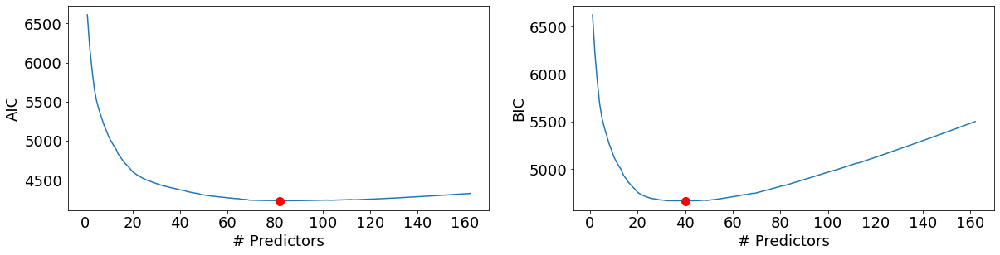

In [51]:
best_sub_plots()

**Optimal Number of Predictors**: 60

In [52]:
best_FORWARD_model = models_best.loc[60,'model']
models_best.loc[60,'model'].summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                 target   No. Observations:                10000
Model:                          Logit   Df Residuals:                     9939
Method:                           MLE   Df Model:                           60
Date:                Mon, 22 May 2023   Pseudo R-squ.:                  0.6348
Time:                        18:29:32   Log-Likelihood:                -2074.4
converged:                       True   LL-Null:                       -5680.8
Covariance Type:            nonrobust   LLR p-value:                     0.000
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      5.1039      0.652      7.833      0.000       3.827       6.381
P_2           -4.3706      0.315    -13.865      0.000      -4.988      -3.753
D_77          -2.9274      0.381     -7.686      0.000      -3.674      -2.181
B_11           1.7882      0.273      6.540      0.000       1.252       2.324
D_43           1.6778      0.277      6.063      0.000       1.135       2.220
D_41           3.0592      0.320      9.567      0.000       2.432       3.686
D_50          -4.2627      0.562     -7.587      0.000      -5.364      -3.162
R_27          -0.8368      0.110     -7.617      0.000      -1.052      -0.621
D_48           0.9707      0.217      4.473      0.000       0.545       1.396
R_12          -3.2039      0.358     -8.955      0.000      -3.905      -2.503
D_82           1.6905      0.200      8.471      0.000       1.299       2.082
D_56          -2.0891      0.390     -5.356      0.000      -2.854      -1.325
D_124          0.4058      0.227      1.790      0.073      -0.039       0.850
D_45          -2.0563      0.289     -7.108      0.000      -2.623      -1.489
D_75           0.8102      0.231      3.506      0.000       0.357       1.263
D_59          -1.5653      0.219     -7.145      0.000      -1.995      -1.136
B_36          26.6871      8.067      3.308      0.001      10.875      42.499
D_117         -0.1026      0.021     -4.871      0.000      -0.144      -0.061
S_11          -1.4308      0.268     -5.332      0.000      -1.957      -0.905
D_129         -0.6434      0.092     -6.961      0.000      -0.825      -0.462
R_3            1.9398      0.275      7.057      0.000       1.401       2.479
D_120         -0.5457      0.116     -4.685      0.000      -0.774      -0.317
R_21           3.1356      0.700      4.477      0.000       1.763       4.508
D_127         -1.7217      0.768     -2.241      0.025      -3.228      -0.216
B_16          -0.2281      0.239     -0.953      0.341      -0.697       0.241
D_69          -0.1598      0.072     -2.209      0.027      -0.302      -0.018
D_121          1.6859      0.262      6.443      0.000       1.173       2.199
D_143         -0.4267      0.109     -3.899      0.000      -0.641      -0.212
B_3            1.5147      0.279      5.435      0.000       0.969       2.061
B_19          -0.8261      0.203     -4.065      0.000      -1.224      -0.428
D_46           0.9633      0.304      3.173      0.002       0.368       1.558
D_113          0.7370      0.212      3.475      0.001       0.321       1.153
D_125         -0.4278      0.125     -3.418      0.001      -0.673      -0.182
S_20          -3.0259      0.806     -3.754      0.000      -4.606      -1.446
S_26          -0.8863      0.203     -4.358      0.000      -1.285      -0.488
D_39           0.4622      0.190      2.432      0.015       0.090       0.835
S_9            0.7424      0.219      3.386      0.001       0.313       1.172
B_6           -1.2446      0.441     -2.825      0.005      -2.108      -0.381
S_

#### Test/Train results

Classification accuracy = 89.1%
Precision = 72.8%
TPR or Recall = 91.2%
FNR = 8.8%
FPR = 11.7%
ROC-AUC = 96.4%


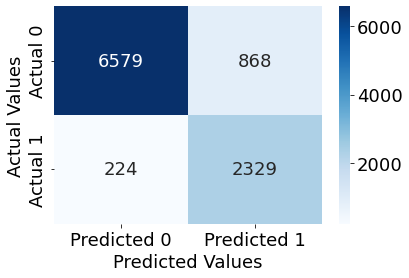

In [74]:
confusion_matrix_data(X_train, y_train, best_FORWARD_model, cutoff = 0.25)

Classification accuracy = 85.2%
Precision = 69.8%
TPR or Recall = 84.8%
FNR = 15.2%
FPR = 14.6%
ROC-AUC = 91.8%


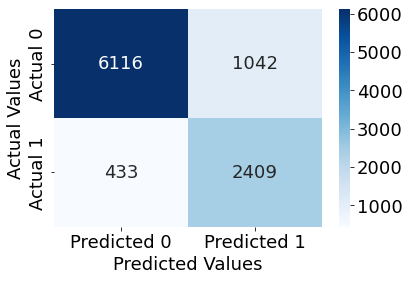

In [73]:
confusion_matrix_data(X_test, y_test, best_FORWARD_model, cutoff = 0.25)

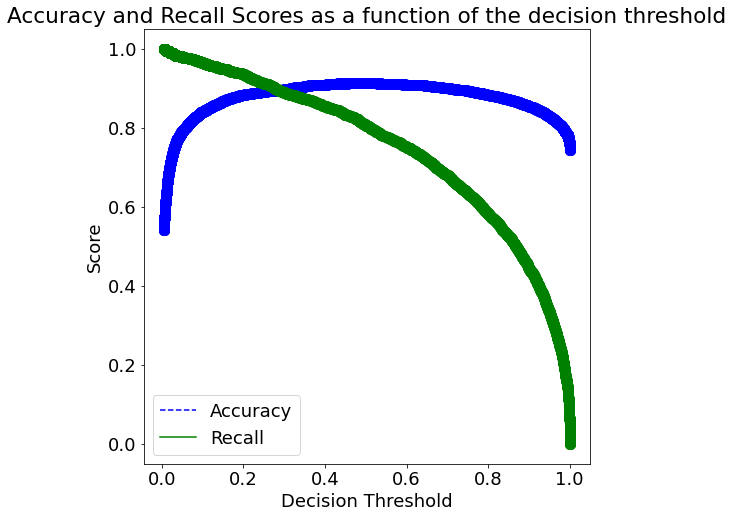

In [53]:
p, r, thresholds = precision_recall_curve(y_train, best_FORWARD_model.predict(X))

accuracy_scores = []

for thresh in thresholds:
    y_pred = best_FORWARD_model.predict(X) > thresh
    y_pred = y_pred.astype(int)
    
    accuracy = accuracy_score(y_pred, y_train)
    accuracy_scores.append(accuracy)

def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    plt.figure(figsize=(8, 8))
    plt.title("Accuracy and Recall Scores as a function of the decision threshold")
    plt.plot(thresholds, accuracy_scores, "b--", label="Accuracy")
    plt.plot(thresholds, recalls[:-1], "g-", label="Recall")
    plt.plot(thresholds, accuracy_scores, "o", color = 'blue')
    plt.plot(thresholds, recalls[:-1], "o", color = 'green')
    plt.ylabel("Score")
    plt.xlabel("Decision Threshold")
    plt.legend(loc='best')
    plt.legend()
plot_precision_recall_vs_threshold(p, r, thresholds)

**Optimal Threshold**: 0.3

### 5. 2 Backward Stepwise Selection

In [16]:
#Creating a dataframe with all the predictors
X = train[X_list_2]
#Since 'X' will change when we include interactions, we need a backup containing all individual predictors
X_backup = train[X_list_2]

In [26]:
def best_sub_plots():
    plt.figure(figsize=(20,10))
    plt.rcParams.update({'font.size': 18, 'lines.markersize': 10})

    # Set up a 2x2 grid so we can look at 4 plots at once
    plt.subplot(2, 2, 1)


    # We'll do the same for AIC and BIC, this time looking for the models with the SMALLEST statistic
    aic = models_best_backward.apply(lambda row: row[1].aic, axis=1)

    plt.subplot(2, 2, 1)
    plt.plot(aic)
    plt.plot(1+aic.argmin(), aic.min(), "or")
    plt.xlabel('# Predictors')
    plt.ylabel('AIC')

    bic = models_best_backward.apply(lambda row: row[1].bic, axis=1)

    plt.subplot(2, 2, 2)
    plt.plot(bic)
    plt.plot(1+bic.argmin(), bic.min(), "or")
    plt.xlabel('# Predictors')
    plt.ylabel('BIC')


In [17]:
def backward(predictors):
    
    tic = tm.time()
    
    results = []
    
    for combo in itertools.combinations(predictors, len(predictors)-1):
        results.append(processSubset(combo))
    
    # Wrap everything up in a nice dataframe
    models = pd.DataFrame(results)
    
    # Choose the model with the highest RSS
    best_model = models.loc[models['BIC'].argmin()]
    
    toc = tm.time()
    print("Processed ", models.shape[0], "models on", len(predictors)-1, "predictors in", (toc-tic), "seconds.")
    
    # Return the best model, along with some other useful information about the model
    return best_model

In [18]:
def backward_selection():
    models_best = pd.DataFrame(columns=["BIC", "model"], index = range(1,len(X.columns)))

    tic = tm.time()
    predictors = X.columns
    models_best.loc[len(predictors)] = processSubset(predictors)
    
    while(len(predictors) > 1):  
        models_best.loc[len(predictors)-1] = backward(predictors)
        predictors = models_best.loc[len(predictors)-1]["model"].params.index[1:]

    toc = tm.time()
    print("Total elapsed time:", (toc-tic), "seconds.")
    return models_best

In [22]:
models_best_backward = backward_selection()

Index(['P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43',
       'D_44',
       ...
       'D_130', 'D_131', 'D_133', 'R_28', 'D_139', 'D_140', 'D_141', 'D_143',
       'D_144', 'D_145'],
      dtype='object', length=162)
Optimization terminated successfully.
         Current function value: 0.200009
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17

Optimization terminated successfully.
         Current function value: 0.200263
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R

Optimization terminated successfully.
         Current function value: 0.201098
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R

Optimization terminated successfully.
         Current function value: 0.200046
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R

Optimization terminated successfully.
         Current function value: 0.200986
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R

Optimization terminated successfully.
         Current function value: 0.200010
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R

Optimization terminated successfully.
         Current function value: 0.200023
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R

Optimization terminated successfully.
         Current function value: 0.200038
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R

Optimization terminated successfully.
         Current function value: 0.200041
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200223
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200155
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200498
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200428
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.203373
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200441
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', '

Optimization terminated successfully.
         Current function value: 0.202068
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', '

Optimization terminated successfully.
         Current function value: 0.200108
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200638
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200279
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200094
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200011
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', '

Optimization terminated successfully.
         Current function value: 0.200010
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', '

Optimization terminated successfully.
         Current function value: 0.200839
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200429
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', '

Optimization terminated successfully.
         Current function value: 0.200076
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', '

Optimization terminated successfully.
         Current function value: 0.200451
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.201970
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'D_58', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', '

Optimization terminated successfully.
         Current function value: 0.206333
         Iterations 12
Processed  162 models on 161 predictors in 101.02596282958984 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_

Optimization terminated successfully.
         Current function value: 0.200263
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.201099
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200046
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200990
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200010
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200023
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200038
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D

Optimization terminated successfully.
         Current function value: 0.200041
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200223
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200155
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200499
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200429
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.203373
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200441
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', '

Optimization terminated successfully.
         Current function value: 0.202069
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', '

Optimization terminated successfully.
         Current function value: 0.200108
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200638
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200279
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200095
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200011
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', '

Optimization terminated successfully.
         Current function value: 0.200212
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200009
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', '

Optimization terminated successfully.
         Current function value: 0.202745
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', '

Optimization terminated successfully.
         Current function value: 0.200284
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.201113
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', '

Optimization terminated successfully.
         Current function value: 0.200126
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_75', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', '

Optimization terminated successfully.
         Current function value: 0.200212
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200371
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200059
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200242
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200046
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200022
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200120
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200034
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S

Optimization terminated successfully.
         Current function value: 0.200040
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200061
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200023
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200151
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200069
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200012
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200010
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200010
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200683
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200034
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', '

Optimization terminated successfully.
         Current function value: 0.200115
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200016
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200009
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200278
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', '

Optimization terminated successfully.
         Current function value: 0.201068
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200079
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200029
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200296
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200149
         Iterations 12
('P_2', 'D_39', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'B_11', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', '

Optimization terminated successfully.
         Current function value: 0.200029
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200047
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200158
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.201170
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200299
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.202371
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200012
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200045
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200209
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200780
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200043
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200453
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200803
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200072
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200164
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200156
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200018
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200052
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200033
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200446
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.201553
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200243
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200434
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200082
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200451
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.201972
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.206371
         Iterations 12
Processed  159 models on 158 predictors in 113.54317378997803 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_

Optimization terminated successfully.
         Current function value: 0.200266
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200497
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.201171
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200134
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.201342
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200038
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S

Optimization terminated successfully.
         Current function value: 0.200040
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200043
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200043
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200020
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200097
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200441
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200010
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200013
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200052
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200015
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200011
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200216
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200067
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200087
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200461
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200543
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S

Optimization terminated successfully.
         Current function value: 0.200076
         Iterations 12
('P_2', 'D_39', 'B_1', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'R_5', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200019
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200260
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200331
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200991
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200023
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200012
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', '

Optimization terminated successfully.
         Current function value: 0.200045
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200055
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200415
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200504
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200070
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200105
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200164
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200052
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200646
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200293
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200016
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.201554
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200843
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.200087
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.200030
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', '

Optimization terminated successfully.
         Current function value: 0.202221
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.200198
         Iterations 12
('D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'R_7', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.200267
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.200497
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.201175
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.200134
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.201342
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.200039
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200041
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200044
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200044
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200021
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200097
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200442
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25',

Optimization terminated successfully.
         Current function value: 0.200078
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200019
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200108
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200097
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200540
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200051
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200437
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25',

Optimization terminated successfully.
         Current function value: 0.200285
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200545
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200153
         Iterations 12
('P_2', 'D_39', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25',

Optimization terminated successfully.
         Current function value: 0.200314
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.201108
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.200246
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.200027
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.200124
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.201080
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 

Optimization terminated successfully.
         Current function value: 0.200045
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200066
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200069
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200457
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.201849
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200800
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.202073
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200015
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200053
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200016
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200013
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25',

Optimization terminated successfully.
         Current function value: 0.200285
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25',

Optimization terminated successfully.
         Current function value: 0.200045
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200085
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25',

Optimization terminated successfully.
         Current function value: 0.201146
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25',

Optimization terminated successfully.
         Current function value: 0.200078
         Iterations 12
('P_2', 'D_39', 'B_1', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_25', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25',

Optimization terminated successfully.
         Current function value: 0.200032
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200189
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200050
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200049
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.202395
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200053
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 

Optimization terminated successfully.
         Current function value: 0.200018
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200226
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200027
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200147
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200808
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200053
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.202076
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200016
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200055
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200017
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200027
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26',

Optimization terminated successfully.
         Current function value: 0.200286
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26',

Optimization terminated successfully.
         Current function value: 0.200046
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200086
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26',

Optimization terminated successfully.
         Current function value: 0.201148
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26',

Optimization terminated successfully.
         Current function value: 0.200080
         Iterations 12
('P_2', 'D_39', 'B_1', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_55', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26',

Optimization terminated successfully.
         Current function value: 0.200033
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200192
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200050
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200050
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.202396
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 

Optimization terminated successfully.
         Current function value: 0.200054
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200020
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200228
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200028
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200148
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200811
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200054
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.202078
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200017
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200056
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200019
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200029
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102'

Optimization terminated successfully.
         Current function value: 0.200054
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200452
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102'

Optimization terminated successfully.
         Current function value: 0.200289
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200556
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200155
         Iterations 12
('P_2', 'D_39', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_81', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102'

Optimization terminated successfully.
         Current function value: 0.200318
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.201109
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200254
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200032
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200128
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.201091
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.200050
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.200068
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.200073
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.200462
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.201855
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.200448
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103

Optimization terminated successfully.
         Current function value: 0.200162
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103

Optimization terminated successfully.
         Current function value: 0.200056
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.200291
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.200922
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.200040
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.200854
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103

Optimization terminated successfully.
         Current function value: 0.200096
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.200036
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103'

Optimization terminated successfully.
         Current function value: 0.202251
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103

Optimization terminated successfully.
         Current function value: 0.200206
         Iterations 12
('D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_103

Optimization terminated successfully.
         Current function value: 0.200279
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200503
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.201180
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200144
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200030
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200023
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200220
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200298
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200135
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200449
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200115
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200174
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200261
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200044
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104

Optimization terminated successfully.
         Current function value: 0.200209
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200458
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200025
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104

Optimization terminated successfully.
         Current function value: 0.200128
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104

Optimization terminated successfully.
         Current function value: 0.200136
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104

Optimization terminated successfully.
         Current function value: 0.200460
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104'

Optimization terminated successfully.
         Current function value: 0.200139
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_104

Optimization terminated successfully.
         Current function value: 0.200029
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200269
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200347
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.201002
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.200167
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102',

Optimization terminated successfully.
         Current function value: 0.201093
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200053
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200071
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200076
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200466
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.201862
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200451
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105

Optimization terminated successfully.
         Current function value: 0.200164
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105

Optimization terminated successfully.
         Current function value: 0.200059
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200295
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200925
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200043
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200857
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105

Optimization terminated successfully.
         Current function value: 0.200099
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200039
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.202268
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105

Optimization terminated successfully.
         Current function value: 0.200208
         Iterations 12
('D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_71', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105

Optimization terminated successfully.
         Current function value: 0.200284
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200511
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.201192
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200150
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105'

Optimization terminated successfully.
         Current function value: 0.200056
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_107'

Optimization terminated successfully.
         Current function value: 0.200058
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200071
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200427
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200521
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200087
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200085
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200033
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200702
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200065
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200028
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200039
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_10

Optimization terminated successfully.
         Current function value: 0.200063
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200466
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_10

Optimization terminated successfully.
         Current function value: 0.200297
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200569
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107

Optimization terminated successfully.
         Current function value: 0.200167
         Iterations 12
('P_2', 'D_39', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'R_8', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_10

Optimization terminated successfully.
         Current function value: 0.200339
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_10

Optimization terminated successfully.
         Current function value: 0.201122
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_10

Optimization terminated successfully.
         Current function value: 0.200264
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_10

Optimization terminated successfully.
         Current function value: 0.200043
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_10

Optimization terminated successfully.
         Current function value: 0.200139
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_10

Optimization terminated successfully.
         Current function value: 0.200051
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200461
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200799
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200044
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200080
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.203429
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200190
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200268
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200083
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200048
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.202473
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200309
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_

Optimization terminated successfully.
         Current function value: 0.200062
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200104
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_

Optimization terminated successfully.
         Current function value: 0.201163
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_

Optimization terminated successfully.
         Current function value: 0.200094
         Iterations 12
('P_2', 'D_39', 'B_1', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_23', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_

Optimization terminated successfully.
         Current function value: 0.200052
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200211
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200070
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200072
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.202428
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_3

Optimization terminated successfully.
         Current function value: 0.200060
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200465
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200803
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200049
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200086
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.203453
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200196
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200271
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200087
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200053
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.202474
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200319
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_

Optimization terminated successfully.
         Current function value: 0.200067
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200109
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_

Optimization terminated successfully.
         Current function value: 0.201168
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_

Optimization terminated successfully.
         Current function value: 0.200099
         Iterations 12
('P_2', 'D_39', 'B_1', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'D_65', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_

Optimization terminated successfully.
         Current function value: 0.200058
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200220
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200075
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.200078
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_3

Optimization terminated successfully.
         Current function value: 0.202440
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'R_2

Optimization terminated successfully.
         Current function value: 0.200065
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200467
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200808
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200055
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200092
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.203461
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200201
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200277
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200094
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200057
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200055
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_

Optimization terminated successfully.
         Current function value: 0.200086
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200485
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_

Optimization terminated successfully.
         Current function value: 0.200314
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200583
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200181
         Iterations 12
('P_2', 'D_39', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'B_12', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_

Optimization terminated successfully.
         Current function value: 0.200354
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.201132
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200282
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200060
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_2

Optimization terminated successfully.
         Current function value: 0.200155
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200068
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200241
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200319
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200159
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200467
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200141
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200051
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200724
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200086
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200130
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200578
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200898
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_

Optimization terminated successfully.
         Current function value: 0.200131
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200064
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.202307
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_

Optimization terminated successfully.
         Current function value: 0.200234
         Iterations 12
('D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'R_25', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_

Optimization terminated successfully.
         Current function value: 0.200310
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200540
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.201222
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200175
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_3

Optimization terminated successfully.
         Current function value: 0.200088
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_10

Optimization terminated successfully.
         Current function value: 0.200122
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200272
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200064
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200189
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200846
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200829
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200187
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_

Optimization terminated successfully.
         Current function value: 0.200709
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200355
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200252
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200258
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_

Optimization terminated successfully.
         Current function value: 0.200162
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_

Optimization terminated successfully.
         Current function value: 0.200170
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_

Optimization terminated successfully.
         Current function value: 0.200505
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200173
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'B_26', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_

Optimization terminated successfully.
         Current function value: 0.200067
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200314
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200387
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.201041
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200213
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.201195
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200484
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200835
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200076
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200110
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.203483
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200221
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200734
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200100
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200143
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200589
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200920
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B

Optimization terminated successfully.
         Current function value: 0.200144
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200078
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.202329
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B

Optimization terminated successfully.
         Current function value: 0.200252
         Iterations 12
('D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B

Optimization terminated successfully.
         Current function value: 0.200439
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200214
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200123
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_1

Optimization terminated successfully.
         Current function value: 0.200080
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_4

Optimization terminated successfully.
         Current function value: 0.200191
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_4

Optimization terminated successfully.
         Current function value: 0.200099
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200120
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200125
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200519
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.202030
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200498
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200186
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200091
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B

Optimization terminated successfully.
         Current function value: 0.200258
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.202515
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200114
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200519
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B

Optimization terminated successfully.
         Current function value: 0.200343
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200606
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200230
         Iterations 12
('P_2', 'D_39', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_70', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B

Optimization terminated successfully.
         Current function value: 0.200262
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200127
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200940
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.200369
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_

Optimization terminated successfully.
         Current function value: 0.201415
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_2

Optimization terminated successfully.
         Current function value: 0.200112
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200098
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200220
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200221
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200151
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200115
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200320
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S

Optimization terminated successfully.
         Current function value: 0.200686
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200187
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200515
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200362
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S

Optimization terminated successfully.
         Current function value: 0.200109
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200159
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S

Optimization terminated successfully.
         Current function value: 0.201228
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S

Optimization terminated successfully.
         Current function value: 0.200144
         Iterations 12
('P_2', 'D_39', 'B_1', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'D_84', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S

Optimization terminated successfully.
         Current function value: 0.200615
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.201175
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200338
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200103
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_

Optimization terminated successfully.
         Current function value: 0.200200
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200111
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200132
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200499
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200574
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200151
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200126
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200330
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D

Optimization terminated successfully.
         Current function value: 0.200692
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200197
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200521
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200373
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D

Optimization terminated successfully.
         Current function value: 0.200116
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D_

Optimization terminated successfully.
         Current function value: 0.200169
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D

Optimization terminated successfully.
         Current function value: 0.201237
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D

Optimization terminated successfully.
         Current function value: 0.200154
         Iterations 12
('P_2', 'D_39', 'B_1', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_109', 'B_40', 'S_27', 'D

Optimization terminated successfully.
         Current function value: 0.200628
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_1

Optimization terminated successfully.
         Current function value: 0.201186
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_1

Optimization terminated successfully.
         Current function value: 0.200350
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_1

Optimization terminated successfully.
         Current function value: 0.200116
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_1

Optimization terminated successfully.
         Current function value: 0.201438
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_1

Optimization terminated successfully.
         Current function value: 0.200136
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200122
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200247
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200243
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200883
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200875
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200146
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200126
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D

Optimization terminated successfully.
         Current function value: 0.200287
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.202568
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200146
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200554
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D

Optimization terminated successfully.
         Current function value: 0.200380
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200636
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200263
         Iterations 12
('P_2', 'D_39', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'R_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D

Optimization terminated successfully.
         Current function value: 0.200291
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200161
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200967
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_

Optimization terminated successfully.
         Current function value: 0.200408
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200150
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_

Optimization terminated successfully.
         Current function value: 0.200188
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200340
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200171
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200559
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200209
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200145
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200355
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200160
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200207
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200669
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200999
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', '

Optimization terminated successfully.
         Current function value: 0.200197
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200130
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.202389
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', '

Optimization terminated successfully.
         Current function value: 0.200314
         Iterations 12
('D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_47', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', '

Optimization terminated successfully.
         Current function value: 0.200510
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200264
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200185
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D

Optimization terminated successfully.
         Current function value: 0.200145
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200206
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200155
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200171
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200148
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200654
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200226
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.202260
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200174
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200447
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200557
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.201692
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 

Optimization terminated successfully.
         Current function value: 0.201423
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.203128
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 

Optimization terminated successfully.
         Current function value: 0.200620
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200250
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'B_14', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 

Optimization terminated successfully.
         Current function value: 0.200165
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200335
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200180
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', '

Optimization terminated successfully.
         Current function value: 0.200189
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', '

Optimization terminated successfully.
         Current function value: 0.200259
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 

Optimization terminated successfully.
         Current function value: 0.200171
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 

Optimization terminated successfully.
         Current function value: 0.200194
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 

Optimization terminated successfully.
         Current function value: 0.200556
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 

Optimization terminated successfully.
         Current function value: 0.200290
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 

Optimization terminated successfully.
         Current function value: 0.201196
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 

Optimization terminated successfully.
         Current function value: 0.200956
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 

Optimization terminated successfully.
         Current function value: 0.200189
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 

Optimization terminated successfully.
         Current function value: 0.200168
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117',

Optimization terminated successfully.
         Current function value: 0.200334
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 

Optimization terminated successfully.
         Current function value: 0.202615
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117',

Optimization terminated successfully.
         Current function value: 0.200380
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117',

Optimization terminated successfully.
         Current function value: 0.202928
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117',

Optimization terminated successfully.
         Current function value: 0.200784
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117', 

Optimization terminated successfully.
         Current function value: 0.202413
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117',

Optimization terminated successfully.
         Current function value: 0.200341
         Iterations 12
('D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_114', 'D_115', 'D_117',

Optimization terminated successfully.
         Current function value: 0.200537
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', '

Optimization terminated successfully.
         Current function value: 0.200286
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', '

Optimization terminated successfully.
         Current function value: 0.200216
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', '

Optimization terminated successfully.
         Current function value: 0.200301
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.201322
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200593
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200958
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200272
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200215
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200218
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200228
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200772
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200469
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200347
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200435
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118',

Optimization terminated successfully.
         Current function value: 0.200193
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200238
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118',

Optimization terminated successfully.
         Current function value: 0.200666
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200309
         Iterations 12
('P_2', 'D_39', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'B_40', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118',

Optimization terminated successfully.
         Current function value: 0.200351
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200675
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 

Optimization terminated successfully.
         Current function value: 0.200231
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_119', 

Optimization terminated successfully.
         Current function value: 0.200285
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200214
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200394
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200227
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200684
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200233
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200464
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119'

Optimization terminated successfully.
         Current function value: 0.200198
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119'

Optimization terminated successfully.
         Current function value: 0.200190
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200192
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200229
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200253
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200243
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119'

Optimization terminated successfully.
         Current function value: 0.203970
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_16', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119'

Optimization terminated successfully.
         Current function value: 0.200389
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200383
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200419
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119',

Optimization terminated successfully.
         Current function value: 0.200321
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.201342
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200392
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200603
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200308
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200275
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200340
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200231
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200521
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.202732
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120

Optimization terminated successfully.
         Current function value: 0.201157
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120

Optimization terminated successfully.
         Current function value: 0.200271
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200681
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200249
         Iterations 12
('P_2', 'D_39', 'B_1', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'R_18', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120

Optimization terminated successfully.
         Current function value: 0.200387
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200707
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120'

Optimization terminated successfully.
         Current function value: 0.200265
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_119', 'D_120', 'D_121'

Optimization terminated successfully.
         Current function value: 0.200315
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200247
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200430
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200259
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200261
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200240
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200277
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200263
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.201146
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200406
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_12

Optimization terminated successfully.
         Current function value: 0.200239
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200468
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.202481
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'B_13', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_12

Optimization terminated successfully.
         Current function value: 0.207236
         Iterations 12
Processed  132 models on 131 predictors in 58.9121470451355 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38',

Optimization terminated successfully.
         Current function value: 0.200496
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200262
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.200534
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200299
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200666
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200473
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200332
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200312
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200375
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200258
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200547
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.202779
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_1

Optimization terminated successfully.
         Current function value: 0.200298
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.203261
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_1

Optimization terminated successfully.
         Current function value: 0.201464
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_1

Optimization terminated successfully.
         Current function value: 0.200365
         Iterations 12
('P_2', 'D_39', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'R_23', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_1

Optimization terminated successfully.
         Current function value: 0.200631
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200367
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200296
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_12

Optimization terminated successfully.
         Current function value: 0.201554
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_12

Optimization terminated successfully.
         Current function value: 0.200314
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200285
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200734
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.201299
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200672
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200480
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200325
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200427
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200506
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_

Optimization terminated successfully.
         Current function value: 0.200322
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200315
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_

Optimization terminated successfully.
         Current function value: 0.200357
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_

Optimization terminated successfully.
         Current function value: 0.200493
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200760
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_12

Optimization terminated successfully.
         Current function value: 0.200330
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_12

Optimization terminated successfully.
         Current function value: 0.200375
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200310
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200314
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200379
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200334
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.201129
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200382
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200317
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.201146
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200311
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.203126
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_

Optimization terminated successfully.
         Current function value: 0.200733
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_

Optimization terminated successfully.
         Current function value: 0.204157
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'S_13', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_

Optimization terminated successfully.
         Current function value: 0.200803
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.200339
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_1

Optimization terminated successfully.
         Current function value: 0.201446
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_120', 'D_121', 'D_122', 'D_123', 'D_1

Optimization terminated successfully.
         Current function value: 0.202710
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.200321
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.200511
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.200340
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.200349
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.200327
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.200365
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.200334
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.201174
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.200335
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.203146
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D

Optimization terminated successfully.
         Current function value: 0.200757
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D

Optimization terminated successfully.
         Current function value: 0.204214
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_25', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D

Optimization terminated successfully.
         Current function value: 0.200826
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.200369
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_

Optimization terminated successfully.
         Current function value: 0.201453
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_

Optimization terminated successfully.
         Current function value: 0.202741
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.200362
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.200371
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.200426
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.200384
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.201186
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.200433
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.200395
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.200505
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.200580
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', '

Optimization terminated successfully.
         Current function value: 0.200397
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.200387
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', '

Optimization terminated successfully.
         Current function value: 0.200425
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'P_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', '

Optimization terminated successfully.
         Current function value: 0.200581
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', '

Optimization terminated successfully.
         Current function value: 0.200852
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', '

Optimization terminated successfully.
         Current function value: 0.200412
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', '

Optimization terminated successfully.
         Current function value: 0.200459
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 

Optimization terminated successfully.
         Current function value: 0.200410
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 

Optimization terminated successfully.
         Current function value: 0.200392
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 

Optimization terminated successfully.
         Current function value: 0.200815
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 

Optimization terminated successfully.
         Current function value: 0.201405
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 

Optimization terminated successfully.
         Current function value: 0.200769
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 

Optimization terminated successfully.
         Current function value: 0.200568
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 

Optimization terminated successfully.
         Current function value: 0.201076
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 

Optimization terminated successfully.
         Current function value: 0.200764
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 

Optimization terminated successfully.
         Current function value: 0.201285
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125',

Optimization terminated successfully.
         Current function value: 0.203401
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125',

Optimization terminated successfully.
         Current function value: 0.201596
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125',

Optimization terminated successfully.
         Current function value: 0.200509
         Iterations 12
('P_2', 'D_39', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'D_107', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125',

Optimization terminated successfully.
         Current function value: 0.200775
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', '

Optimization terminated successfully.
         Current function value: 0.200813
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_125', 'D_126', '

Optimization terminated successfully.
         Current function value: 0.201404
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', '

Optimization terminated successfully.
         Current function value: 0.200511
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', '

Optimization terminated successfully.
         Current function value: 0.200820
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 

Optimization terminated successfully.
         Current function value: 0.200827
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 

Optimization terminated successfully.
         Current function value: 0.200823
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 

Optimization terminated successfully.
         Current function value: 0.203816
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 

Optimization terminated successfully.
         Current function value: 0.202623
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 

Optimization terminated successfully.
         Current function value: 0.200976
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 

Optimization terminated successfully.
         Current function value: 0.200574
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 

Optimization terminated successfully.
         Current function value: 0.202003
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126',

Optimization terminated successfully.
         Current function value: 0.200489
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 

Optimization terminated successfully.
         Current function value: 0.200628
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 

Optimization terminated successfully.
         Current function value: 0.202643
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'R_24', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126',

Optimization terminated successfully.
         Current function value: 0.207893
         Iterations 12
Processed  125 models on 124 predictors in 59.681612968444824 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', '

Optimization terminated successfully.
         Current function value: 0.200587
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 

Optimization terminated successfully.
         Current function value: 0.200636
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 

Optimization terminated successfully.
         Current function value: 0.200568
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.200438
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.200472
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.200517
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.200492
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.201291
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.200516
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.200482
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.200602
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.200673
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127'

Optimization terminated successfully.
         Current function value: 0.200500
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.200917
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127',

Optimization terminated successfully.
         Current function value: 0.200453
         Iterations 12
('P_2', 'D_39', 'B_1', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'R_4', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127'

Optimization terminated successfully.
         Current function value: 0.201018
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127'

Optimization terminated successfully.
         Current function value: 0.200536
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_126', 'D_127', 'D_128'

Optimization terminated successfully.
         Current function value: 0.200482
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128'

Optimization terminated successfully.
         Current function value: 0.201714
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128'

Optimization terminated successfully.
         Current function value: 0.200863
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128

Optimization terminated successfully.
         Current function value: 0.200875
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128

Optimization terminated successfully.
         Current function value: 0.200849
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128

Optimization terminated successfully.
         Current function value: 0.203839
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128

Optimization terminated successfully.
         Current function value: 0.202674
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128

Optimization terminated successfully.
         Current function value: 0.201024
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128

Optimization terminated successfully.
         Current function value: 0.200622
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128

Optimization terminated successfully.
         Current function value: 0.202061
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_12

Optimization terminated successfully.
         Current function value: 0.200838
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_12

Optimization terminated successfully.
         Current function value: 0.201059
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128

Optimization terminated successfully.
         Current function value: 0.201862
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'R_2', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128

Optimization terminated successfully.
         Current function value: 0.200636
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_12

Optimization terminated successfully.
         Current function value: 0.201505
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_12

Optimization terminated successfully.
         Current function value: 0.201401
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_12

Optimization terminated successfully.
         Current function value: 0.200593
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.200482
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.200479
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.200913
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.201498
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.200870
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.200655
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.201188
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.200850
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.200510
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.200562
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_

Optimization terminated successfully.
         Current function value: 0.200796
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.200631
         Iterations 12
('D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_24', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_

Optimization terminated successfully.
         Current function value: 0.200732
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_1

Optimization terminated successfully.
         Current function value: 0.200505
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_4

Optimization terminated successfully.
         Current function value: 0.200763
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.201651
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.200531
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.200594
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.200569
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.201342
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.200578
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.200548
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.200659
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.201364
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B

Optimization terminated successfully.
         Current function value: 0.203504
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B

Optimization terminated successfully.
         Current function value: 0.200979
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.200676
         Iterations 12
('P_2', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_115', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_

Optimization terminated successfully.
         Current function value: 0.200533
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_4

Optimization terminated successfully.
         Current function value: 0.200783
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_13

Optimization terminated successfully.
         Current function value: 0.200808
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.201676
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200561
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200625
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200600
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.201375
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200612
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200562
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200694
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.201394
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_

Optimization terminated successfully.
         Current function value: 0.203545
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_

Optimization terminated successfully.
         Current function value: 0.201017
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200714
         Iterations 12
('P_2', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200764
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'D_1

Optimization terminated successfully.
         Current function value: 0.200573
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_13

Optimization terminated successfully.
         Current function value: 0.200700
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200615
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200565
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200993
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.201577
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200961
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200760
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.201296
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200948
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200600
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200663
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_

Optimization terminated successfully.
         Current function value: 0.200875
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_1

Optimization terminated successfully.
         Current function value: 0.200720
         Iterations 12
('D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_128', 'D_129', 'B_41', 'D_

Optimization terminated successfully.
         Current function value: 0.200743
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'B_41', 'D_130', 'R_28

Optimization terminated successfully.
         Current function value: 0.201641
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28

Optimization terminated successfully.
         Current function value: 0.202996
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.200598
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.200973
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.200678
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.200631
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.200708
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.200608
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.200671
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.201139
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.200677
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.200815
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.202015
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'B_33', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.200795
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_2

Optimization terminated successfully.
         Current function value: 0.201096
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_13

Optimization terminated successfully.
         Current function value: 0.200674
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_13

Optimization terminated successfully.
         Current function value: 0.201890
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_13

Optimization terminated successfully.
         Current function value: 0.200814
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_1

Optimization terminated successfully.
         Current function value: 0.200652
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_1

Optimization terminated successfully.
         Current function value: 0.201100
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_1

Optimization terminated successfully.
         Current function value: 0.200667
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_1

Optimization terminated successfully.
         Current function value: 0.200863
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_

Optimization terminated successfully.
         Current function value: 0.200673
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_1

Optimization terminated successfully.
         Current function value: 0.201649
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_1

Optimization terminated successfully.
         Current function value: 0.200837
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_1

Optimization terminated successfully.
         Current function value: 0.200678
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_1

Optimization terminated successfully.
         Current function value: 0.201076
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_1

Optimization terminated successfully.
         Current function value: 0.200683
         Iterations 12
('P_2', 'D_39', 'B_1', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_94', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_

Optimization terminated successfully.
         Current function value: 0.201214
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.200671
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_1

Optimization terminated successfully.
         Current function value: 0.200796
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.201062
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.200687
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.200704
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.201539
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.200723
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.200689
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.201017
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.200696
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.200758
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D

Optimization terminated successfully.
         Current function value: 0.200974
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_

Optimization terminated successfully.
         Current function value: 0.200812
         Iterations 12
('D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_10', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D

Optimization terminated successfully.
         Current function value: 0.200853
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_

Optimization terminated successfully.
         Current function value: 0.201858
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_

Optimization terminated successfully.
         Current function value: 0.201945
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_

Optimization terminated successfully.
         Current function value: 0.200920
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D

Optimization terminated successfully.
         Current function value: 0.201122
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D

Optimization terminated successfully.
         Current function value: 0.202589
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D

Optimization terminated successfully.
         Current function value: 0.202905
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D

Optimization terminated successfully.
         Current function value: 0.201285
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', '

Optimization terminated successfully.
         Current function value: 0.201715
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D

Optimization terminated successfully.
         Current function value: 0.200965
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', '

Optimization terminated successfully.
         Current function value: 0.203673
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', '

Optimization terminated successfully.
         Current function value: 0.200999
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_15', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D

Optimization terminated successfully.
         Current function value: 0.208453
         Iterations 12
Processed  115 models on 114 predictors in 43.86108088493347 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D

Optimization terminated successfully.
         Current function value: 0.201182
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D

Optimization terminated successfully.
         Current function value: 0.200752
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D

Optimization terminated successfully.
         Current function value: 0.200750
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', '

Optimization terminated successfully.
         Current function value: 0.201729
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', '

Optimization terminated successfully.
         Current function value: 0.200808
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', '

Optimization terminated successfully.
         Current function value: 0.200803
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', '

Optimization terminated successfully.
         Current function value: 0.200791
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', '

Optimization terminated successfully.
         Current function value: 0.200755
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', '

Optimization terminated successfully.
         Current function value: 0.201076
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', '

Optimization terminated successfully.
         Current function value: 0.202061
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', '

Optimization terminated successfully.
         Current function value: 0.200950
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', '

Optimization terminated successfully.
         Current function value: 0.205007
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'R_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 

Optimization terminated successfully.
         Current function value: 0.200969
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_140', 'D_141', 'D_145')


Optimization terminated successfully.
         Current function value: 0.200992
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')


Optimization terminated successfully.
         Current function value: 0.200913
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')

Optimization terminated successfully.
         Current function value: 0.200774
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')

Optimization terminated successfully.
         Current function value: 0.200879
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')

Optimization terminated successfully.
         Current function value: 0.200802
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')

Optimization terminated successfully.
         Current function value: 0.201140
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')

Optimization terminated successfully.
         Current function value: 0.201465
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')

Optimization terminated successfully.
         Current function value: 0.200798
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')

Optimization terminated successfully.
         Current function value: 0.202453
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145'

Optimization terminated successfully.
         Current function value: 0.203485
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145'

Optimization terminated successfully.
         Current function value: 0.201195
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')

Optimization terminated successfully.
         Current function value: 0.200937
         Iterations 12
('P_2', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_123', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')

Optimization terminated successfully.
         Current function value: 0.200941
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimizat

Optimization terminated successfully.
         Current function value: 0.200836
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimizat

Optimization terminated successfully.
         Current function value: 0.200898
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimizat

Optimization terminated successfully.
         Current function value: 0.200814
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimiza

Optimization terminated successfully.
         Current function value: 0.200905
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimiza

Optimization terminated successfully.
         Current function value: 0.204240
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimiza

Optimization terminated successfully.
         Current function value: 0.201011
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimiz

Optimization terminated successfully.
         Current function value: 0.200799
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimiza

Optimization terminated successfully.
         Current function value: 0.200949
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimiza

Optimization terminated successfully.
         Current function value: 0.200817
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimiza

Optimization terminated successfully.
         Current function value: 0.200807
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimiz

Optimization terminated successfully.
         Current function value: 0.202232
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'S_12', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimiza

Optimization terminated successfully.
         Current function value: 0.201039
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_140', 'D_141', 'D_145')
Optimization term

Optimization terminated successfully.
         Current function value: 0.201060
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization term

Optimization terminated successfully.
         Current function value: 0.200963
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization ter

Optimization terminated successfully.
         Current function value: 0.201232
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization ter

Optimization terminated successfully.
         Current function value: 0.200855
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization ter

Optimization terminated successfully.
         Current function value: 0.200880
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization ter

Optimization terminated successfully.
         Current function value: 0.201161
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization ter

Optimization terminated successfully.
         Current function value: 0.200855
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization ter

Optimization terminated successfully.
         Current function value: 0.200880
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization ter

Optimization terminated successfully.
         Current function value: 0.201047
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization ter

Optimization terminated successfully.
         Current function value: 0.200908
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization ter

Optimization terminated successfully.
         Current function value: 0.201354
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_31', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization ter

Optimization terminated successfully.
         Current function value: 0.208698
         Iterations 12
Processed  111 models on 110 predictors in 39.40225100517273 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41',

Optimization terminated successfully.
         Current function value: 0.201329
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated s

Optimization terminated successfully.
         Current function value: 0.201861
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated s

Optimization terminated successfully.
         Current function value: 0.201976
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.201187
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.201308
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.201753
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.201083
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.200937
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.202505
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated

Optimization terminated successfully.
         Current function value: 0.203618
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated

Optimization terminated successfully.
         Current function value: 0.201323
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.201066
         Iterations 12
('P_2', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'B_24', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated 

Optimization terminated successfully.
         Current function value: 0.201008
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfu

Optimization terminated successfully.
         Current function value: 0.200952
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfu

Optimization terminated successfully.
         Current function value: 0.201008
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfu

Optimization terminated successfully.
         Current function value: 0.200929
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successf

Optimization terminated successfully.
         Current function value: 0.200969
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successf

Optimization terminated successfully.
         Current function value: 0.200969
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successf

Optimization terminated successfully.
         Current function value: 0.200958
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successf

Optimization terminated successfully.
         Current function value: 0.201187
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successf

Optimization terminated successfully.
         Current function value: 0.201437
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successf

Optimization terminated successfully.
         Current function value: 0.201259
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated success

Optimization terminated successfully.
         Current function value: 0.201327
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated success

Optimization terminated successfully.
         Current function value: 0.200988
         Iterations 12
('P_2', 'D_39', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_102', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated success

Optimization terminated successfully.
         Current function value: 0.201159
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
   

Optimization terminated successfully.
         Current function value: 0.202111
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
    

Optimization terminated successfully.
         Current function value: 0.202194
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
    

Optimization terminated successfully.
         Current function value: 0.200974
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
   

Optimization terminated successfully.
         Current function value: 0.201017
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
   

Optimization terminated successfully.
         Current function value: 0.201018
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
   

Optimization terminated successfully.
         Current function value: 0.201008
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
   

Optimization terminated successfully.
         Current function value: 0.201232
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
   

Optimization terminated successfully.
         Current function value: 0.201467
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
   

Optimization terminated successfully.
         Current function value: 0.201312
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
  

Optimization terminated successfully.
         Current function value: 0.201371
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
  

Optimization terminated successfully.
         Current function value: 0.201030
         Iterations 12
('P_2', 'D_39', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_91', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
  

Optimization terminated successfully.
         Current function value: 0.201208
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Cu

Optimization terminated successfully.
         Current function value: 0.202148
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Cur

Optimization terminated successfully.
         Current function value: 0.202251
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Cur

Optimization terminated successfully.
         Current function value: 0.202073
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Cu

Optimization terminated successfully.
         Current function value: 0.201367
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Cu

Optimization terminated successfully.
         Current function value: 0.201047
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Cu

Optimization terminated successfully.
         Current function value: 0.201211
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Cu

Optimization terminated successfully.
         Current function value: 0.201074
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Cu

Optimization terminated successfully.
         Current function value: 0.202526
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         C

Optimization terminated successfully.
         Current function value: 0.203737
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         C

Optimization terminated successfully.
         Current function value: 0.201453
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Cu

Optimization terminated successfully.
         Current function value: 0.201183
         Iterations 12
('P_2', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_5', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Cu

Optimization terminated successfully.
         Current function value: 0.201137
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current fu

Optimization terminated successfully.
         Current function value: 0.201097
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current fu

Optimization terminated successfully.
         Current function value: 0.201303
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current f

Optimization terminated successfully.
         Current function value: 0.201352
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current f

Optimization terminated successfully.
         Current function value: 0.201483
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current f

Optimization terminated successfully.
         Current function value: 0.201947
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current f

Optimization terminated successfully.
         Current function value: 0.201749
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current f

Optimization terminated successfully.
         Current function value: 0.201225
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current f

Optimization terminated successfully.
         Current function value: 0.201232
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current 

Optimization terminated successfully.
         Current function value: 0.201081
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current f

Optimization terminated successfully.
         Current function value: 0.201521
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'D_89', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current f

Optimization terminated successfully.
         Current function value: 0.208834
         Iterations 12
Processed  106 models on 105 predictors in 33.29702711105347 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_1

Optimization terminated successfully.
         Current function value: 0.201549
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function v

Optimization terminated successfully.
         Current function value: 0.202054
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function v

Optimization terminated successfully.
         Current function value: 0.201151
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function 

Optimization terminated successfully.
         Current function value: 0.201125
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function 

Optimization terminated successfully.
         Current function value: 0.202039
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function 

Optimization terminated successfully.
         Current function value: 0.201221
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function 

Optimization terminated successfully.
         Current function value: 0.201669
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function

Optimization terminated successfully.
         Current function value: 0.202112
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function 

Optimization terminated successfully.
         Current function value: 0.202009
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function 

Optimization terminated successfully.
         Current function value: 0.201127
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function

Optimization terminated successfully.
         Current function value: 0.202497
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_19', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function 

Optimization terminated successfully.
         Current function value: 0.201377
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.

Optimization terminated successfully.
         Current function value: 0.201372
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.

Optimization terminated successfully.
         Current function value: 0.201292
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0

Optimization terminated successfully.
         Current function value: 0.201364
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0

Optimization terminated successfully.
         Current function value: 0.201228
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0

Optimization terminated successfully.
         Current function value: 0.201229
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0

Optimization terminated successfully.
         Current function value: 0.201213
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0

Optimization terminated successfully.
         Current function value: 0.201448
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0

Optimization terminated successfully.
         Current function value: 0.201676
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0

Optimization terminated successfully.
         Current function value: 0.203914
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 

Optimization terminated successfully.
         Current function value: 0.201581
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0

Optimization terminated successfully.
         Current function value: 0.201337
         Iterations 12
('P_2', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_96', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0

Optimization terminated successfully.
         Current function value: 0.201288
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203134
 

Optimization terminated successfully.
         Current function value: 0.201262
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201240
 

Optimization terminated successfully.
         Current function value: 0.201488
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202343


Optimization terminated successfully.
         Current function value: 0.201331
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201359


Optimization terminated successfully.
         Current function value: 0.202157
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206761


Optimization terminated successfully.
         Current function value: 0.201330
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203555


Optimization terminated successfully.
         Current function value: 0.201780
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201291

Optimization terminated successfully.
         Current function value: 0.202299
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201405


Optimization terminated successfully.
         Current function value: 0.202112
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202532


Optimization terminated successfully.
         Current function value: 0.201246
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201454

Optimization terminated successfully.
         Current function value: 0.202587
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'D_68', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205569


Optimization terminated successfully.
         Current function value: 0.201485
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201841
         

Optimization terminated successfully.
         Current function value: 0.201482
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201417
         

Optimization terminated successfully.
         Current function value: 0.201391
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203730
        

Optimization terminated successfully.
         Current function value: 0.201511
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202347
        

Optimization terminated successfully.
         Current function value: 0.201621
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201765
        

Optimization terminated successfully.
         Current function value: 0.201314
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202147
        

Optimization terminated successfully.
         Current function value: 0.201491
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201948
        

Optimization terminated successfully.
         Current function value: 0.201444
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201304
        

Optimization terminated successfully.
         Current function value: 0.201448
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201473
       

Optimization terminated successfully.
         Current function value: 0.201307
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204524
        

Optimization terminated successfully.
         Current function value: 0.201719
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_118', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201622
        

Optimization terminated successfully.
         Current function value: 0.208963
         Iterations 12
Processed  102 models on 101 predictors in 33.05734086036682 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141')
Optimization terminated succ

Optimization terminated successfully.
         Current function value: 0.201384
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201636
         Iteration

Optimization terminated successfully.
         Current function value: 0.201454
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203811
         Iteratio

Optimization terminated successfully.
         Current function value: 0.202408
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201724
         Iteratio

Optimization terminated successfully.
         Current function value: 0.201386
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201420
         Iteratio

Optimization terminated successfully.
         Current function value: 0.201673
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201451
         Iteratio

Optimization terminated successfully.
         Current function value: 0.201888
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201402
         Iterati

Optimization terminated successfully.
         Current function value: 0.201737
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203976
         Iteratio

Optimization terminated successfully.
         Current function value: 0.201683
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204058
         Iterati

Optimization terminated successfully.
         Current function value: 0.201743
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202597
         Iteratio

Optimization terminated successfully.
         Current function value: 0.201474
         Iterations 12
('D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_7', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.209071
         Iterati

Optimization terminated successfully.
         Current function value: 0.201790
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201454
         Iterations 12
('

Optimization terminated successfully.
         Current function value: 0.201541
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201503
         Iterations 12
(

Optimization terminated successfully.
         Current function value: 0.201641
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202467
         Iterations 12
(

Optimization terminated successfully.
         Current function value: 0.201900
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201448
         Iterations 12
(

Optimization terminated successfully.
         Current function value: 0.201767
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201738
         Iterations 12
(

Optimization terminated successfully.
         Current function value: 0.202006
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201949
         Iterations 12
(

Optimization terminated successfully.
         Current function value: 0.201569
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201806
         Iterations 12
(

Optimization terminated successfully.
         Current function value: 0.201459
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201780
         Iterations 12
(

Optimization terminated successfully.
         Current function value: 0.201812
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202627
         Iterations 12
(

Optimization terminated successfully.
         Current function value: 0.201541
         Iterations 12
('D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'S_17', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.209071
         Iterations 12


Optimization terminated successfully.
         Current function value: 0.201835
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201504
         Iterations 12
('P_2', 'D

Optimization terminated successfully.
         Current function value: 0.201599
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201558
         Iterations 12
('P_2', '

Optimization terminated successfully.
         Current function value: 0.201695
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202517
         Iterations 12
('P_2', '

Optimization terminated successfully.
         Current function value: 0.201963
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201500
         Iterations 12
('P_2', '

Optimization terminated successfully.
         Current function value: 0.201786
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201568
         Iterations 12
('P_2', '

Optimization terminated successfully.
         Current function value: 0.202004
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201508
         Iterations 12
('P_2', 

Optimization terminated successfully.
         Current function value: 0.201868
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204060
         Iterations 12
('P_2', '

Optimization terminated successfully.
         Current function value: 0.201846
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204212
         Iterations 12
('P_2', 

Optimization terminated successfully.
         Current function value: 0.202660
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'D_51', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201962
         Iterations 12
('P_2', 

Optimization terminated successfully.
         Current function value: 0.209144
         Iterations 12
Processed  99 models on 98 predictors in 30.264829874038696 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141')
Optimization terminated successfully.
         Curre

Optimization terminated successfully.
         Current function value: 0.201568
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201811
         Iterations 12
('P_2', 'D_39', 'B

Optimization terminated successfully.
         Current function value: 0.201629
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203970
         Iterations 12
('P_2', 'D_39', '

Optimization terminated successfully.
         Current function value: 0.202587
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201914
         Iterations 12
('P_2', 'D_39', '

Optimization terminated successfully.
         Current function value: 0.201570
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201597
         Iterations 12
('P_2', 'D_39', '

Optimization terminated successfully.
         Current function value: 0.201637
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203894
         Iterations 12
('P_2', 'D_39', '

Optimization terminated successfully.
         Current function value: 0.201571
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202345
         Iterations 12
('P_2', 'D_39', '

Optimization terminated successfully.
         Current function value: 0.204127
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202022
         Iterations 12
('P_2', 'D_39', 

Optimization terminated successfully.
         Current function value: 0.204286
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201584
         Iterations 12
('P_2', 'D_39', 

Optimization terminated successfully.
         Current function value: 0.201865
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'B_22', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203632
         Iterations 12
('P_2', 'D_39', '

Optimization terminated successfully.
         Current function value: 0.202052
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201819
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_

Optimization terminated successfully.
         Current function value: 0.201804
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201712
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_

Optimization terminated successfully.
         Current function value: 0.201662
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202765
         Iterations 12
('P_2', 'D_39', 'B_1', 'B

Optimization terminated successfully.
         Current function value: 0.201999
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201697
         Iterations 12
('P_2', 'D_39', 'B_1', 'B

Optimization terminated successfully.
         Current function value: 0.202471
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207173
         Iterations 12
('P_2', 'D_39', 'B_1', 'B

Optimization terminated successfully.
         Current function value: 0.201795
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201630
         Iterations 12
('P_2', 'D_39', 'B_1', '

Optimization terminated successfully.
         Current function value: 0.201647
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201756
         Iterations 12
('P_2', 'D_39', 'B_1', 'B

Optimization terminated successfully.
         Current function value: 0.201746
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201801
         Iterations 12
('P_2', 'D_39', 'B_1', '

Optimization terminated successfully.
         Current function value: 0.201632
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201768
         Iterations 12
('P_2', 'D_39', 'B_1', '

Optimization terminated successfully.
         Current function value: 0.206049
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'B_30', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201653
         Iterations 12
('P_2', 'D_39', 'B_1', '

Optimization terminated successfully.
         Current function value: 0.202075
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201872
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3

Optimization terminated successfully.
         Current function value: 0.202697
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201699
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3

Optimization terminated successfully.
         Current function value: 0.202725
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201669
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_

Optimization terminated successfully.
         Current function value: 0.202002
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201728
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_

Optimization terminated successfully.
         Current function value: 0.201658
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202483
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_

Optimization terminated successfully.
         Current function value: 0.202282
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202215
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_

Optimization terminated successfully.
         Current function value: 0.202636
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201809
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_

Optimization terminated successfully.
         Current function value: 0.202891
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201685
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_

Optimization terminated successfully.
         Current function value: 0.202069
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202753
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_

Optimization terminated successfully.
         Current function value: 0.201797
         Iterations 12
('D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_11', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.209241
         Iterations 12
Processed  96 models on 95 predi

Optimization terminated successfully.
         Current function value: 0.202084
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201749
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41

Optimization terminated successfully.
         Current function value: 0.201829
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201825
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.201942
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202776
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.201752
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201776
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.204166
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201930
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.202124
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201770
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.203155
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201880
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_

Optimization terminated successfully.
         Current function value: 0.204890
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201747
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_

Optimization terminated successfully.
         Current function value: 0.203244
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_22', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206313
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'D_41', 'B_

Optimization terminated successfully.
         Current function value: 0.202350
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202226
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3

Optimization terminated successfully.
         Current function value: 0.202756
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202849
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3'

Optimization terminated successfully.
         Current function value: 0.202024
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202885
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3

Optimization terminated successfully.
         Current function value: 0.202162
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.201887
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3

Optimization terminated successfully.
         Current function value: 0.202647
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202159
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3

Optimization terminated successfully.
         Current function value: 0.202367
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202330
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3

Optimization terminated successfully.
         Current function value: 0.201955
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202205
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3

Optimization terminated successfully.
         Current function value: 0.201836
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202183
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3

Optimization terminated successfully.
         Current function value: 0.202911
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'P_4', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202278
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_

Optimization terminated successfully.
         Current function value: 0.209350
         Iterations 12
Processed  94 models on 93 predictors in 26.55308699607849 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141')
Optimization terminated successfully.
         Current function value: 0.202047
         Ite

Optimization terminated successfully.
         Current function value: 0.201900
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202154
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43

Optimization terminated successfully.
         Current function value: 0.201990
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204393
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.202250
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202282
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.202737
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207406
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.202039
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202086
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.201908
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202893
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.202097
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202904
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_

Optimization terminated successfully.
         Current function value: 0.202482
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202261
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_4

Optimization terminated successfully.
         Current function value: 0.201939
         Iterations 12
('P_2', 'D_39', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_126', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202036
         Iterations 12
('P_2', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_

Optimization terminated successfully.
         Current function value: 0.202020
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204039
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44'

Optimization terminated successfully.
         Current function value: 0.202621
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202067
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44

Optimization terminated successfully.
         Current function value: 0.202172
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203039
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44

Optimization terminated successfully.
         Current function value: 0.201989
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202016
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44

Optimization terminated successfully.
         Current function value: 0.204486
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202151
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44

Optimization terminated successfully.
         Current function value: 0.202001
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202096
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44

Optimization terminated successfully.
         Current function value: 0.202096
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202250
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_4

Optimization terminated successfully.
         Current function value: 0.201971
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202135
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_4

Optimization terminated successfully.
         Current function value: 0.206526
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_8', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202069
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_

Optimization terminated successfully.
         Current function value: 0.202461
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202254
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4'

Optimization terminated successfully.
         Current function value: 0.202087
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203145
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4'

Optimization terminated successfully.
         Current function value: 0.202350
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202467
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4

Optimization terminated successfully.
         Current function value: 0.202353
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202520
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4

Optimization terminated successfully.
         Current function value: 0.202409
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202126
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4

Optimization terminated successfully.
         Current function value: 0.202918
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202464
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4

Optimization terminated successfully.
         Current function value: 0.202506
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203477
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4

Optimization terminated successfully.
         Current function value: 0.202063
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205284
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4

Optimization terminated successfully.
         Current function value: 0.203529
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'D_62', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206694
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_4

Optimization terminated successfully.
         Current function value: 0.202669
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202540
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45

Optimization terminated successfully.
         Current function value: 0.202165
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203226
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45'

Optimization terminated successfully.
         Current function value: 0.202567
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202330
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45

Optimization terminated successfully.
         Current function value: 0.202130
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202164
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45

Optimization terminated successfully.
         Current function value: 0.202273
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202235
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45

Optimization terminated successfully.
         Current function value: 0.203093
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203126
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45

Optimization terminated successfully.
         Current function value: 0.203446
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202147
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45

Optimization terminated successfully.
         Current function value: 0.202591
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'D_83', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202441
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5'

Optimization terminated successfully.
         Current function value: 0.202377
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202638
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5',

Optimization terminated successfully.
         Current function value: 0.202276
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203413
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5',

Optimization terminated successfully.
         Current function value: 0.202469
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203260
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5'

Optimization terminated successfully.
         Current function value: 0.202277
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202510
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5'

Optimization terminated successfully.
         Current function value: 0.202274
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205070
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5'

Optimization terminated successfully.
         Current function value: 0.202215
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202321
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5'

Optimization terminated successfully.
         Current function value: 0.202384
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203237
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5

Optimization terminated successfully.
         Current function value: 0.202650
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'R_6', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203875
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46

Optimization terminated successfully.
         Current function value: 0.210296
         Iterations 12
Processed  89 models on 88 predictors in 22.72439980506897 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141')
Optimization terminated successfully.
         Current function value: 0.202448
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2'

Optimization terminated successfully.
         Current function value: 0.202531
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202362
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46'

Optimization terminated successfully.
         Current function value: 0.203400
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202558
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46'

Optimization terminated successfully.
         Current function value: 0.202614
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202358
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46

Optimization terminated successfully.
         Current function value: 0.202638
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202346
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46

Optimization terminated successfully.
         Current function value: 0.202297
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202409
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46

Optimization terminated successfully.
         Current function value: 0.202462
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203340
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_4

Optimization terminated successfully.
         Current function value: 0.202731
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'B_9', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203962
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_4

Optimization terminated successfully.
         Current function value: 0.210402
         Iterations 12
Processed  88 models on 87 predictors in 21.237313985824585 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141')
Optimization terminated successfully.
         Current function value: 0.202529
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3

Optimization terminated successfully.
         Current function value: 0.202627
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202453
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48

Optimization terminated successfully.
         Current function value: 0.203482
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202661
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48

Optimization terminated successfully.
         Current function value: 0.202701
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202431
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_4

Optimization terminated successfully.
         Current function value: 0.202712
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202424
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_4

Optimization terminated successfully.
         Current function value: 0.202395
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202479
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_4

Optimization terminated successfully.
         Current function value: 0.202539
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'B_10', 'D_53', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203394
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_

Optimization terminated successfully.
         Current function value: 0.204069
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'B_10', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202826
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_

Optimization terminated successfully.
         Current function value: 0.202616
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202887
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6'

Optimization terminated successfully.
         Current function value: 0.202536
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203610
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6'

Optimization terminated successfully.
         Current function value: 0.202737
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203487
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6

Optimization terminated successfully.
         Current function value: 0.202505
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202721
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6

Optimization terminated successfully.
         Current function value: 0.202509
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205286
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6

Optimization terminated successfully.
         Current function value: 0.202555
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203403
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6

Optimization terminated successfully.
         Current function value: 0.203531
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203877
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6

Optimization terminated successfully.
         Current function value: 0.202767
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_13', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204372
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_5

Optimization terminated successfully.
         Current function value: 0.202785
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203068
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50'

Optimization terminated successfully.
         Current function value: 0.203435
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202562
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50'

Optimization terminated successfully.
         Current function value: 0.202812
         Iterations 11
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202939
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50

Optimization terminated successfully.
         Current function value: 0.203028
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203279
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50

Optimization terminated successfully.
         Current function value: 0.202665
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202697
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50

Optimization terminated successfully.
         Current function value: 0.202668
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202912
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50

Optimization terminated successfully.
         Current function value: 0.205612
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205833
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'D_50', 'R_3

Optimization terminated successfully.
         Current function value: 0.207243
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_119', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202644
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_

Optimization terminated successfully.
         Current function value: 0.202830
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202677
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3',

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202712
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B

Optimization terminated successfully.
         Current function value: 0.202968
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203003
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3',

Optimization terminated successfully.
         Current function value: 0.202665
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203390
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3',

Optimization terminated successfully.
         Current function value: 0.203171
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203531
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3',

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202748
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 

Optimization terminated successfully.
         Current function value: 0.203022
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203097
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52'

('D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'B_27', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.211025
         Iterations 12
Processed  84 models on 83 predictors in 18.49338722229004 seconds.
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S

Optimization terminated successfully.
         Current function value: 0.203004
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202911
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 

Optimization terminated successfully.
         Current function value: 0.203852
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202998
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 

Optimization terminated successfully.
         Current function value: 0.203075
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202788
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52',

Optimization terminated successfully.
         Current function value: 0.205534
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202876
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52',

Optimization terminated successfully.
         Current function value: 0.203694
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203701
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52',

Optimization terminated successfully.
         Current function value: 0.204084
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203033
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'D_52', 'D_53'

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'B_41', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204261
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', '

Optimization terminated successfully.
         Current function value: 0.203431
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203207
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53',

Optimization terminated successfully.
         Current function value: 0.203438
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.202940
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53',

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203201
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B

Optimization terminated successfully.
         Current function value: 0.203615
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203218
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53',

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203288
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_19', 'B

Optimization terminated successfully.
         Current function value: 0.203146
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203001
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53',

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_122', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203303
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', '

Optimization terminated successfully.
         Current function value: 0.203144
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203497
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D

Optimization terminated successfully.
         Current function value: 0.204717
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203658
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D

Optimization terminated successfully.
         Current function value: 0.203161
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203998
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', '

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206400
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203858
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_20', 'B_

Optimization terminated successfully.
         Current function value: 0.203091
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203260
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 

Optimization terminated successfully.
         Current function value: 0.204657
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_78', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203418
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203620
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_2

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203764
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_2

Optimization terminated successfully.
         Current function value: 0.204129
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203437
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', '

Optimization terminated successfully.
         Current function value: 0.203858
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203452
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', '

Optimization terminated successfully.
         Current function value: 0.203158
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203212
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', '

Optimization terminated successfully.
         Current function value: 0.204168
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204334
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_54', 'S_7', 'S

Optimization terminated successfully.
         Current function value: 0.204988
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'B_37', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204651
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', '

Optimization terminated successfully.
         Current function value: 0.203588
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203417
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_

Optimization terminated successfully.
         Current function value: 0.205964
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205723
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S

('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203294
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_

Optimization terminated successfully.
         Current function value: 0.203311
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203390
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S

Optimization terminated successfully.
         Current function value: 0.206233
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203700
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', '

Optimization terminated successfully.
         Current function value: 0.203763
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203587
         Iterations 12
('P_2', 'D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D

Optimization terminated successfully.
         Current function value: 0.203364
         Iterations 12
('D_39', 'B_1', 'B_2', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.211328
         Iterations 12
Processed  79 models on 78 predictors in 18.744827032089233 seconds.
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48',

Optimization terminated successfully.
         Current function value: 0.205089
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204248
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S

Optimization terminated successfully.
         Current function value: 0.203567
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204362
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', '

Optimization terminated successfully.
         Current function value: 0.206656
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204081
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', '

Optimization terminated successfully.
         Current function value: 0.203889
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204010
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', '

Optimization terminated successfully.
         Current function value: 0.203478
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204469
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', '

Optimization terminated successfully.
         Current function value: 0.203683
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_18', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205237
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', '

('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203705
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B

Optimization terminated successfully.
         Current function value: 0.206219
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205903
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D

Optimization terminated successfully.
         Current function value: 0.203759
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203763
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D

Optimization terminated successfully.
         Current function value: 0.203616
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204161
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D

Optimization terminated successfully.
         Current function value: 0.206518
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204005
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'S_9', 'D_59', '

Optimization terminated successfully.
         Current function value: 0.204031
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'B_38', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203906
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', '

Optimization terminated successfully.
         Current function value: 0.211627
         Iterations 12
Processed  77 models on 76 predictors in 17.64343810081482 seconds.
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141')
Optimization terminated successfully.
         Current function value: 0.203849
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_

Optimization terminated successfully.
         Current function value: 0.204495
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205333
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_

Optimization terminated successfully.
         Current function value: 0.203942
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203967
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D

Optimization terminated successfully.
         Current function value: 0.203990
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206637
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D

Optimization terminated successfully.
         Current function value: 0.204648
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204775
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D

Optimization terminated successfully.
         Current function value: 0.203911
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206705
         Iterations 12
('P_2', 'D_39', 'B_1', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', '

Optimization terminated successfully.
         Current function value: 0.208200
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203671
         Iterations 12
('P_2', 'D_39', 'S_3', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 

Optimization terminated successfully.
         Current function value: 0.204135
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203999
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', '

Optimization terminated successfully.
         Current function value: 0.204178
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.203945
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 

Optimization terminated successfully.
         Current function value: 0.207375
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204483
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 

Optimization terminated successfully.
         Current function value: 0.204565
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204362
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 

Optimization terminated successfully.
         Current function value: 0.203934
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205074
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15',

Optimization terminated successfully.
         Current function value: 0.204051
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'B_23', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205634
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15',

('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206038
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 

Optimization terminated successfully.
         Current function value: 0.204870
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204124
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 

Optimization terminated successfully.
         Current function value: 0.209199
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207430
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 

Optimization terminated successfully.
         Current function value: 0.204637
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204486
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 

Optimization terminated successfully.
         Current function value: 0.205364
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205177
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 

Optimization terminated successfully.
         Current function value: 0.205808
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_17', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205612
         Iterations 13
('P_2', 'D_39', 'B_1', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11',

Optimization terminated successfully.
         Current function value: 0.206193
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204392
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', '

Optimization terminated successfully.
         Current function value: 0.204233
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204463
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 

('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207524
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_82', 'R_12',

Optimization terminated successfully.
         Current function value: 0.204498
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205060
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'S_11', 'B_18', 

Optimization terminated successfully.
         Current function value: 0.205291
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204275
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18',

Optimization terminated successfully.
         Current function value: 0.205678
         Iterations 13
('P_2', 'D_39', 'B_1', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.208759
         Iterations 12
('P_2', 'D_39', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'S_8', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18',

Optimization terminated successfully.
         Current function value: 0.204399
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204360
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19',

Optimization terminated successfully.
         Current function value: 0.204333
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205181
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19'

Optimization terminated successfully.
         Current function value: 0.204486
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204492
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19'

Optimization terminated successfully.
         Current function value: 0.204704
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207252
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20

Optimization terminated successfully.
         Current function value: 0.204594
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'S_15', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205799
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20

Optimization terminated successfully.
         Current function value: 0.204453
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204424
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20',

Optimization terminated successfully.
         Current function value: 0.205131
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204390
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20'

Optimization terminated successfully.
         Current function value: 0.207723
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204853
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20'

Optimization terminated successfully.
         Current function value: 0.204269
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204726
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21'

Optimization terminated successfully.
         Current function value: 0.204833
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_17', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204580
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21

Optimization terminated successfully.
         Current function value: 0.204936
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204554
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21',

Optimization terminated successfully.
         Current function value: 0.204470
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207078
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21'

Optimization terminated successfully.
         Current function value: 0.204800
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'R_14', 'R_16', 'D_86', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205024
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21'

Optimization terminated successfully.
         Current function value: 0.204817
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205488
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69'

Optimization terminated successfully.
         Current function value: 0.207686
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'B_32', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204670
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69

Optimization terminated successfully.
         Current function value: 0.212673
         Iterations 13
Processed  70 models on 69 predictors in 14.522432088851929 seconds.
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141')
Optimization terminated successfully.
         Current function value: 0.204779
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D

Optimization terminated successfully.
         Current function value: 0.205190
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204645
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69'

Optimization terminated successfully.
         Current function value: 0.204805
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204977
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69'

Optimization terminated successfully.
         Current function value: 0.205785
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205419
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72'

Optimization terminated successfully.
         Current function value: 0.205611
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.204794
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72

('P_2', 'D_39', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207480
         Iterations 13
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'D_61', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_2

Optimization terminated successfully.
         Current function value: 0.204963
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206360
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74',

Optimization terminated successfully.
         Current function value: 0.205032
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205017
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74'

Optimization terminated successfully.
         Current function value: 0.205357
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205121
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'D_69', 'D_72', 'D_74', 'D_77'

Optimization terminated successfully.
         Current function value: 0.204893
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205964
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77

Optimization terminated successfully.
         Current function value: 0.206547
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'S_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206229
         Iterations 13
('P_2', 'D_39', 'B_1', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77

Optimization terminated successfully.
         Current function value: 0.205342
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205205
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77',

Optimization terminated successfully.
         Current function value: 0.205927
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205248
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77'

Optimization terminated successfully.
         Current function value: 0.205088
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205582
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_74', 'D_77', 'D_79'

Optimization terminated successfully.
         Current function value: 0.205117
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206207
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79

Optimization terminated successfully.
         Current function value: 0.206839
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206546
         Iterations 13
('P_2', 'D_39', 'B_1', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_74', 'D_77', 'D_79

Optimization terminated successfully.
         Current function value: 0.205466
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205402
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16',

Optimization terminated successfully.
         Current function value: 0.205481
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.205454
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16'

Optimization terminated successfully.
         Current function value: 0.205739
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206386
         Iterations 13
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80'

Optimization terminated successfully.
         Current function value: 0.205509
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.208169
         Iterations 12
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80

Optimization terminated successfully.
         Current function value: 0.205376
         Iterations 12
('D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'D_93', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.214113
         Iterations 13
Processed  66 models on 65 predictors in 12.237859964370728 seconds.
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 

Optimization terminated successfully.
         Current function value: 0.206040
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'S_26', 'D_105', 'B_36', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.208308
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80'

Optimization terminated successfully.
         Current function value: 0.210595
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.208850
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_82'

Optimization terminated successfully.
         Current function value: 0.205719
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.208352
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82

('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207129
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'R_22', 'D_92', 'S_26', 'D_105', 'B_

Optimization terminated successfully.
         Current function value: 0.205981
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.208093
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82',

Optimization terminated successfully.
         Current function value: 0.206027
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206014
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82'

Optimization terminated successfully.
         Current function value: 0.206940
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206631
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12'

Optimization terminated successfully.
         Current function value: 0.208713
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.209216
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_7', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12

Optimization terminated successfully.
         Current function value: 0.215192
         Iterations 11
Processed  64 models on 63 predictors in 12.38872480392456 seconds.
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141')
Optimization terminated successfully.
         Current function value: 0.206219
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', '

Optimization terminated successfully.
         Current function value: 0.206693
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.208819
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_2

Optimization terminated successfully.
         Current function value: 0.206778
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206364
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_1

Optimization terminated successfully.
         Current function value: 0.206472
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207346
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_1

Optimization terminated successfully.
         Current function value: 0.206785
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_140', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207996
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_

Optimization terminated successfully.
         Current function value: 0.206538
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207908
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14'

Optimization terminated successfully.
         Current function value: 0.206562
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206670
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'R_14', 'R_16

Optimization terminated successfully.
         Current function value: 0.206926
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207453
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16

Optimization terminated successfully.
         Current function value: 0.207688
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206543
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_54', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_1

Optimization terminated successfully.
         Current function value: 0.206825
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'R_28', 'D_139', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206810
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86'

('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207540
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124'

Optimization terminated successfully.
         Current function value: 0.207129
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.207922
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20

Optimization terminated successfully.
         Current function value: 0.210228
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141', 'D_145')
Optimization terminated successfully.
         Current function value: 0.206958
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_2

Optimization terminated successfully.
         Current function value: 0.207347
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_141')
Optimization terminated successfully.
         Current function value: 0.207428
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20',

Optimization terminated successfully.
         Current function value: 0.207297
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.207850
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20'

Optimization terminated successfully.
         Current function value: 0.207430
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.208221
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20'

Optimization terminated successfully.
         Current function value: 0.208223
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'D_105', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.207171
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20

Optimization terminated successfully.
         Current function value: 0.207475
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.209300
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 

Optimization terminated successfully.
         Current function value: 0.207426
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.207491
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21',

Optimization terminated successfully.
         Current function value: 0.207782
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.208363
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21',

Optimization terminated successfully.
         Current function value: 0.207702
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.208820
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'R_16', 'D_86', 'S_20', 'R_20', 'R_21'

Optimization terminated successfully.
         Current function value: 0.207810
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.207820
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 

Optimization terminated successfully.
         Current function value: 0.213231
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211455
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26',

Optimization terminated successfully.
         Current function value: 0.207983
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.208787
         Iterations 11
('P_2', 'D_39', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26'

Optimization terminated successfully.
         Current function value: 0.213404
         Iterations 11
('P_2', 'D_39', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.210257
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26'

Optimization terminated successfully.
         Current function value: 0.208458
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.210574
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'R_27',

Optimization terminated successfully.
         Current function value: 0.211443
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.208506
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27',

Optimization terminated successfully.
         Current function value: 0.210452
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211487
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'S_20', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27'

Optimization terminated successfully.
         Current function value: 0.208432
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.208463
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113',

Optimization terminated successfully.
         Current function value: 0.208508
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.208525
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117

Optimization terminated successfully.
         Current function value: 0.209294
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.208395
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117

Optimization terminated successfully.
         Current function value: 0.208726
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.208990
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'D_60', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117

Optimization terminated successfully.
         Current function value: 0.209513
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.210397
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121

Optimization terminated successfully.
         Current function value: 0.208937
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.212270
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_1

Optimization terminated successfully.
         Current function value: 0.211089
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.212049
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'D_50', 'R_3', 'D_52', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_

Optimization terminated successfully.
         Current function value: 0.209129
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.209128
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_1

Optimization terminated successfully.
         Current function value: 0.209269
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.209247
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D

Optimization terminated successfully.
         Current function value: 0.210360
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211466
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', '

Optimization terminated successfully.
         Current function value: 0.210615
         Iterations 11
('P_2', 'B_1', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.216163
         Iterations 11
('P_2', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_20', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', '

Optimization terminated successfully.
         Current function value: 0.211887
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_21', 'D_92', 'S_26', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211545
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_21', 'D_92', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 

Optimization terminated successfully.
         Current function value: 0.209939
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.210218
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 

Optimization terminated successfully.
         Current function value: 0.211137
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.209720
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_14', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127',

Optimization terminated successfully.
         Current function value: 0.210937
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.210298
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 

Optimization terminated successfully.
         Current function value: 0.213846
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.209956
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130'

Optimization terminated successfully.
         Current function value: 0.209716
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'R_28', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.210911
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130'

Optimization terminated successfully.
         Current function value: 0.210210
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_127', 'D_129', 'D_130', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.210121
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_130', 'D_139', 

Optimization terminated successfully.
         Current function value: 0.210157
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.214205
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'D_139

Optimization terminated successfully.
         Current function value: 0.211255
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.210004
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_130', 'D_13

Optimization terminated successfully.
         Current function value: 0.210886
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.212039
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimiza

Optimization terminated successfully.
         Current function value: 0.210646
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.210829
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimi

Optimization terminated successfully.
         Current function value: 0.210628
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211950
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_79', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optim

Optimization terminated successfully.
         Current function value: 0.212261
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211103
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated

Optimization terminated successfully.
         Current function value: 0.211480
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211540
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminate

Optimization terminated successfully.
         Current function value: 0.211225
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.212107
         Iterations 11
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_46', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminat

Optimization terminated successfully.
         Current function value: 0.212986
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211456
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.


Optimization terminated successfully.
         Current function value: 0.213209
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211221
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'B_6', 'D_50', 'R_3', 'D_53', 'S_6', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.

Optimization terminated successfully.
         Current function value: 0.211763
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211850
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_139', 'D_141')
Optimization terminated successfully.
         Current

Optimization terminated successfully.
         Current function value: 0.215225
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211763
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Curre

Optimization terminated successfully.
         Current function value: 0.212745
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.211642
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_124', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Curr

Optimization terminated successfully.
         Current function value: 0.213085
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.214380
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value:

Optimization terminated successfully.
         Current function value: 0.212483
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.212407
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value:

Optimization terminated successfully.
         Current function value: 0.216192
         Iterations 11
('B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'D_92', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.222006
         Iterations 11
Processed  46 models on 45 predictors in 20.307159900665283 seconds.
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139')
Optimizat

Optimization terminated successfully.
         Current function value: 0.216174
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.212639
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.212679
      

Optimization terminated successfully.
         Current function value: 0.215480
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'B_5', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.213713
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.212330
     

Optimization terminated successfully.
         Current function value: 0.214490
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'S_26', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.214183
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'S_26', 'B_36', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.215343
         Iterations 1

Optimization terminated successfully.
         Current function value: 0.213491
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.214932
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'D_86', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.212888
         Iterations

Optimization terminated successfully.
         Current function value: 0.213484
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.213457
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.216764
         Iterations 11
('P_2', 'B_1', '

Optimization terminated successfully.
         Current function value: 0.214124
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'S_11', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.213802
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'S_9', 'D_59', 'B_15', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.213813
         Iterations 11
('P_2', 'B_1'

Optimization terminated successfully.
         Current function value: 0.214219
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_141')
Optimization terminated successfully.
         Current function value: 0.214307
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.215370
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3',

Optimization terminated successfully.
         Current function value: 0.214094
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.214293
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.214746
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3

Optimization terminated successfully.
         Current function value: 0.218373
         Iterations 11
('B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_125', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.224701
         Iterations 11
Processed  42 models on 41 predictors in 4.604341983795166 seconds.
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_127', 'D_129', 'D_139')
Optimization terminated successfully.
         Current function value: 

Optimization terminated successfully.
         Current function value: 0.214881
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.215253
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_127', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.215291
         Iterations 11
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44',

Optimization terminated successfully.
         Current function value: 0.215513
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_141')
Optimization terminated successfully.
         Current function value: 0.215600
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.216630
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48',

Optimization terminated successfully.
         Current function value: 0.215874
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.215935
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_19', 'B_20', 'B_21', 'D_69', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.215696
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48

Optimization terminated successfully.
         Current function value: 0.216216
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.217364
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.218641
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 

Optimization terminated successfully.
         Current function value: 0.216491
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.217969
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.216763
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'B_4', 'D_45', 'D_48', 'D_50', 'R_3'

Optimization terminated successfully.
         Current function value: 0.217080
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.218283
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.217153
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56'

Optimization terminated successfully.
         Current function value: 0.216867
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.217247
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'B_28', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.218483
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'R_3', 'D_53', 'S_6', 'D_56', 'D_

Optimization terminated successfully.
         Current function value: 0.217132
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.222073
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'R_12', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.220566
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_1

Optimization terminated successfully.
         Current function value: 0.218897
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.218177
         Iterations 9
('P_2', 'B_1', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.224018
         Iterations 9
('P_2', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'B_15', 'S

Optimization terminated successfully.
         Current function value: 0.217610
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.217952
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_80', 'D_82', 'R_12', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.218070
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_19', 'B_2

Optimization terminated successfully.
         Current function value: 0.220242
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.218508
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.219602
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21'

Optimization terminated successfully.
         Current function value: 0.221234
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.219033
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'R_21', 'S_26', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.219987
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_7

Optimization terminated successfully.
         Current function value: 0.222793
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_77', 'S_16', 'D_82', 'R_12', 'R_21', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.218641
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'R_21', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.218687
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_21', 'D_72', 'D_77', 'S_1

Optimization terminated successfully.
         Current function value: 0.221457
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.219895
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.220828
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_82'

Optimization terminated successfully.
         Current function value: 0.219946
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.221332
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.220290
         Iterations 9
('P_2', 'B_1', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'S_16', 'D_82', 'R_

Optimization terminated successfully.
         Current function value: 0.221632
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.220773
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.219877
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'B_21', 'D_72', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_

Optimization terminated successfully.
         Current function value: 0.223392
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_72', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.224363
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.220051
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'D_72', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', '

Optimization terminated successfully.
         Current function value: 0.222734
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.221274
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.222349
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', '

Optimization terminated successfully.
         Current function value: 0.225932
         Iterations 9
('B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_53', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.230422
         Iterations 9
Processed  30 models on 29 predictors in 4.195613861083984 seconds.
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139')
Optimization terminated successfully.
         Current function value: 0.221502
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 

Optimization terminated successfully.
         Current function value: 0.222239
         Iterations 9
('P_2', 'B_1', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.228857
         Iterations 9
('P_2', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.226386
         Iterations 9
('B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_113', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimizatio

Optimization terminated successfully.
         Current function value: 0.223974
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.223098
         Iterations 9
('P_2', 'B_1', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.230189
         Iterations 9
('P_2', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'S_6', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.


Optimization terminated successfully.
         Current function value: 0.224883
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.224016
         Iterations 9
('P_2', 'B_1', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current function value: 0.230864
         Iterations 9
('P_2', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139', 'D_141')
Optimization terminated successfully.
         Current func

Optimization terminated successfully.
         Current function value: 0.224836
         Iterations 9
('P_2', 'B_1', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139')
Optimization terminated successfully.
         Current function value: 0.231687
         Iterations 9
('P_2', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139')
Optimization terminated successfully.
         Current function value: 0.229537
         Iterations 9
('B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_120', 'D_121', 'D_129', 'D_139')
Optimization terminated successfully.
         Current function value: 0.236545
      

Optimization terminated successfully.
         Current function value: 0.236986
         Iterations 9
Processed  25 models on 24 predictors in 4.344772815704346 seconds.
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_121')
Optimization terminated successfully.
         Current function value: 0.227511
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_129')
Optimization terminated successfully.
         Current function value: 0.228116
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_19', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.2273

Optimization terminated successfully.
         Current function value: 0.231455
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_20', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.231359
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.228162
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.227998
         Iterations 9
('P_2', 'B_1', 'D_41', 'B_3', 'D_43', 'D_44', 'D_45', 'D_48', 'D

Optimization terminated successfully.
         Current function value: 0.228898
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.230450
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.228960
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'B_18', 'B_20', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.229524
         Iterations 9
('P_2', 'B_1', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11',

Optimization terminated successfully.
         Current function value: 0.231224
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'D_77', 'D_82', 'B_36', 'R_27', 'D_117', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.233743
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'D_77', 'R_12', 'B_36', 'R_27', 'D_117', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.233611
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'S_11', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.233502
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_56', 'D_59', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117'

Optimization terminated successfully.
         Current function value: 0.241743
         Iterations 9
('B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_59', 'S_11', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117', 'D_121', 'D_129')
Optimization terminated successfully.
         Current function value: 0.242936
         Iterations 9
Processed  19 models on 18 predictors in 2.908949851989746 seconds.
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_59', 'S_11', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_117')
Optimization terminated successfully.
         Current function value: 0.235062
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_59', 'S_11', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_121')
Optimization terminated successfully.
         Current function value: 0.234339
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'R_3', 'D_59', 'S_11', 'D_77', 'D_82', 'R_12'

Optimization terminated successfully.
         Current function value: 0.238667
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'D_59', 'D_77', 'D_82', 'R_12', 'B_36', 'R_27', 'D_121')
Optimization terminated successfully.
         Current function value: 0.238106
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'D_59', 'D_77', 'D_82', 'R_12', 'B_36', 'D_117', 'D_121')
Optimization terminated successfully.
         Current function value: 0.240196
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'D_59', 'D_77', 'D_82', 'R_12', 'R_27', 'D_117', 'D_121')
Optimization terminated successfully.
         Current function value: 0.238148
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_45', 'D_48', 'D_50', 'D_59', 'D_77', 'D_82', 'B_36', 'R_27', 'D_117', 'D_121')
Optimization terminated successfully.
         Current function value: 0.240477
         Iterations 9
('P_2',

Optimization terminated successfully.
         Current function value: 0.244853
         Iterations 8
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_50', 'D_59', 'D_77', 'D_82', 'R_12', 'R_27', 'D_117', 'D_121')
Optimization terminated successfully.
         Current function value: 0.245850
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_45', 'D_50', 'D_59', 'D_77', 'D_82', 'R_12', 'R_27', 'D_117', 'D_121')
Optimization terminated successfully.
         Current function value: 0.244796
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_44', 'D_45', 'D_50', 'D_59', 'D_77', 'D_82', 'R_12', 'R_27', 'D_117', 'D_121')
Optimization terminated successfully.
         Current function value: 0.246922
         Iterations 9
('P_2', 'B_1', 'D_43', 'D_44', 'D_45', 'D_50', 'D_59', 'D_77', 'D_82', 'R_12', 'R_27', 'D_117', 'D_121')
Optimization terminated successfully.
         Current function value: 0.249242
         Iterations 9
('P_2', 'D_41', 'D_43', 'D_44', 'D_45', 'D_50', 'D_59', 'D_77', 'D_82'

Optimization terminated successfully.
         Current function value: 0.255935
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_50', 'D_77', 'D_82', 'R_27')
Optimization terminated successfully.
         Current function value: 0.256153
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_50', 'D_77', 'R_12', 'R_27')
Optimization terminated successfully.
         Current function value: 0.255821
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_50', 'D_82', 'R_12', 'R_27')
Optimization terminated successfully.
         Current function value: 0.261090
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_43', 'D_44', 'D_77', 'D_82', 'R_12', 'R_27')
Optimization terminated successfully.
         Current function value: 0.257466
         Iterations 8
('P_2', 'B_1', 'D_41', 'D_43', 'D_50', 'D_77', 'D_82', 'R_12', 'R_27')
Optimization terminated successfully.
         Current function value: 0.255631
         Iterations 9
('P_2', 'B_1', 'D_41', 'D_44', 'D

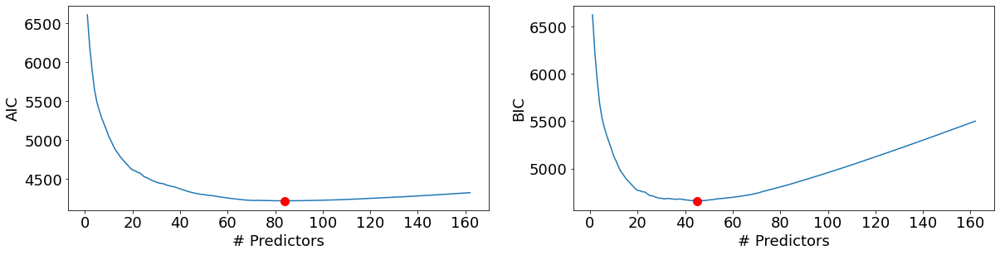

In [27]:
best_sub_plots()

In [29]:
best_backward_model = models_best_backward.loc[60,'model']
models_best_backward.loc[60,'model'].summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                           Logit Regression Results                           
==============================================================================
Dep. Variable:                 target   No. Observations:                10000
Model:                          Logit   Df Residuals:                     9939
Method:                           MLE   Df Model:                           60
Date:                Mon, 22 May 2023   Pseudo R-squ.:                  0.6360
Time:                        17:32:30   Log-Likelihood:                -2067.5
converged:                       True   LL-Null:                       -5680.8
Covariance Type:            nonrobust   LLR p-value:                     0.000
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      4.7554      0.523      9.085      0.000       3.729       5.781
P_2           -4.3138      0.314    -13.744      0.000      -4.929      -3.699
D_39           0.4956      0.190      2.614      0.009       0.124       0.867
B_1            1.9862      0.272      7.301      0.000       1.453       2.519
D_41           3.0935      0.311      9.937      0.000       2.483       3.704
B_3            1.7074      0.281      6.075      0.000       1.157       2.258
D_43           1.7889      0.277      6.456      0.000       1.246       2.332
D_44           1.0762      0.260      4.147      0.000       0.568       1.585
B_4            1.1652      0.314      3.705      0.000       0.549       1.782
D_45          -1.5796      0.288     -5.487      0.000      -2.144      -1.015
B_5           -1.0824      0.415     -2.607      0.009      -1.896      -0.269
D_46           0.8815      0.306      2.882      0.004       0.282       1.481
D_48           1.0031      0.185      5.423      0.000       0.641       1.366
B_6           -1.3120      0.463     -2.834      0.005      -2.219      -0.405
D_50          -4.6465      0.568     -8.182      0.000      -5.760      -3.533
R_3            2.1157      0.277      7.649      0.000       1.574       2.658
D_52          -0.9364      0.347     -2.696      0.007      -1.617      -0.256
D_53           3.4071      0.673      5.061      0.000       2.088       4.727
S_6            0.5669      0.116      4.875      0.000       0.339       0.795
D_56          -1.9735      0.384     -5.139      0.000      -2.726      -1.221
S_9            0.6789      0.222      3.062      0.002       0.244       1.113
D_59          -1.5214      0.213     -7.146      0.000      -1.939      -1.104
D_60           0.4607      0.174      2.646      0.008       0.120       0.802
B_15           1.2364      0.243      5.079      0.000       0.759       1.713
S_11          -1.4041      0.270     -5.192      0.000      -1.934      -0.874
B_18          -1.0013      0.263     -3.804      0.000      -1.517      -0.485
B_19          -0.9168      0.206     -4.455      0.000      -1.320      -0.513
B_20          -0.9886      0.184     -5.366      0.000      -1.350      -0.627
B_21           1.6357      0.437      3.746      0.000       0.780       2.492
D_69          -0.1652      0.073     -2.274      0.023      -0.308      -0.023
D_72          -1.0004      0.242     -4.138      0.000      -1.474      -0.527
D_77          -3.1869      0.382     -8.345      0.000      -3.935      -2.438
D_79           0.6944      0.219      3.165      0.002       0.264       1.124
S_16          -2.6457      0.826     -3.205      0.001      -4.264      -1.028
D_80           0.8018      0.197      4.064      0.000       0.415       1.188
D_82           1.6823      0.199      8.443      0.000       1.292       2.073
R_12          -3.4163      0.347     -9.842      0.000      -4.097      -2.736
B_28          -1.7423      0.470     -3.705      0.000      -2.664      -0.821
R_

Classification accuracy = 89.3%
Precision = 73.3%
TPR or Recall = 91.1%
FNR = 8.9%
FPR = 11.3%
ROC-AUC = 96.4%


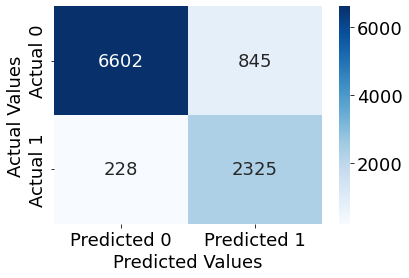

In [67]:
confusion_matrix_data(X_train, y_train, best_backward_model, cutoff = 0.25)

Classification accuracy = 85.0%
Precision = 69.5%
TPR or Recall = 84.0%
FNR = 16.0%
FPR = 14.6%
ROC-AUC = 91.3%


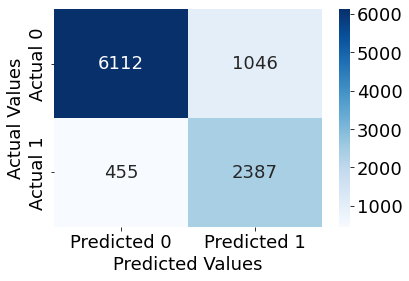

In [70]:
confusion_matrix_data(X_test, y_test, best_backward_model, cutoff = 0.25)

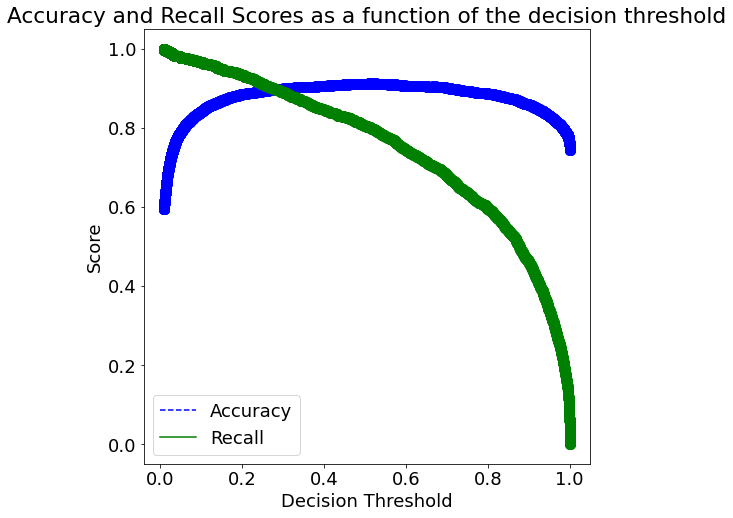

In [32]:
p, r, thresholds = precision_recall_curve(y_train, best_backward_model.predict(X))

accuracy_scores = []

for thresh in thresholds:
    y_pred =  best_backward_model.predict(X) > thresh
    y_pred = y_pred.astype(int)
    
    accuracy = accuracy_score(y_pred, y_train)
    accuracy_scores.append(accuracy)

def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    plt.figure(figsize=(8, 8))
    plt.title("Accuracy and Recall Scores as a function of the decision threshold")
    plt.plot(thresholds, accuracy_scores, "b--", label="Accuracy")
    plt.plot(thresholds, recalls[:-1], "g-", label="Recall")
    plt.plot(thresholds, accuracy_scores, "o", color = 'blue')
    plt.plot(thresholds, recalls[:-1], "o", color = 'green')
    plt.ylabel("Score")
    plt.xlabel("Decision Threshold")
    plt.legend(loc='best')
    plt.legend()
plot_precision_recall_vs_threshold(p, r, thresholds)

**Optimal Threshold**: 0.25